In [1]:
# Librerías
import numpy as np
import deepxde as dde
import deepxde.backend.tensorflow as tf
import matplotlib.pyplot as plt
import matplotlib.animation as animation
from scipy.interpolate import griddata
from scipy.interpolate import RegularGridInterpolator
from matplotlib.lines import Line2D
from IPython.display import HTML
from memory_profiler import memory_usage
import psutil

Using backend: tensorflow.compat.v1
Other supported backends: tensorflow, pytorch, jax, paddle.
paddle supports more examples now and is recommended.


Instructions for updating:
non-resource variables are not supported in the long term


# Segundo problema
El problema que se prentende modelizar es el siguiente:

$\frac{\partial u}{\partial t} = 1.58\frac{\partial^2 u}{\partial x^2} + 0.8u, \quad x \in (0, 5), \ t > 0$

sujeto a las condiciones de frontera de tipo Dirichlet y Neumann:

$u(0,t) = 373.15, \quad \frac{\partial u}{\partial x}(5,t) = 0, \quad t > 0$

y a la condición inicial:

$u(x,0) = 13.5594 + 91.7340\sin\left(\frac{\pi x}{5} + \frac{\pi}{2}\right) + 44.9203\sin\left(\frac{2\pi x}{5} + \frac{\pi}{2}\right) - 41.7340\sin\left(\frac{3\pi x}{5} + \frac{\pi}{2}\right) - 163.9344\sin\left(\frac{3\pi x}{5}\right) - 8.4797\sin\left(\frac{4\pi x}{5} + \frac{\pi}{2}\right) - 122.9508\sin\left(\frac{4\pi x}{5}\right) + 273.15$


In [ ]:
# Parámetros del problema.
L = 5           # Longitud de la barra.
Lscalado = 1.0  # Longitud escalada.
n_terms = 50    # Número de términos en la serie de Fourier.
D = 1.58        # Coeficiente de difusión térmica.
K = 0.8         # Coeficiente reactivo.
T_max = 1.0     # Tiempo máximo.
Kelvin = 273.15 # Conversión de Celsius a Kelvin.
F = 1

In [3]:
# LaTeX.
plt.rcParams.update({
    "text.usetex": True,
    "font.family": "serif",
    "font.size": 14,
    "axes.labelsize": 14,
    "axes.titlesize": 14,
    "xtick.labelsize": 13,
    "ytick.labelsize": 13,
    "legend.fontsize": 14,
    "axes.linewidth": 1.2,
    "xtick.direction": "out",
    "ytick.direction": "out",
    "xtick.major.size": 6,
    "ytick.major.size": 6,
})

In [ ]:
# Condición incial.
def IC(x):
    a0 = 13.5594
    a1 = 91.7340
    a2 = 44.9203
    a3 = -41.7340
    b3 = -163.9344
    a4 = -8.4797
    b4 = -122.9508
    
    return (a0 + 
            a1 * np.sin(np.pi * x / 5 + np.pi/2) + 
            a2 * np.sin(2 * np.pi * x / 5 + np.pi/2) + 
            a3 * np.sin(3 * np.pi * x / 5 + np.pi/2) + 
            b3 * np.sin(3 * np.pi * x / 5) + 
            a4 * np.sin(4 * np.pi * x / 5 + np.pi/2) + 
            b4 * np.sin(4 * np.pi * x / 5)-
            100)


# Cálculo de los coeficientes de Fourier Cn.
def compute_coefficients(n_terms):
    C = np.zeros(n_terms)
    for n in range(0,n_terms):
        k_n = (2*n+1) * np.pi / (2*L)
        integrand = lambda x: (IC(x)) * np.sin(k_n * x)
        C[n] = (2 / L) * np.trapz(integrand(np.linspace(0, L, 100000)), np.linspace(0, L, 100000))
    return C

C_n = compute_coefficients(n_terms)

# Función para evaluar la solución en x y t.
def u_xt(M):
    solution = 100  # Término constante.
    for n in range(0,n_terms):
        k_n = (2*n+1) * np.pi / (L*2)
        solution += C_n[n] * np.sin(k_n * M[:,0]) * np.exp((-D*(k_n**2)+K) * M[:,1])
    return solution.reshape(-1, 1)  # Vector columna.

# Crear una malla combinando la primera columna (x) y la segunda columna (t) de M.
x_vals = np.linspace(0, L, 200)      # Valores de x (espacio).
t_vals = np.linspace(0, T_max, 200)  # Valores de t (tiempo).

# Crear una malla 2D con todas las combinaciones de x y t.
X, T = np.meshgrid(x_vals, t_vals)
# Aplanar las mallas para crear pares (x, t).
M_combined = np.column_stack([X.ravel(), T.ravel()])

# Evaluar la función para cada combinación de (x, t).
U = u_xt(M_combined)+Kelvin

# Volver a dar forma a los resultados para que coincidan con la malla.
U = U.reshape(X.shape)

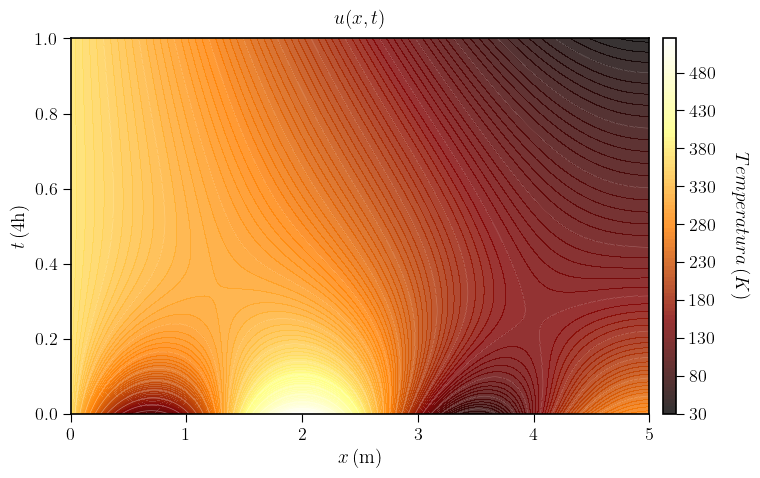

In [139]:
plt.figure(figsize=(8, 5))

contour = plt.contourf(X, T, U, levels=100, cmap='afmhot', alpha=0.8)

# Líneas de contorno.
contour_lines = plt.contour(X, T, U, levels=20, colors='white', linewidths=0.5, alpha=0.4)

cbar = plt.colorbar(contour, pad=0.02, aspect=30)
cbar.ax.tick_params(labelsize=13)
cbar.set_label(r"$Temperatura\, (K)$", rotation=-90, labelpad=25)

plt.title(r"$u(x, t)$", pad=10)
plt.xlabel(r"$x\,(\mathrm{m})$")
plt.ylabel(r"$t\,(\mathrm{4h})$")

plt.tight_layout()
plt.show()

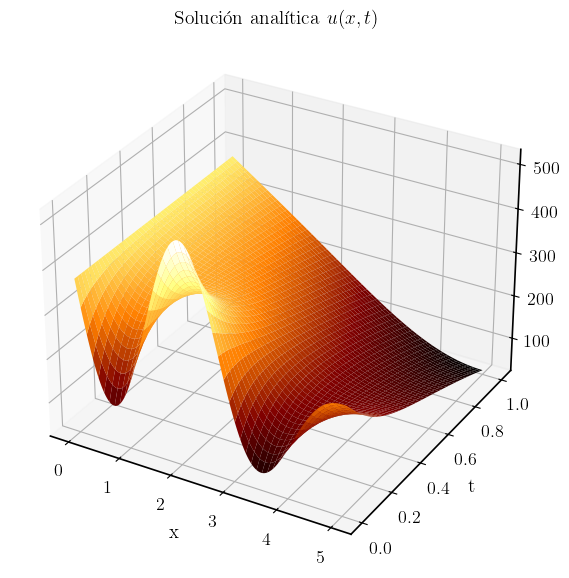

In [ ]:
fig = plt.figure(figsize=(10, 6))
ax = fig.add_subplot(111, projection='3d') 
surf = ax.plot_surface(X, T, U, cmap='afmhot')

ax.set_title("Solución analítica $u(x,t)$")
ax.set_xlabel("x")
ax.set_ylabel("t")

plt.tight_layout()
plt.show()

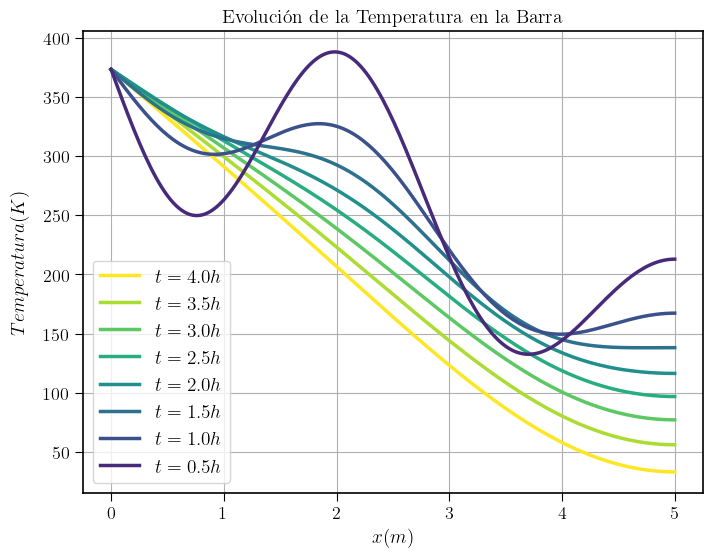

In [ ]:
fig, ax = plt.subplots(figsize=(8, 6))

cmap = plt.cm.viridis
norm = plt.Normalize(vmin=t_vals.min(), vmax=t_vals.max())  

for i in range(len(t_vals)-1, -1, -25):  
    color = cmap(norm(t_vals[i]))  
    t_vals1 = t_vals[i]*4
    ax.plot(x_vals, U[i, :], label=f'$t={t_vals1:.1f}h$', color=color, linewidth=2.5)

ax.set_title('Evolución de la Temperatura en la Barra')
ax.set_xlabel('$x (m)$')
ax.set_ylabel('$Temperatura (K)$', labelpad=10)

ax.legend(loc="best")
ax.grid()

plt.show()

Fenómeno puramente difusivo

In [11]:
K = 0  # Coeficiente reactivo.


In [ ]:
# Condición inicial.
def IC(x):
    a0 = 13.5594
    a1 = 91.7340
    a2 = 44.9203
    a3 = -41.7340
    b3 = -163.9344
    a4 = -8.4797
    b4 = -122.9508
    
    return (a0 + 
            a1 * np.sin(np.pi * x / 5 + np.pi/2) + 
            a2 * np.sin(2 * np.pi * x / 5 + np.pi/2) + 
            a3 * np.sin(3 * np.pi * x / 5 + np.pi/2) + 
            b3 * np.sin(3 * np.pi * x / 5) + 
            a4 * np.sin(4 * np.pi * x / 5 + np.pi/2) + 
            b4 * np.sin(4 * np.pi * x / 5)-
            100)


# Cálculo de los coeficientes de Fourier Cn.
def compute_coefficients(n_terms):
    C = np.zeros(n_terms)
    for n in range(0,n_terms):
        k_n = (2*n+1) * np.pi / (2*L)
        integrand = lambda x: (IC(x)) * np.sin(k_n * x)
        C[n] = (2 / L) * np.trapz(integrand(np.linspace(0, L, 100000)), np.linspace(0, L, 100000))
    return C

C_n = compute_coefficients(n_terms)

# Función para evaluar la solución en x y t.
def u_xt23(M):
    solution = 100  # Término constante.
    for n in range(0,n_terms):
        k_n = (2*n+1) * np.pi / (L*2)
        solution += C_n[n] * np.sin(k_n * M[:,0]) * np.exp((-D*(k_n**2)+K) * M[:,1])
    return solution.reshape(-1, 1)  # Vector columna.

# Crear una malla combinando la primera columna (x) y la segunda columna (t) de M.
x_vals = np.linspace(0, L, 200)      # Valores de x (espacio).
t_vals = np.linspace(0, T_max, 200)  # Valores de t (tiempo).

# Crear una malla 2D con todas las combinaciones de x y t.
X, T = np.meshgrid(x_vals, t_vals)
# Aplanar las mallas para crear pares (x, t).
M_combined = np.column_stack([X.ravel(), T.ravel()])

# Evaluar la función para cada combinación de (x, t).
U1 = u_xt23(M_combined)+Kelvin
# Volver a dar forma a los resultados para que coincidan con la malla.
U1 = U1.reshape(X.shape)

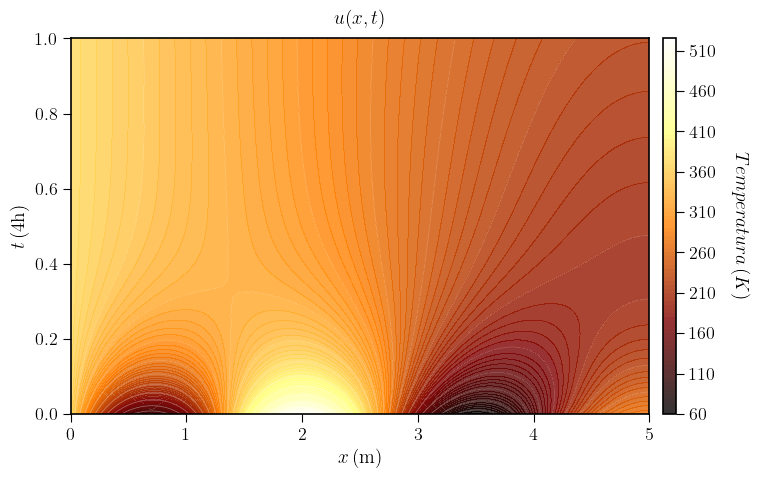

In [13]:
plt.figure(figsize=(8, 5))

contour = plt.contourf(X, T, U1, levels=100, cmap='afmhot', alpha=0.8)

# Líneas de contorno.
contour_lines = plt.contour(X, T, U1, levels=20, colors='white', linewidths=0.5, alpha=0.4)

cbar = plt.colorbar(contour, pad=0.02, aspect=30)
cbar.ax.tick_params(labelsize=13)
cbar.set_label(r"$Temperatura\, (K)$", rotation=-90, labelpad=25)

plt.title(r"$u(x, t)$", pad=10)
plt.xlabel(r"$x\,(\mathrm{m})$")
plt.ylabel(r"$t\,(\mathrm{4h})$")

plt.tight_layout()
plt.show()

# MDF

In [7]:
def MDF(Nx,Nt):

    x = np.linspace(0, L, Nx)
    t = np.linspace(0, T_max, Nt)
    h = x[1] - x[0]        # Paso espacial.
    k = t[1] - t[0]        # Paso temporal.

    # Inicializar la matriz de temperaturas.
    U1 = np.zeros((Nx, Nt))
    U1[:, 0] = IC(x) 

    # Condiciones de frontera (Dirichlet homogéneas: extremos a 0).
    U1[0, :] = 0
    U1[-1, :] = 0 

    # Cálculo del número CFL.
    CFL = D * k / h**2
    print(f"CFL: {CFL:.4f}")

    # Esquema explícito.
    for n in range(0, Nt-1):
        for i in range(1, Nx-1):
            U1[i, n+1] = (k*K + 1)*U1[i, n] + CFL * (U1[i+1, n] - 2*U1[i, n] + U1[i-1, n])
        U1[-1, n+1] = U1[-2, n+1]
    U1 = U1 + Kelvin + 100  # Convertir a Kelvin.
    
    return U1, x, t

#### Tiempo y precisión

In [ ]:
%%time
Nx = 15 # Número de puntos espaciales.
Nt = 40 # Número de puntos temporales.

mem_info = memory_usage((MDF,(),{'Nx':Nx,'Nt':Nt}),interval=0.00000001,retval=True)
mem_consumo = max(mem_info[0]) - min(mem_info[0])  # en MB.
U, x, t = mem_info[1]    

print("Memoria consumida: %1.4f MB" % mem_consumo)

CFL: 0.3176
Memoria consumida: 0.2188 MB
CPU times: user 9.76 ms, sys: 19.9 ms, total: 29.6 ms
Wall time: 220 ms


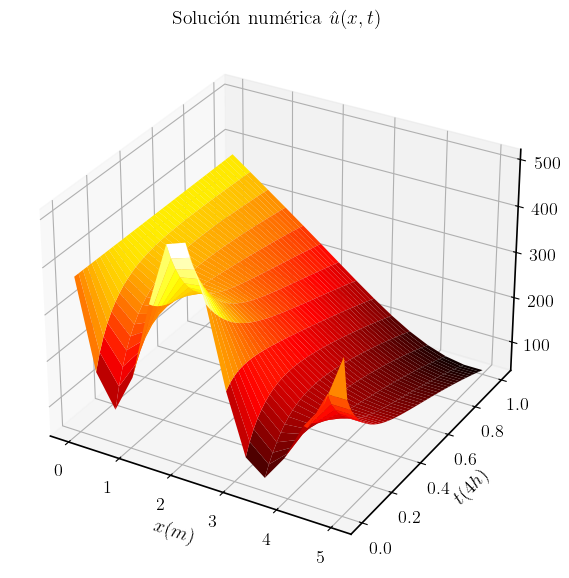

In [ ]:
X1, T1 = np.meshgrid(x, t, indexing='ij')

fig = plt.figure(figsize=(10, 6))
ax = fig.add_subplot(111, projection='3d')  
surf = ax.plot_surface(X1, T1, U, cmap='hot')

ax.set_title(r"Solución numérica $\hat{u}(x,t)$")
ax.set_xlabel(r"$x (m)$")
ax.set_ylabel(r"$t (4h)$")

plt.tight_layout()
plt.show()

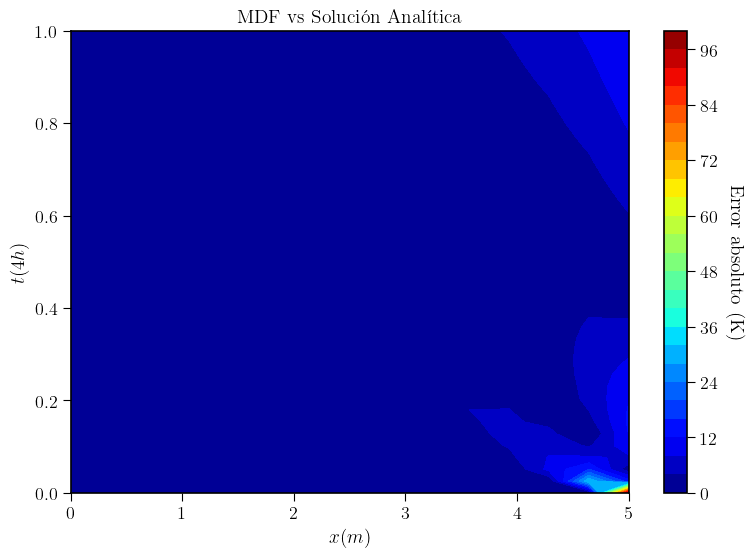

In [ ]:
M_combined1 = np.column_stack([X1.ravel(), T1.ravel()])

# Evaluar la función para cada combinación de (x, t).
U12 = u_xt(M_combined1) + Kelvin
U12 = U12.reshape(X1.shape)

# Volver a dar forma a los resultados para que coincidan con la malla.
error = np.abs(U - U12) 
error = error.reshape(X1.shape)

plt.figure(figsize=(9, 6))
cp = plt.contourf(X1, T1, error, levels=25, cmap="jet")
cbar = plt.colorbar(cp)
cbar.set_label("Error absoluto (K)", rotation=-90, labelpad=20)

plt.xlabel("$x (m)$")
plt.ylabel("$t (4h)$")
plt.title("MDF vs Solución Analítica")
plt.show()

In [ ]:
interpolador = RegularGridInterpolator((x, t), U, bounds_error=False, fill_value=None)

# Generar 10000 puntos (x,t) en el dominio [0, L] x [0, T_max].
x_test = np.random.uniform(0, L, 10000)
t_test = np.random.uniform(0, T_max, 10000)

X_test = np.vstack((x_test, t_test)).T  # Forma (10000, 2).

U_interp = interpolador(X_test)  # Vector de 10000 valores interpolados.

In [ ]:
# Evaluar la función para cada combinación de (x, t).
U12 = u_xt(X_test).flatten() + Kelvin

# Volver a dar forma a los resultados para que coincidan con la malla.
error = np.abs(U_interp - U12) 

In [64]:
x_grid = np.linspace(0, L, 1000)
t_grid = np.linspace(0, T_max, 1000)
X, T = np.meshgrid(x_grid, t_grid)
error_grid = griddata(X_test, error, (X, T), method="cubic", fill_value=True)

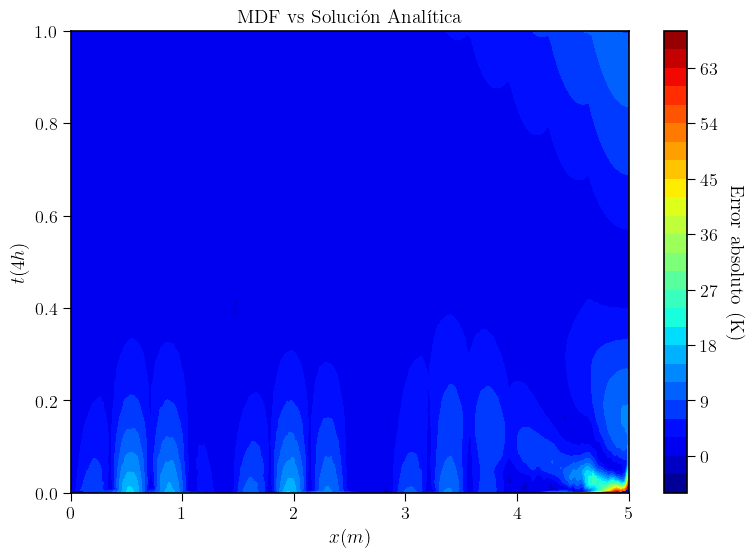

In [65]:
plt.figure(figsize=(9, 6))
cp = plt.contourf(X, T, error_grid, levels=25, cmap="jet")
cbar = plt.colorbar(cp)
cbar.set_label("Error absoluto (K)", rotation=-90, labelpad=20)

plt.xlabel("$x (m)$")
plt.ylabel("$t (4h)$")
plt.title("MDF vs Solución Analítica")
plt.show()

In [ ]:
# MSE (Numerica vs analítica).
mse = np.mean((error)**2)
print(f"Error cuadrático medio (MSE): {mse:.4f}")

Error cuadrático medio (MSE): 15.1828


#### Número de puntos similar a PINN 1.

In [ ]:
%%time
Nx = 20 # Número de puntos espaciales.
Nt = 86 # Número de puntos temporales.

mem_info = memory_usage((MDF,(),{'Nx':Nx,'Nt':Nt}),interval=0.00000001,retval=True)
mem_consumo = max(mem_info[0]) - min(mem_info[0])  # en MB.
U, x, t = mem_info[1]    

print("Memoria consumida: %1.4f MB" % mem_consumo)

CFL: 0.2684
Memoria consumida: 0.2188 MB
CPU times: user 14.7 ms, sys: 26.8 ms, total: 41.5 ms
Wall time: 234 ms


In [ ]:
interpolador = RegularGridInterpolator((x, t), U, bounds_error=False, fill_value=None)

# Generar 10000 puntos (x,t) en el dominio [0, L] x [0, T_max].
x_test = np.random.uniform(0, L, 10000)
t_test = np.random.uniform(0, T_max, 10000)

X_test = np.vstack((x_test, t_test)).T  # Forma (10000, 2).

U_interp = interpolador(X_test)  # Vector de 10000 valores interpolados.

In [ ]:
# Evaluar la función para cada combinación de (x, t).
U12 = u_xt(X_test).flatten() + Kelvin

# Volver a dar forma a los resultados para que coincidan con la malla.
error = np.abs(U_interp - U12) 

In [ ]:
# MSE.
mse = np.mean((error)**2)
print(f"Error cuadrático medio (MSE): {mse:.4f}")

Error cuadrático medio (MSE): 4.7887


#### Número de puntos similar a PINN 2.

In [ ]:
%%time
Nx = 25  # Número de puntos espaciales.
Nt = 152 # Número de puntos temporales.

mem_info = memory_usage((MDF,(),{'Nx':Nx,'Nt':Nt}),interval=0.00000001,retval=True)
mem_consumo = max(mem_info[0]) - min(mem_info[0])  # en MB.
U, x, t = mem_info[1]    

print("Memoria consumida: %1.4f MB" % mem_consumo)

CFL: 0.2411
Memoria consumida: 0.2188 MB
CPU times: user 15.9 ms, sys: 24.2 ms, total: 40.2 ms
Wall time: 235 ms


In [ ]:
interpolador = RegularGridInterpolator((x, t), U, bounds_error=False, fill_value=None)

# Generar 10000 puntos (x,t) en el dominio [0, L] x [0, T_max].
x_test = np.random.uniform(0, L, 10000)
t_test = np.random.uniform(0, T_max, 10000)

X_test = np.vstack((x_test, t_test)).T  # Forma (10000, 2).

U_interp = interpolador(X_test)  # Vector de 10000 valores interpolados.

In [ ]:
# Evaluar la función para cada combinación de (x, t).
U12 = u_xt(X_test).flatten() + Kelvin
# Volver a dar forma a los resultados para que coincidan con la malla.
error = np.abs(U_interp - U12)

In [ ]:
# MSE (Numerica vs analítica).
mse = np.mean((error)**2)
print(f"Error cuadrático medio (MSE): {mse:.4f}")

Error cuadrático medio (MSE): 2.4626


: 

: 

### Funcion error que interpola el mdf según los puntos de test.

In [ ]:
def errorMDF(U, x,t, test):
    interpolador = RegularGridInterpolator((x, t), U, bounds_error=False, fill_value=None)

    U_interp = interpolador(X_test)  # Vector de 10000 valores interpolados.
    
    # Evaluar la función para cada combinación de (x, t).
    U12 = u_xt(X_test).flatten() + Kelvin
    
    # Volver a dar forma a los resultados para que coincidan con la malla.
    error = np.abs(U_interp - U12)
    
    # MSE (Numerica vs analítica).
    mse = np.mean((error)**2)
    return mse

#### Consumo de memoria y precisión

In [ ]:
Nx = 50
errores1 = []
memorias13 = []
NtL = [1000, 2000, 4000, 8000, 16000]

for Nt in NtL:
    
    mem_info = memory_usage((MDF,(),{'Nx':Nx,'Nt':Nt}),interval=0.0001,retval=True)
    mem_consumo = max(mem_info[0]) - min(mem_info[0])  # en MB.
    U, x, t = mem_info[1]    
    memorias13.append(mem_consumo)
    
    X1, T1 = np.meshgrid(x, t, indexing='ij')
    M_combined1 = np.column_stack([X1.ravel(), T1.ravel()])
    u_exacta = u_xt(M_combined1)+Kelvin
    error = np.mean((U - u_exacta.reshape(X1.shape))**2)
    errores1.append(error)

CFL: 0.1519
CFL: 0.0759
CFL: 0.0379
CFL: 0.0190
CFL: 0.0095


In [ ]:
Nx = 50
errores = []
memorias = []
NtL = [1000, 2000, 4000, 8000, 16000]

# Generar 10000 puntos (x,t) en el dominio [0, L] x [0, T_max].
x_test = np.random.uniform(0, L, 10000)
t_test = np.random.uniform(0, T_max, 10000)
X_test = np.vstack((x_test, t_test)).T  # Forma (10000, 2).

for Nt in NtL:
    
    mem_info = memory_usage((MDF,(),{'Nx':Nx,'Nt':Nt}),interval=0.0001,retval=True)
    mem_consumo = max(mem_info[0]) - min(mem_info[0])  # en MB.
    U, x, t = mem_info[1]    
    memorias.append(mem_consumo)
    error = errorMDF(U,x,t,X_test)
    errores.append(error)

CFL: 0.1519
CFL: 0.0759
CFL: 0.0379
CFL: 0.0190
CFL: 0.0095


In [ ]:
# Guardar registro memoria.
np.savetxt('2memoriasMDFNx50.txt', memorias)

In [ ]:
# Cargar registro memoria.
memorias = np.loadtxt('2memoriasMDFNx50.txt')

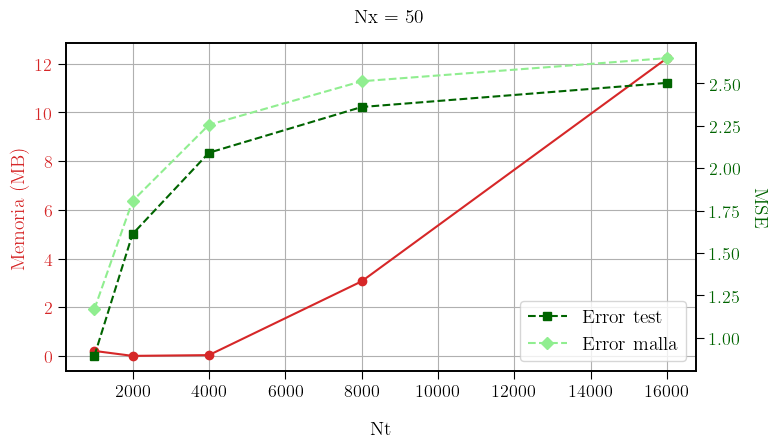

In [ ]:
fig, ax1 = plt.subplots(figsize=(8, 5))
plt.suptitle("Nx = 50", fontsize=14, y=0.9)

# Eje Y izquierdo: Memoria.
color1 = 'tab:red'
ax1.set_xlabel("Nt", labelpad=15)
ax1.set_ylabel("Memoria (MB)", color=color1)
ax1.plot(NtL, memorias, 'o-', color=color1)
ax1.tick_params(axis='y', labelcolor=color1)
ax1.grid(True)

# Eje Y derecho: Error (MSE).
ax2 = ax1.twinx() 
color2 = '#006400'
ax2.set_ylabel("MSE", color=color2, rotation=-90, labelpad=20)
ax2.plot(NtL, errores, 's--', color=color2,label="Error test")
ax2.plot(NtL,errores1, 'D--', color="#90ee90", label="Error malla")
ax2.tick_params(axis='y', labelcolor=color2)

plt.legend(loc='lower right')
fig.tight_layout(rect=[0, 0, 1, 0.95])
plt.show()

#### Manteniendo un CFL de 0.3

In [ ]:
Nx = 0
errores1 = []
memorias13 = []
NtL = [1000, 2000, 4000, 8000, 16000, 32000, 64000, 128000]
NxL = []
cfl = 0.3

for Nt in NtL:
    Nx = int(L * np.sqrt(cfl) / np.sqrt(D * (T_max / (Nt-1)))-1)
    NxL.append(Nx)

for Nt in NtL:
    
    Nx = int(L * np.sqrt(cfl) / np.sqrt(D * (T_max / (Nt-1)))-1)

    mem_info = memory_usage((MDF,(),{'Nx':Nx,'Nt':Nt}),interval=0.0001,retval=True)
    mem_consumo = max(mem_info[0]) - min(mem_info[0])  # en MB.
    U, x, t = mem_info[1]    
    memorias13.append(mem_consumo)
    
    X1, T1 = np.meshgrid(x, t, indexing='ij')
    M_combined1 = np.column_stack([X1.ravel(), T1.ravel()])
    u_exacta = u_xt(M_combined1)+Kelvin
    error = np.mean((U - u_exacta.reshape(X1.shape))**2)
    errores1.append(error)

CFL: 0.2756
CFL: 0.2853
CFL: 0.2880
CFL: 0.2913
CFL: 0.2944
CFL: 0.2958
CFL: 0.2976
CFL: 0.2981


In [ ]:
Nx = 0
errores = []
memorias = []
NtL = [1000, 2000, 4000, 8000, 16000, 32000, 64000, 128000]
NxL = []
cfl = 0.3

x_test = np.random.uniform(0, L, 10000)
t_test = np.random.uniform(0, T_max, 10000)
X_test = np.vstack((x_test, t_test)).T  # Forma (10000, 2).

for Nt in NtL:
    Nx = int(L * np.sqrt(cfl) / np.sqrt(D * (T_max / (Nt-1)))-1)
    NxL.append(Nx)

puntos = (np.array(NxL) * np.array(NtL)).tolist()

for Nt in NtL:
    
    Nx = int(L * np.sqrt(cfl) / np.sqrt(D * (T_max / (Nt-1)))-1)
    
    mem_info = memory_usage((MDF,(),{'Nx':Nx,'Nt':Nt}),interval=0.01,retval=True)
    mem_consumo = max(mem_info[0]) - min(mem_info[0])  # en MB.
    U, x, t = mem_info[1]    
    memorias.append(mem_consumo)
    
    error = errorMDF(U,x,t,X_test)
    errores.append(error)

CFL: 0.2756
CFL: 0.2853
CFL: 0.2880
CFL: 0.2913
CFL: 0.2944
CFL: 0.2958
CFL: 0.2976
CFL: 0.2981


In [ ]:
# Guardar registro memoria.
np.savetxt('2memoriasMDFCFL3.txt', memorias)

In [ ]:
# Cargar registro memoria.
memorias = np.loadtxt('2memoriasMDFCFL3.txt')

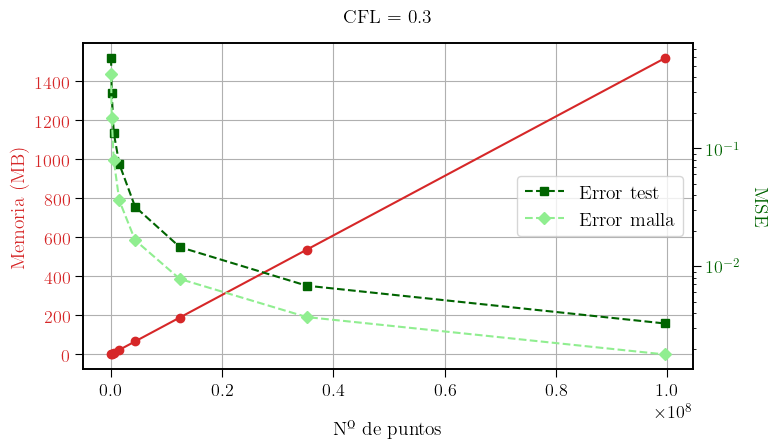

In [ ]:

fig, ax1 = plt.subplots(figsize=(8, 5))
plt.suptitle("CFL = 0.3", fontsize=14, y=0.9)

# Eje Y izquierdo: Memoria.
color1 = 'tab:red'
ax1.set_xlabel("Nº de puntos", labelpad=15)
ax1.set_ylabel("Memoria (MB)", color=color1)
ax1.plot(puntos, memorias, 'o-', color=color1)
ax1.tick_params(axis='y', labelcolor=color1)
ax1.grid(True)

# Eje Y derecho: Error (MSE).
ax2 = ax1.twinx()  
color2 = '#006400'
ax2.set_ylabel("MSE", color=color2, rotation=-90, labelpad=20)
ax2.plot(puntos, errores, 's--', color=color2, label="Error test")
ax2.plot(puntos,errores1, 'D--', color="#90ee90", label="Error malla")
ax2.set_yscale("log")  
ax2.tick_params(axis='y', labelcolor=color2)
plt.legend(loc='center right')

fig.tight_layout(rect=[0, 0, 1, 0.95])
plt.show()

#### Manteniendo un CFL de 0.2

In [ ]:
Nx = 0
errores1 = []
memorias13 = []
NtL = [1000, 2000, 4000, 8000, 16000, 32000, 64000, 128000]
NxL = []
cfl = 0.2

for Nt in NtL:
    Nx = int(L * np.sqrt(cfl) / np.sqrt(D * (T_max / (Nt-1)))-1)
    NxL.append(Nx)

for Nt in NtL:
    
    Nx = int(L * np.sqrt(cfl) / np.sqrt(D * (T_max / (Nt-1)))-1)

    mem_info = memory_usage((MDF,(),{'Nx':Nx,'Nt':Nt}),interval=0.0001,retval=True)
    mem_consumo = max(mem_info[0]) - min(mem_info[0])  # en MB.
    U, x, t = mem_info[1]    
    memorias13.append(mem_consumo)
    
    X1, T1 = np.meshgrid(x, t, indexing='ij')
    M_combined1 = np.column_stack([X1.ravel(), T1.ravel()])
    u_exacta = u_xt(M_combined1)+Kelvin
    error = np.mean((U - u_exacta.reshape(X1.shape))**2)
    errores1.append(error)

CFL: 0.1845
CFL: 0.1875
CFL: 0.1912
CFL: 0.1948
CFL: 0.1964
CFL: 0.1972
CFL: 0.1982
CFL: 0.1985


In [ ]:
Nx = 0
errores = []
memorias = []
NtL = [1000, 2000, 4000, 8000, 16000, 32000, 64000, 128000]
NxL = []
cfl = 0.2

x_test = np.random.uniform(0, L, 10000)
t_test = np.random.uniform(0, T_max, 10000)
X_test = np.vstack((x_test, t_test)).T  # Forma (10000, 2).

for Nt in NtL:
    Nx = int(L * np.sqrt(cfl) / np.sqrt(D * (T_max / (Nt-1)))-1)
    NxL.append(Nx)

puntos = (np.array(NxL) * np.array(NtL)).tolist()

for Nt in NtL:
    
    Nx = int(L * np.sqrt(cfl) / np.sqrt(D * (T_max / (Nt-1)))-1)
    
    mem_info = memory_usage((MDF,(),{'Nx':Nx,'Nt':Nt}),interval=0.1,retval=True)
    mem_consumo = max(mem_info[0]) - min(mem_info[0])  # en MB.
    U, x, t = mem_info[1]    
    memorias.append(mem_consumo)
    
    error = errorMDF(U,x,t,X_test)
    errores.append(error)

CFL: 0.1845
CFL: 0.1845
CFL: 0.1875
CFL: 0.1875
CFL: 0.1912
CFL: 0.1948
CFL: 0.1964
CFL: 0.1972
CFL: 0.1982
CFL: 0.1985


In [ ]:
# Guardar registro memoria.
np.savetxt('2memoriasMDFCFL2.txt', memorias)

In [ ]:
# Cargar registro memoria.
memorias = np.loadtxt('2memoriasMDFCFL2.txt')

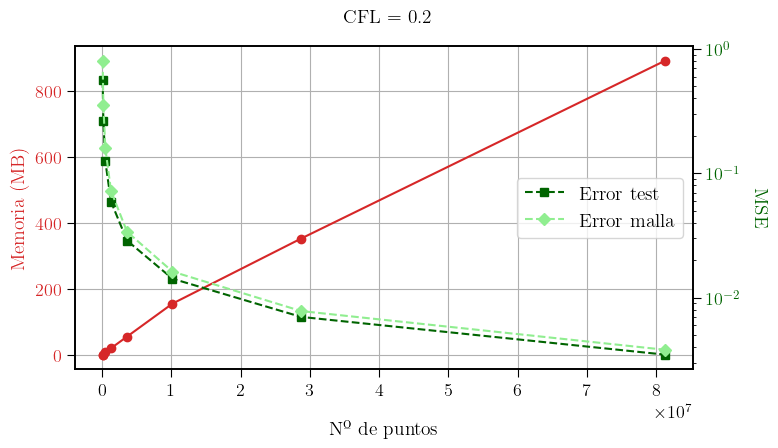

: 

In [ ]:

fig, ax1 = plt.subplots(figsize=(8, 5))
plt.suptitle("CFL = 0.2", fontsize=14, y=0.9)

# Eje Y izquierdo: Memoria.
color1 = 'tab:red'
ax1.set_xlabel("Nº de puntos", labelpad=15)
ax1.set_ylabel("Memoria (MB)", color=color1)
ax1.plot(puntos, memorias, 'o-', color=color1)
ax1.tick_params(axis='y', labelcolor=color1)
ax1.grid(True)

# Eje Y derecho: Error (MSE).
ax2 = ax1.twinx()  
color2 = '#006400'
ax2.set_ylabel("MSE", color=color2, rotation=-90, labelpad=20)
ax2.plot(puntos, errores, 's--', color=color2, label="Error test")
ax2.plot(puntos,errores1, 'D--', color="#90ee90", label="Error malla")
ax2.set_yscale("log") 
ax2.tick_params(axis='y', labelcolor=color2)
plt.legend(loc='center right')

fig.tight_layout(rect=[0, 0, 1, 0.95])
plt.show()

# PINNs

In [ ]:
# Funciones a llamar durante el entrenamiento de las PINNs.

def ICreescaladox(x):
    x1 = x[:, 0:1] * L  # Reescalar x a la longitud de la barra.
    a0 = 13.5594
    a1 = 91.7340
    a2 = 44.9203
    a3 = -41.7340
    b3 = -163.9344
    a4 = -8.4797
    b4 = -122.9508
    result = (a0 + 
            a1 * np.sin(np.pi * x1 / 5 + np.pi/2) + 
            a2 * np.sin(2 * np.pi * x1 / 5 + np.pi/2) + 
            a3 * np.sin(3 * np.pi * x1 / 5 + np.pi/2) + 
            b3 * np.sin(3 * np.pi * x1 / 5) + 
            a4 * np.sin(4 * np.pi * x1 / 5 + np.pi/2) + 
            b4 * np.sin(4 * np.pi * x1 / 5))
    return (result.reshape(-1,1)) / F  # Pico de 300 ºC en x=2.

def EDPreescaladox(x, u):
    du_t = dde.grad.jacobian(u, x, i=0, j=1)
    du_xx = dde.grad.hessian(u, x, i=0, j=0)
    return du_t - (D/(L**2))*du_xx - K*u  # Reescalar x a la longitud de la barra.

def u_xt1reescaladox(x):
    y = np.copy(x)      # Reescalar x a la longitud de la barra.
    y[:,0:1] = y[:,0:1]*L
    return u_xt(y) / F  # Escalar la solución.

# EDP: u_t = u_xx + u.
def EDPsinreescalarx(x, u):
    du_t = dde.grad.jacobian(u, x, i=0, j=1)
    du_xx = dde.grad.hessian(u, x, i=0, j=0)
    return du_t - (D)*du_xx - K*u

def u_xt1(x):
    return u_xt(x) / F  # Escalar la solución.

def IC(x):
    a0 = 13.5594
    a1 = 91.7340
    a2 = 44.9203
    a3 = -41.7340
    b3 = -163.9344
    a4 = -8.4797
    b4 = -122.9508
    x1 = x[:,0:1]
    result = (a0 + 
            a1 * np.sin(np.pi * x1 / 5 + np.pi/2) + 
            a2 * np.sin(2 * np.pi * x1 / 5 + np.pi/2) + 
            a3 * np.sin(3 * np.pi * x1 / 5 + np.pi/2) + 
            b3 * np.sin(3 * np.pi * x1 / 5) + 
            a4 * np.sin(4 * np.pi * x1 / 5 + np.pi/2) + 
            b4 * np.sin(4 * np.pi * x1 / 5))
    return result.reshape(-1,1)

# vanilla-PINN

### Modelo menos complejo (PINN 1)

Optimizador: Adam

Función de activación: tanh

Collocation points: 1500

Boundary points: 100

Initial points: 120

Nº de capas profundas: 2

Nº de neuronas: 16

lr = 0.01

Peso de la función error, todos 1.

#### Tiempo de entrenamiento

In [ ]:
F = 1  # Reescalado.

In [ ]:
# Geometría y tiempo.
geom = dde.geometry.Interval(0, L)
timedomain = dde.geometry.TimeDomain(0, T_max)
geomtime1 = dde.geometry.GeometryXTime(geom, timedomain)

In [ ]:
%%time
# Condición inicial u(x, 0) = f(x).
ic = dde.IC(geomtime1, lambda x: IC(x),lambda x, on_initial: on_initial)

bc1 = dde.DirichletBC(geomtime1, lambda x: 100, lambda x, on_boundary:  on_boundary and np.isclose(x[0], 0))
bc2 = dde.NeumannBC(geomtime1, lambda x: 0, lambda x, on_boundary:  on_boundary and np.isclose(x[0], L))

data = dde.data.TimePDE(
    geomtime1,
    EDPsinreescalarx,
    [bc1, bc2, ic],
    num_domain=1500,
    num_boundary=100,
    num_initial=1200,
    solution=u_xt1,
    num_test=10201,
)

# Red neuronal.
layer_size = [2] + [16] * 2 + [1]
activation = "swish"
initializer = "Glorot uniform"
net = dde.nn.FNN(layer_size, activation, initializer)

# Modelo.
model1 = dde.Model(data, net)

# Compilar el modelo.
model1.compile("adam", lr=0.01, metrics=["MSE"])
# Entrenar el modelo.
losshistory133, train_state = model1.train(iterations=7500,display_every=7500)

Compiling model...
Building feed-forward neural network...
'build' took 0.024415 s

'compile' took 0.274415 s

Training model...

Step      Train loss                                  Test loss                                   Test metric   
0         [5.18e-04, 1.00e+04, 7.44e-03, 1.99e+04]    [4.93e-04, 1.00e+04, 7.44e-03, 1.99e+04]    [1.19e+04]    
7500      [9.47e+01, 1.83e+00, 1.12e+01, 1.10e+01]    [1.47e+02, 1.83e+00, 1.12e+01, 1.10e+01]    [2.79e+03]    

Best model at step 7500:
  train loss: 1.19e+02
  test loss: 1.71e+02
  test metric: [2.79e+03]

'train' took 38.613756 s

CPU times: user 35.1 s, sys: 19.4 s, total: 54.5 s
Wall time: 38.9 s


#### Consumo de memoria

In [ ]:
class MemoryCallback(dde.callbacks.Callback):
    def __init__(self):
        super().__init__()  
        self.process = psutil.Process()
        self.memory_per_epoch = []
        self.mem_init = None

        
    def on_train_begin(self):
        # Guardar memoria inicial al comenzar.
        self.mem_init = self.process.memory_info().rss / (1024 * 1024)

    def on_epoch_end(self):
        mem = self.process.memory_info().rss / (1024 * 1024)  # MB.
        self.memory_per_epoch.append(mem)

    def get_memory(self):
        return self.memory_per_epoch

In [ ]:
# Condición inicial u(x, 0) = f(x).
ic = dde.IC(
    geomtime1,
    lambda x: IC(x),
    lambda x, on_initial: on_initial
)

# Condiciones de frontera homogéneas Dirichlet u(0,t) = u(L,t) = 0.
bc1 = dde.DirichletBC(geomtime1, lambda x: 100, lambda x, on_boundary: on_boundary and np.isclose(x[0], 0))
bc2 = dde.NeumannBC(geomtime1, lambda x: 0, lambda x, on_boundary: on_boundary and np.isclose(x[0], L))

data = dde.data.TimePDE(
    geomtime1,
    EDPsinreescalarx,
    [bc1, bc2, ic],
    num_domain=1500,
    num_boundary=100,
    num_initial=120,
    solution=u_xt1,
    num_test=10201,
)

# Red neuronal.
layer_size = [2] + [16] * 2 + [1]
activation = "Tanh"
initializer = "Glorot uniform"
net = dde.nn.FNN(layer_size, activation, initializer)

# Modelo.
model = dde.Model(data, net)

# Compilar el modelo.
model.compile("adam", lr=0.01, metrics=["MSE"])
# Entrenar el modelo.
mem_cb = MemoryCallback()
losshistory133, train_state = model.train(iterations=7500,display_every=1, callbacks=[mem_cb])

Compiling model...
Building feed-forward neural network...
'build' took 0.023916 s

'compile' took 0.236505 s

Training model...

Step      Train loss                                  Test loss                                   Test metric   
0         [9.98e-02, 1.00e+04, 1.75e-04, 2.01e+04]    [9.58e-02, 1.00e+04, 1.75e-04, 2.01e+04]    [1.12e+04]    
1         [3.50e-02, 9.98e+03, 6.25e-05, 2.00e+04]    [3.36e-02, 9.98e+03, 6.25e-05, 2.00e+04]    [1.12e+04]    
2         [1.05e-02, 9.95e+03, 5.31e-04, 2.00e+04]    [9.88e-03, 9.95e+03, 5.31e-04, 2.00e+04]    [1.11e+04]    
3         [1.76e-02, 9.93e+03, 1.46e-03, 2.00e+04]    [1.60e-02, 9.93e+03, 1.46e-03, 2.00e+04]    [1.11e+04]    
4         [5.18e-02, 9.90e+03, 2.84e-03, 2.00e+04]    [4.77e-02, 9.90e+03, 2.84e-03, 2.00e+04]    [1.11e+04]    
5         [1.12e-01, 9.87e+03, 4.74e-03, 2.00e+04]    [1.04e-01, 9.87e+03, 4.74e-03, 2.00e+04]    [1.11e+04]    
6         [1.99e-01, 9.84e+03, 7.36e-03, 2.00e+04]    [1.85e-01, 9.84e+03, 7.36

I0000 00:00:1751059444.004548  375253 mlir_graph_optimization_pass.cc:425] MLIR V1 optimization pass is not enabled


13        [1.94e+00, 9.57e+03, 8.42e-02, 2.00e+04]    [1.84e+00, 9.57e+03, 8.42e-02, 2.00e+04]    [1.09e+04]    
14        [2.43e+00, 9.52e+03, 1.11e-01, 2.00e+04]    [2.31e+00, 9.52e+03, 1.11e-01, 2.00e+04]    [1.09e+04]    
15        [3.02e+00, 9.46e+03, 1.45e-01, 2.00e+04]    [2.88e+00, 9.46e+03, 1.45e-01, 2.00e+04]    [1.09e+04]    
16        [3.71e+00, 9.41e+03, 1.88e-01, 2.00e+04]    [3.54e+00, 9.41e+03, 1.88e-01, 2.00e+04]    [1.09e+04]    
17        [4.50e+00, 9.35e+03, 2.42e-01, 1.99e+04]    [4.32e+00, 9.35e+03, 2.42e-01, 1.99e+04]    [1.09e+04]    
18        [5.43e+00, 9.29e+03, 3.11e-01, 1.99e+04]    [5.22e+00, 9.29e+03, 3.11e-01, 1.99e+04]    [1.09e+04]    
19        [6.51e+00, 9.23e+03, 4.02e-01, 1.99e+04]    [6.27e+00, 9.23e+03, 4.02e-01, 1.99e+04]    [1.09e+04]    
20        [7.75e+00, 9.17e+03, 5.22e-01, 1.99e+04]    [7.49e+00, 9.17e+03, 5.22e-01, 1.99e+04]    [1.09e+04]    
21        [9.20e+00, 9.11e+03, 6.78e-01, 1.99e+04]    [8.90e+00, 9.11e+03, 6.78e-01, 1.99e+04]  

In [12]:
memoria_por_epoca = mem_cb.get_memory()
metrictest = losshistory133.metrics_test
memoria_por_epoca=np.array(memoria_por_epoca)-mem_cb.mem_init

In [ ]:
# Guardar registro memoria.
np.savetxt('2memoriasvanillaPINN1.txt', memoria_por_epoca)

In [ ]:
# Cargar registro memoria.
memorias = np.loadtxt('2memoriasvanillaPINN1.txt')

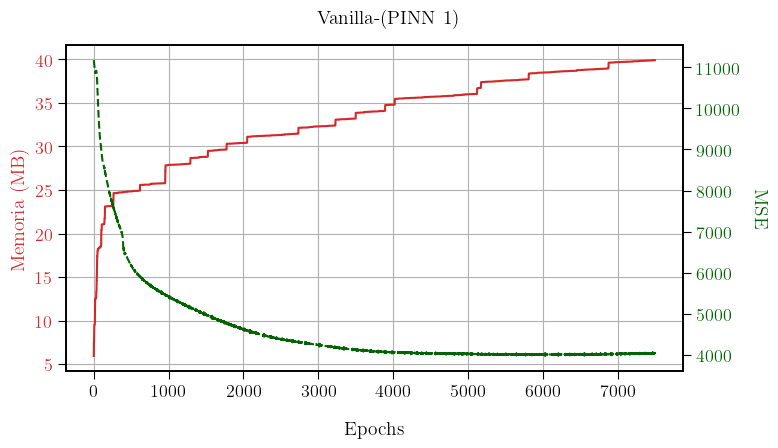

In [ ]:
fig, ax1 = plt.subplots(figsize=(8, 5))
plt.suptitle("Vanilla-(PINN 1)", fontsize=14, y=0.9)

# Eje Y izquierdo: Memoria.
color1 = 'tab:red'
ax1.set_xlabel("Epochs", labelpad=15)
ax1.set_ylabel("Memoria (MB)", color=color1)
ax1.plot(range(len(memorias)), memorias, '-', color=color1)
ax1.tick_params(axis='y', labelcolor=color1)
ax1.grid(True)

# Eje Y derecho: Métrico Test (MSE).
ax2 = ax1.twinx()
color2 = '#006400'  
ax2.set_ylabel("MSE", color=color2, rotation=-90, labelpad=20)
ax2.plot(range(len(metrictest)), metrictest, '--', color=color2)
ax2.tick_params(axis='y', labelcolor=color2)

fig.tight_layout(rect=[0, 0, 1, 0.95])
plt.show()

In [19]:
max(memorias)

39.90625

#### Realización de vídeo y gráficas relevantes.

In [ ]:
# Callback para guardar las predicciones cada 100 iteraciones.
class PredictionLogger(dde.callbacks.Callback):
    def __init__(self, model, X, save_every=100):
        super().__init__()
        self.model = model
        self.X = X 
        self.save_every = save_every
        self.predictions = []
        self.steps = []

    def on_epoch_end(self):
        train_state = self.model.train_state
        step = train_state.step
        if step % self.save_every == 0 or step == 1:
            y_pred = np.array(self.model.predict(self.X))
            self.predictions.append(y_pred)
            self.steps.append(step)

In [ ]:
F = 1  # Reescalado.

In [ ]:
# Geometría y tiempo.
geom = dde.geometry.Interval(0, L)
timedomain = dde.geometry.TimeDomain(0, T_max)
geomtime = dde.geometry.GeometryXTime(geom, timedomain)

In [ ]:
# Condición inicial u(x, 0) = f(x).
ic = dde.IC(
    geomtime,
    lambda x: IC(x),
    lambda x, on_initial: on_initial
)

# Condiciones de frontera homogéneas Dirichlet u(0,t) = u(L,t) = 0.
bc1 = dde.DirichletBC(geomtime, lambda x: 100, lambda x, on_boundary: on_boundary and np.isclose(x[0], 0))
bc2 = dde.NeumannBC(geomtime, lambda x: 0, lambda x, on_boundary: on_boundary and np.isclose(x[0], L))

data = dde.data.TimePDE(
    geomtime,
    EDPsinreescalarx,
    [bc1, bc2, ic],
    num_domain=1500,
    num_boundary=100,
    num_initial=120,
    num_test=10201,
    solution=u_xt1
)

# Red neuronal.
layer_size = [2] + [16] * 2 + [1]
activation = "swish"
initializer = "Glorot uniform"
net = dde.nn.FNN(layer_size, activation, initializer)


Nx, Nt = 200, 200  
# Crear malla de puntos.
x = np.linspace(0, L, Nx)
t = np.linspace(0, T_max, Nt)
X, T = np.meshgrid(x, t, indexing='ij')

# Aplanar para tener pares (x, t) como entradas.
XT = np.vstack([X.ravel(), T.ravel()]).T

# Modelo.
model = dde.Model(data, net)
PredictionLogger = PredictionLogger(model,XT, save_every=100)

# Compilar el modelo.
model.compile("adam", lr=0.01, metrics=["MSE"])
# Entrenar el modelo.
losshistory133, train_state = model.train(iterations=7500,display_every=1, callbacks=[PredictionLogger])

Compiling model...
Building feed-forward neural network...
'build' took 0.029112 s

'compile' took 0.238397 s

Training model...

Step      Train loss                                  Test loss                                   Test metric   
0         [3.13e-01, 1.00e+04, 1.14e-01, 2.01e+04]    [2.99e-01, 1.00e+04, 1.14e-01, 2.01e+04]    [1.12e+04]    
1         [1.91e-01, 9.99e+03, 6.49e-02, 2.01e+04]    [1.82e-01, 9.99e+03, 6.49e-02, 2.01e+04]    [1.12e+04]    
2         [1.07e-01, 9.98e+03, 3.16e-02, 2.01e+04]    [1.01e-01, 9.98e+03, 3.16e-02, 2.01e+04]    [1.11e+04]    
3         [5.05e-02, 9.97e+03, 1.09e-02, 2.00e+04]    [4.78e-02, 9.97e+03, 1.09e-02, 2.00e+04]    [1.11e+04]    
4         [1.68e-02, 9.96e+03, 1.15e-03, 2.00e+04]    [1.57e-02, 9.96e+03, 1.15e-03, 2.00e+04]    [1.11e+04]    
5         [2.39e-03, 9.95e+03, 1.41e-03, 2.00e+04]    [2.11e-03, 9.95e+03, 1.41e-03, 2.00e+04]    [1.11e+04]    
6         [5.79e-03, 9.94e+03, 1.13e-02, 2.00e+04]    [5.67e-03, 9.94e+03, 1.13

In [24]:
Predip = np.array(PredictionLogger.predictions)
Predip = Predip[:,:,0]

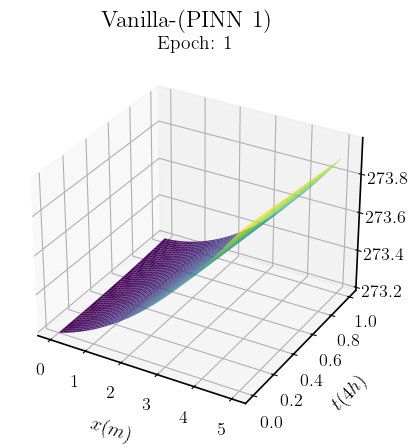

In [ ]:
fig = plt.figure()
ax = fig.add_subplot(111, projection='3d')

def update(i):
    ax.clear()
    Z = Predip[i].reshape(len(x), len(t))*F + Kelvin
    surf = ax.plot_surface(X, T, Z, cmap='viridis')
    ax.set_zlim(np.min(Z), np.max(Z))
    ax.set_title(f"Epoch: {PredictionLogger.steps[i]}")
    plt.suptitle("Vanilla-(PINN 1)")
    ax.set_xlabel("$x(m)$", labelpad=10)
    ax.set_ylabel("$t(4h)$", labelpad=10)
    ax.set_zlabel(r"$\hat{u}(x,t)$", labelpad=10)

    return surf

anim5 = animation.FuncAnimation(fig, update, frames=len(Predip), interval=400)
HTML(anim5.to_html5_video())

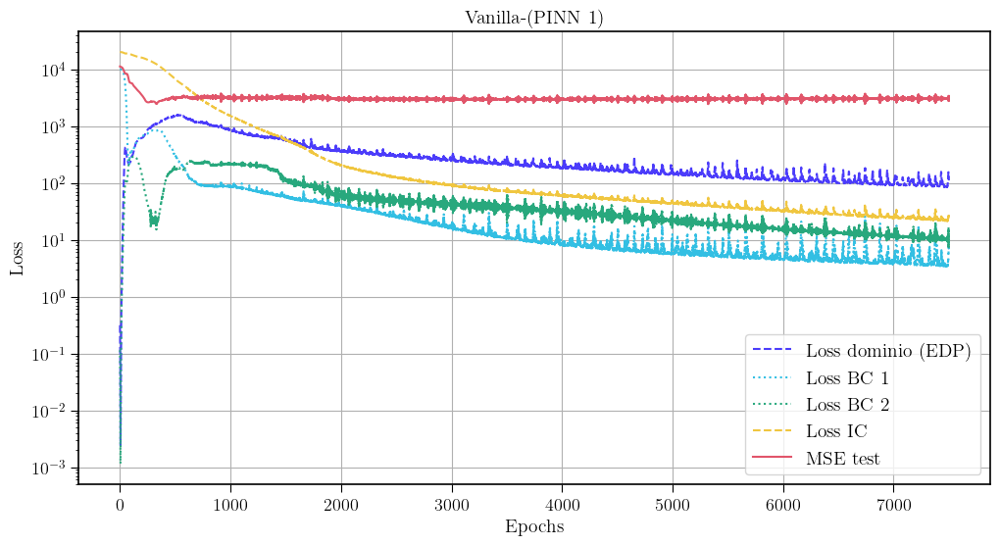

In [ ]:
loss_train = np.array(losshistory133.loss_train)*F**2
testmetric = np.array(losshistory133.metrics_test)*F**2

colors = [
    "#4B3CFA",
    "#33BFE3",
    "#28A87D",  
    "#F0C640",  
    "#E1556A",  
]

plt.figure(figsize=(12, 6))
plt.plot(loss_train[:, 0], label="Loss dominio (EDP)", linestyle='--', color=colors[0])
plt.plot(loss_train[:, 1], label="Loss BC 1", linestyle=':', color = colors[1])
plt.plot(loss_train[:, 2], label="Loss BC 2", linestyle=':', color = colors[2])
plt.plot(loss_train[:, 3], label="Loss IC", linestyle='--', color = colors[3])
plt.plot(testmetric[:, 0], label="MSE test", linestyle='-', color = colors[4])

plt.yscale("log")
plt.xlabel("Epochs")
plt.ylabel("Loss")
plt.title("Vanilla-(PINN 1)")
plt.legend()
plt.grid(True)
plt.show()

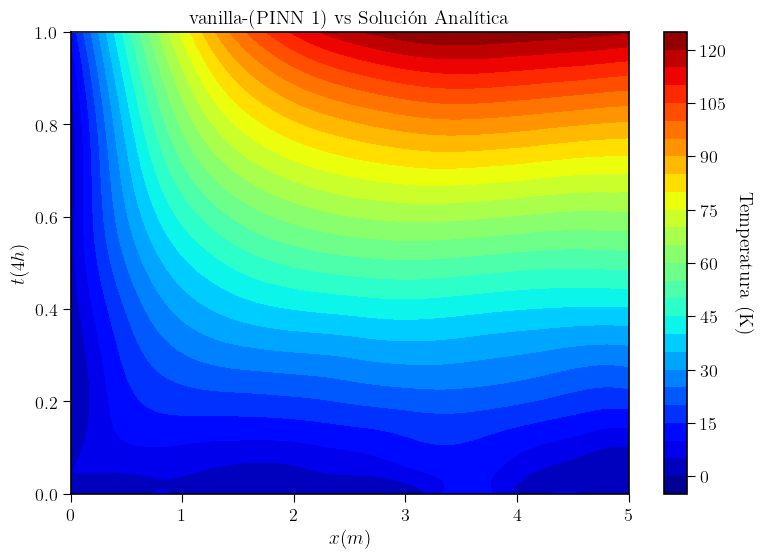

In [ ]:
# Evaluar modelo entrenado.
test_points = geomtime.uniform_points(10201, True)  
y_pred = model.predict(test_points)*F  # Reescalar la predicción.
y_true = u_xt1(test_points)*F          # Reescalar la solución analítica.

# Error absoluto.
y_error = np.abs(y_pred - y_true)

# Graficar el error en el dominio.
x_grid = np.linspace(0, L, 300)
t_grid = np.linspace(0, T_max, 300)
X, T = np.meshgrid(x_grid, t_grid)
error_grid = griddata(test_points, y_error.flatten(), (X, T), method="cubic")

plt.figure(figsize=(9, 6))
cp = plt.contourf(X, T, error_grid, levels=25, cmap="jet")
cbar = plt.colorbar(cp)
cbar.set_label("Temperatura (K)", rotation=-90, labelpad=20)

plt.xlabel("$x (m)$")
plt.ylabel("$t (4h)$")
plt.title("vanilla-(PINN 1) vs Solución Analítica")
plt.show()

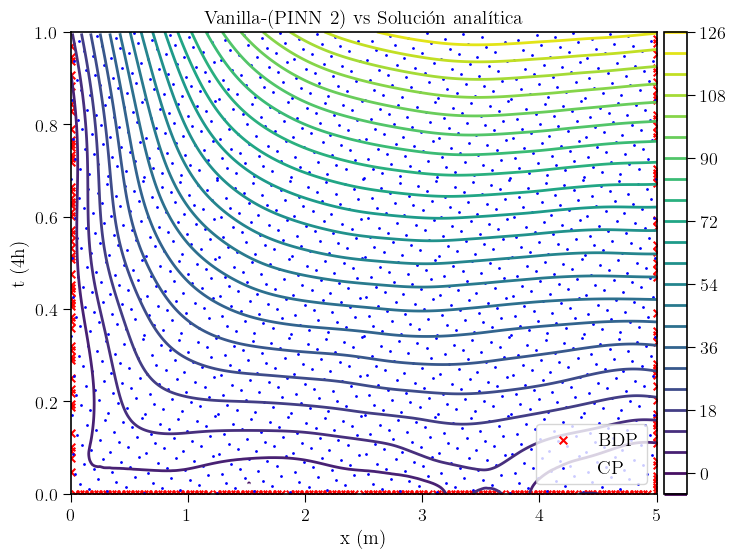

In [ ]:
# Extraer puntos de collocation, boundary e inicial.
collocation_points = data.train_x   # Todos los puntos de entrenamiento.
boundary_points = data.bc_points()  # Puntos de frontera.

all_points_tuples = set(map(tuple, collocation_points))
boundary_points_tuples = set(map(tuple, boundary_points))

# Collocation points = todos los puntos menos los de frontera/inicial.
collocation_points_tuples = all_points_tuples - boundary_points_tuples
collocation_points = np.array(list(collocation_points_tuples))

plt.figure(figsize=(9, 6))

cont = plt.contour(X, T, error_grid, 20, linewidths=2)
plt.colorbar(cont, pad=+0.01)

plt.scatter(boundary_points[:, 0], boundary_points[:, 1], marker="x", c="r", s=30, label="BDP")

plt.scatter(collocation_points[:, 0], collocation_points[:, 1], s=4, marker=".", c="b", label="CP")

plt.xlabel("x (m)")
plt.ylabel("t (4h)")
plt.title("Vanilla-(PINN 2) vs Solución analítica")
plt.legend(loc='lower right')
plt.show()

In [ ]:
# MSE.
mse = np.mean((y_pred - y_true)**2)
print(f"Error cuadrático medio (MSE): {mse:.4f}")

Error cuadrático medio (MSE): 3348.0420


### Modelo más complejo (PINN 2)
Optimizador: Adam

Función de activación: tanh

Collocation points: 2500

Boundary points: 100

Initial points: 1200

Nº de capas profundas: 4

Nº de neuronas: 32

lr = 0.001

Reescalado de la salida: u* = u/100

Reescalado de la entrada espacial: x* = x/L

Peso de la función error IC: 4

Peso de la función de pérdida del dominio: 2

Demás pesos de la función de pérdida: 1

#### Tiempo de entrenamiento

In [32]:
# Escala la función.
F = 100

In [ ]:
# Geometría y tiempo.
geom = dde.geometry.Interval(0, Lscalado)
timedomain = dde.geometry.TimeDomain(0, T_max)
geomtime = dde.geometry.GeometryXTime(geom, timedomain)

In [ ]:
%%time

# Condición inicial u(x, 0) = f(x).
ic = dde.IC(
    geomtime,
    lambda x: ICreescaladox(x),
    lambda x, on_initial: on_initial
)

# Condiciones de frontera homogéneas Dirichlet u(0,t) = u(L,t) = 0.
bc1 = dde.DirichletBC(geomtime, lambda x: 1, lambda x, on_boundary: on_boundary and np.isclose(x[0], 0))
bc2 = dde.NeumannBC(geomtime, lambda x: 0, lambda x, on_boundary: on_boundary and np.isclose(x[0], Lscalado))

data = dde.data.TimePDE(
    geomtime,
    EDPreescaladox,
    [bc1, bc2, ic],
    num_domain=2500,
    num_boundary=100,
    num_initial=1200,
    solution=u_xt1reescaladox,
    num_test=10201,
)

# Red neuronal.
layer_size = [2] + [32] * 4 + [1]
activation = "Tanh"
initializer = "Glorot uniform"
net = dde.nn.FNN(layer_size, activation, initializer)

# Modelo.
model2 = dde.Model(data, net)

# Compilar el modelo.
model2.compile("adam", lr=0.001, metrics=["MSE"], loss_weights=[2, 1, 1, 4])
# Entrenar el modelo.
model2.train(iterations=7500,display_every=7500)
model2.compile("L-BFGS",metrics=["MSE"], loss_weights=[2, 1, 1, 4])
losshistory1, train_state = model2.train()

Compiling model...
Building feed-forward neural network...
'build' took 0.032607 s

'compile' took 0.246468 s

Training model...

Step      Train loss                                  Test loss                                   Test metric   
0         [8.21e-02, 1.26e+00, 1.61e-01, 7.60e+00]    [9.50e-02, 1.26e+00, 1.61e-01, 7.60e+00]    [7.50e-01]    
7500      [7.91e-04, 8.80e-06, 1.97e-04, 6.43e-04]    [6.22e-04, 8.80e-06, 1.97e-04, 6.43e-04]    [2.75e-01]    

Best model at step 7500:
  train loss: 1.64e-03
  test loss: 1.47e-03
  test metric: [2.75e-01]

'train' took 102.720050 s

Compiling model...
'compile' took 0.152012 s

Training model...

Step      Train loss                                  Test loss                                   Test metric   
7500      [7.91e-04, 8.80e-06, 1.97e-04, 6.43e-04]    [6.22e-04, 8.80e-06, 1.97e-04, 6.43e-04]    [2.75e-01]    
INFO:tensorflow:Optimization terminated with:
  Message: CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH
  Objectiv

#### Consumo de memoria

In [ ]:
class MemoryCallback(dde.callbacks.Callback):
    def __init__(self):
        super().__init__() 
        self.process = psutil.Process()
        self.memory_per_epoch = []
        self.mem_init = None

        
    def on_train_begin(self):
        # Guardar memoria inicial al comenzar.
        self.mem_init = self.process.memory_info().rss / (1024 * 1024)

    def on_epoch_end(self):
        mem = self.process.memory_info().rss / (1024 * 1024)  # MB.
        self.memory_per_epoch.append(mem)

    def get_memory(self):
        return self.memory_per_epoch

In [ ]:
# Condición inicial u(x, 0) = f(x).
ic = dde.IC(
    geomtime,
    lambda x: ICreescaladox(x),
    lambda x, on_initial: on_initial
)

# Condiciones de frontera homogéneas Dirichlet u(0,t) = u(L,t) = 0.
bc1 = dde.DirichletBC(geomtime, lambda x: 1, lambda x, on_boundary: on_boundary and np.isclose(x[0], 0))
bc2 = dde.NeumannBC(geomtime, lambda x: 0, lambda x, on_boundary: on_boundary and np.isclose(x[0], Lscalado))

data = dde.data.TimePDE(
    geomtime,
    EDPreescaladox,
    [bc1, bc2, ic],
    num_domain=2500,
    num_boundary=100,
    num_initial=1200,
    solution=u_xt1reescaladox,
    num_test=10201,
)

# Red neuronal.
layer_size = [2] + [32] * 4 + [1]
activation = "Tanh"
initializer = "Glorot uniform"
net = dde.nn.FNN(layer_size, activation, initializer)

# Modelo.
model = dde.Model(data, net)

# Compilar el modelo.
model.compile("adam", lr=0.001, metrics=["MSE"], loss_weights=[2, 1, 1, 4])
# Entrenar el modelo.
mem_cb = MemoryCallback()
model.train(iterations=7500,display_every=1, callbacks=[mem_cb])
model.compile("L-BFGS",metrics=["MSE"], loss_weights=[2, 1, 1, 4])
losshistory1, train_state = model.train()

Compiling model...
Building feed-forward neural network...
'build' took 0.035228 s

'compile' took 0.296221 s

Training model...

Step      Train loss                                  Test loss                                   Test metric   
0         [8.91e-03, 9.92e-01, 1.00e-02, 7.79e+00]    [1.05e-02, 9.92e-01, 1.00e-02, 7.79e+00]    [1.09e+00]    


I0000 00:00:1751060142.494679  381387 mlir_graph_optimization_pass.cc:425] MLIR V1 optimization pass is not enabled


1         [6.38e-02, 8.17e-01, 4.45e-02, 7.70e+00]    [5.69e-02, 8.17e-01, 4.45e-02, 7.70e+00]    [1.08e+00]    
2         [1.55e-01, 6.71e-01, 9.37e-02, 7.64e+00]    [1.29e-01, 6.71e-01, 9.37e-02, 7.64e+00]    [1.09e+00]    
3         [2.20e-01, 5.67e-01, 1.31e-01, 7.62e+00]    [1.75e-01, 5.67e-01, 1.31e-01, 7.62e+00]    [1.11e+00]    
4         [2.16e-01, 5.02e-01, 1.44e-01, 7.64e+00]    [1.68e-01, 5.02e-01, 1.44e-01, 7.64e+00]    [1.14e+00]    
5         [1.68e-01, 4.62e-01, 1.41e-01, 7.69e+00]    [1.28e-01, 4.62e-01, 1.41e-01, 7.69e+00]    [1.17e+00]    
6         [1.14e-01, 4.36e-01, 1.35e-01, 7.74e+00]    [8.57e-02, 4.36e-01, 1.35e-01, 7.74e+00]    [1.19e+00]    
7         [7.39e-02, 4.17e-01, 1.34e-01, 7.79e+00]    [5.64e-02, 4.17e-01, 1.34e-01, 7.79e+00]    [1.20e+00]    
8         [5.37e-02, 4.01e-01, 1.44e-01, 7.82e+00]    [4.31e-02, 4.01e-01, 1.44e-01, 7.82e+00]    [1.18e+00]    
9         [4.88e-02, 3.86e-01, 1.66e-01, 7.81e+00]    [4.16e-02, 3.86e-01, 1.66e-01, 7.81e+00]  

In [12]:
memoria_por_epoca = mem_cb.get_memory()
memoria_por_epoca=np.array(memoria_por_epoca)-mem_cb.mem_init

In [ ]:
# Guardar registro memoria.
np.savetxt('2memoriasVanillaPINN2.txt', memoria_por_epoca)

In [ ]:
# Cargar registro memoria.
memorias = np.loadtxt('2memoriasVanillaPINN2.txt')

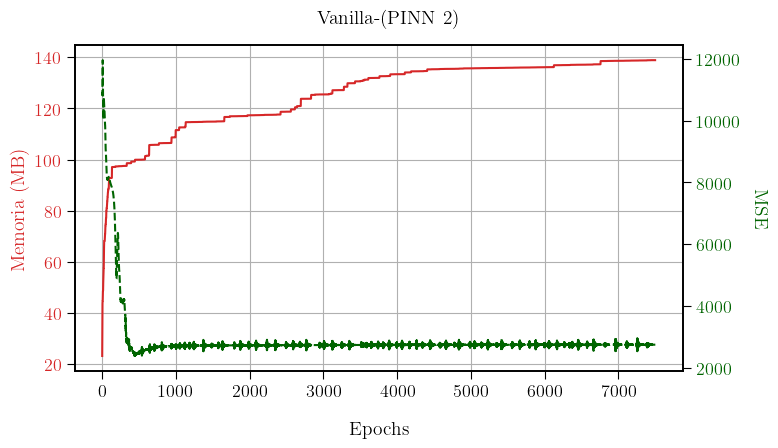

In [ ]:
metrictest = np.array(losshistory1.metrics_test)*F**2

fig, ax1 = plt.subplots(figsize=(8, 5))
plt.suptitle("Vanilla-(PINN 2)", fontsize=14, y=0.9)

# Eje Y izquierdo: Memoria.
color1 = 'tab:red'
ax1.set_xlabel("Epochs", labelpad=15)
ax1.set_ylabel("Memoria (MB)", color=color1)
ax1.plot(range(len(memorias)), memorias, '-', color=color1)
ax1.tick_params(axis='y', labelcolor=color1)
ax1.grid(True)

# Eje Y derecho: Métrico Test (MSE).
ax2 = ax1.twinx()
color2 = '#006400'  
ax2.set_ylabel("MSE", color=color2, rotation=-90, labelpad=20)
ax2.plot(range(len(metrictest)), metrictest, '--', color=color2)
ax2.tick_params(axis='y', labelcolor=color2)

fig.tight_layout(rect=[0, 0, 1, 0.95])
plt.show()

In [17]:
max(memorias)

138.859375

#### Realización de vídeo y gráficas relevantes.

In [ ]:
# Callback para guardar las predicciones cada 100 iteraciones.
class PredictionLogger(dde.callbacks.Callback):
    def __init__(self, model, X, save_every=100):
        super().__init__()
        self.model = model
        self.X = X  
        self.save_every = save_every
        self.predictions = []
        self.steps = []

    def on_epoch_end(self):
        train_state = self.model.train_state
        step = train_state.step
        if step % self.save_every == 0 or step == 1:
            y_pred = np.array(self.model.predict(self.X))
            self.predictions.append(y_pred)
            self.steps.append(step)

In [20]:
# Escala la función.
F = 100

In [ ]:
# Geometría y tiempo.
geom = dde.geometry.Interval(0, Lscalado)
timedomain = dde.geometry.TimeDomain(0, T_max)
geomtime = dde.geometry.GeometryXTime(geom, timedomain)

In [ ]:
# Condición inicial u(x, 0) = f(x).
ic = dde.IC(
    geomtime,
    lambda x: ICreescaladox(x),
    lambda x, on_initial: on_initial
)

# Condiciones de frontera homogéneas Dirichlet u(0,t) = u(L,t) = 0.
bc1 = dde.DirichletBC(geomtime, lambda x: 1, lambda x, on_boundary: on_boundary and np.isclose(x[0], 0))
bc2 = dde.NeumannBC(geomtime, lambda x: 0, lambda x, on_boundary: on_boundary and np.isclose(x[0], Lscalado))

data = dde.data.TimePDE(
    geomtime,
    EDPreescaladox,
    [bc1, bc2, ic],
    num_domain=2500,
    num_boundary=100,
    num_initial=1200,
    solution=u_xt1reescaladox,
    num_test=10201,
)

# Red neuronal.
layer_size = [2] + [32] * 4 + [1]
activation = "Tanh"
initializer = "Glorot uniform"
net = dde.nn.FNN(layer_size, activation, initializer)

Nx, Nt = 200, 200 
# Crear malla de puntos.
x = np.linspace(0, Lscalado, Nx)
t = np.linspace(0, T_max, Nt)
X, T = np.meshgrid(x, t, indexing='ij')

# Aplanar para tener pares (x, t) como entradas.
XT = np.vstack([X.ravel(), T.ravel()]).T

# Modelo.
model = dde.Model(data, net)

# Compilar el modelo.
model.compile("adam", lr=0.001, metrics=["MSE"], loss_weights=[2, 1, 1, 4])
# Entrenar el modelo.
PredictionLogger = PredictionLogger(model,XT, save_every=100)
model.train(iterations=7500,display_every=1, callbacks=[PredictionLogger])
model.compile("L-BFGS",metrics=["MSE"], loss_weights=[2, 1, 1, 4])
losshistory1, train_state = model.train()

Compiling model...
Building feed-forward neural network...
'build' took 0.041353 s

'compile' took 0.629509 s

Training model...

Step      Train loss                                  Test loss                                   Test metric   
0         [9.41e-02, 1.40e+00, 1.10e-01, 7.72e+00]    [9.83e-02, 1.40e+00, 1.10e-01, 7.72e+00]    [7.24e-01]    
1         [5.08e-02, 1.16e+00, 7.03e-02, 7.61e+00]    [5.11e-02, 1.16e+00, 7.03e-02, 7.61e+00]    [7.61e-01]    
2         [2.85e-02, 9.46e-01, 4.33e-02, 7.61e+00]    [2.55e-02, 9.46e-01, 4.33e-02, 7.61e+00]    [8.46e-01]    
3         [2.70e-02, 7.60e-01, 2.79e-02, 7.68e+00]    [1.78e-02, 7.60e-01, 2.79e-02, 7.68e+00]    [9.63e-01]    
4         [4.52e-02, 6.07e-01, 2.17e-02, 7.77e+00]    [2.40e-02, 6.07e-01, 2.17e-02, 7.77e+00]    [1.09e+00]    
5         [8.08e-02, 4.88e-01, 2.21e-02, 7.84e+00]    [4.12e-02, 4.88e-01, 2.21e-02, 7.84e+00]    [1.20e+00]    
6         [1.29e-01, 3.99e-01, 2.83e-02, 7.88e+00]    [6.64e-02, 3.99e-01, 2.83

In [22]:
Predip = np.array(PredictionLogger.predictions)
Predip = Predip[:,:,0]

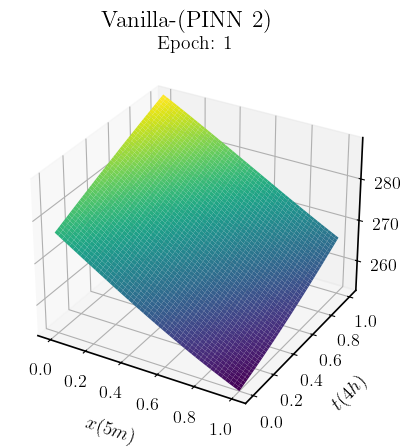

In [ ]:
fig = plt.figure()
ax = fig.add_subplot(111, projection='3d')

def update(i):
    ax.clear()
    Z = Predip[i].reshape(len(x), len(t))*F + Kelvin
    surf = ax.plot_surface(X, T, Z, cmap='viridis')
    ax.set_zlim(np.min(Z), np.max(Z))
    ax.set_title(f"Epoch: {PredictionLogger.steps[i]}")
    plt.suptitle("Vanilla-(PINN 2)")
    ax.set_xlabel("$x(5m)$",labelpad=10)
    ax.set_ylabel("$t(4h)$",labelpad=10)
    ax.set_zlabel(r"$\hat{u}(x,t)$",labelpad=10)
    return surf

anim5 = animation.FuncAnimation(fig, update, frames=len(Predip), interval=400)
HTML(anim5.to_html5_video())

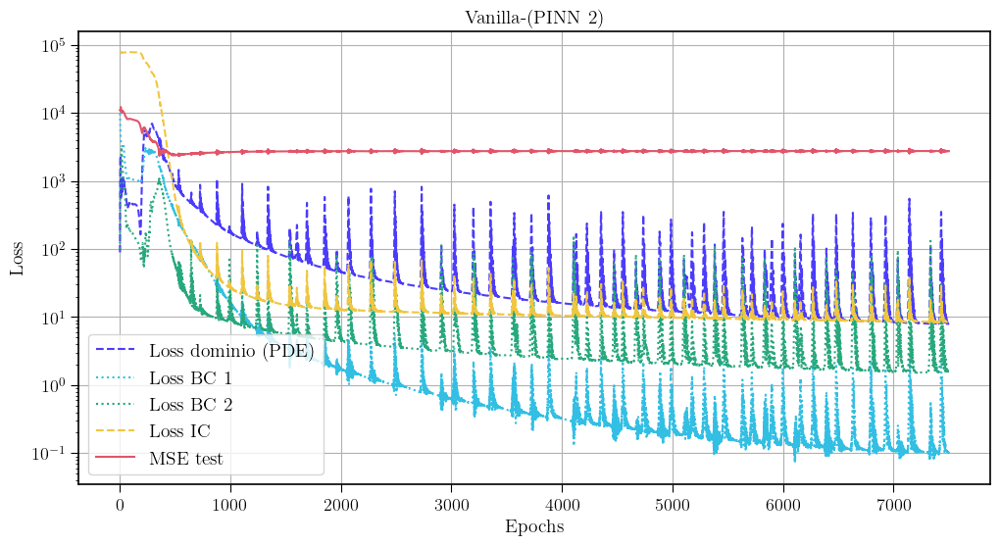

In [ ]:
loss_train = np.array(losshistory1.loss_train)*F**2
testmetric = np.array(losshistory1.metrics_test)*F**2

colors = [
    "#4B3CFA", 
    "#33BFE3", 
    "#28A87D",  
    "#F0C640",  
    "#E1556A",  
]

plt.figure(figsize=(12, 6))
plt.plot(loss_train[:, 0], label="Loss dominio (PDE)", linestyle='--', color=colors[0])
plt.plot(loss_train[:, 1], label="Loss BC 1", linestyle=':', color = colors[1])
plt.plot(loss_train[:, 2], label="Loss BC 2", linestyle=':', color = colors[2])
plt.plot(loss_train[:, 3], label="Loss IC", linestyle='--', color = colors[3])
plt.plot(testmetric[:, 0], label="MSE test", linestyle='-', color = colors[4])

plt.yscale("log")
plt.xlabel("Epochs")
plt.ylabel("Loss")
plt.title("Vanilla-(PINN 2)")
plt.legend()
plt.grid(True)
plt.show()

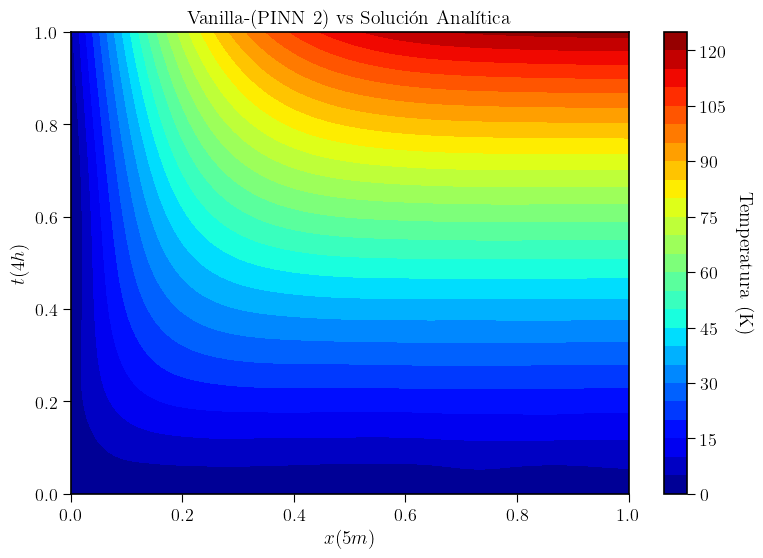

In [ ]:
# Evaluar modelo entrenado.
test_points = geomtime.uniform_points(10201, True)  
y_pred = model.predict(test_points)*F     # Reescalar la predicción.
y_true = u_xt1reescaladox(test_points)*F  # Reescalar la solución analítica.

# Error absoluto.
y_error = np.abs(y_pred - y_true) 

# Graficar el error en el dominio.
x_grid = np.linspace(0, Lscalado, 200)
t_grid = np.linspace(0, T_max, 200)
X, T = np.meshgrid(x_grid, t_grid)
error_grid = griddata(test_points, y_error.flatten(), (X, T), method="cubic")

plt.figure(figsize=(9, 6))
cp = plt.contourf(X, T, error_grid, levels=25, cmap="jet")
cbar = plt.colorbar(cp)
cbar.set_label("Temperatura (K)", rotation=-90, labelpad=20)

plt.xlabel("$x (5m)$")
plt.ylabel("$t (4h)$")
plt.title("Vanilla-(PINN 2) vs Solución Analítica")
plt.show()

In [ ]:
# MSE.
mse = np.mean((y_pred - y_true)**2)
print(f"Error cuadrático medio (MSE): {mse:.4f}")

Error cuadrático medio (MSE): 3026.3958


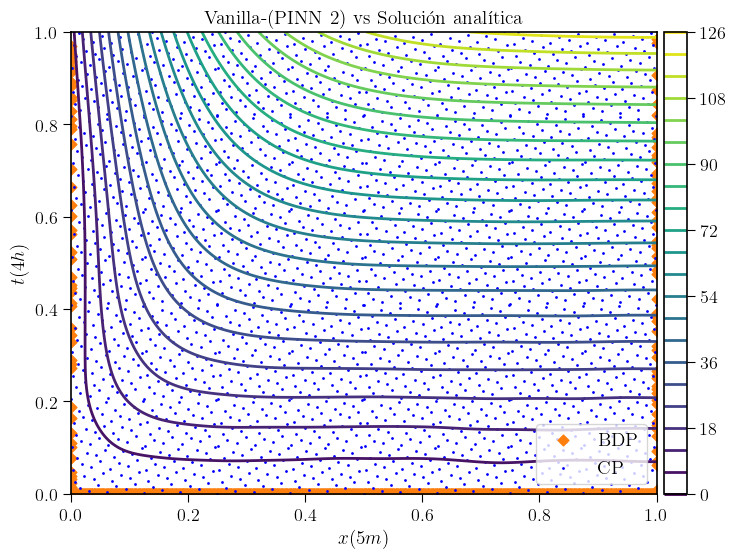

In [ ]:
# Extraer puntos de collocation, boundary e inicial.
collocation_points = data.train_x   # Todos los puntos de entrenamiento.
boundary_points = data.bc_points()  # Puntos de frontera.

all_points_tuples = set(map(tuple, collocation_points))
boundary_points_tuples = set(map(tuple, boundary_points))

# Collocation points = todos los puntos menos los de frontera/inicial.
collocation_points_tuples = all_points_tuples - boundary_points_tuples
collocation_points = np.array(list(collocation_points_tuples))

plt.figure(figsize=(9, 6))

cont = plt.contour(X, T, error_grid, 20, linewidths=2)
plt.colorbar(cont, pad=+0.01)

plt.scatter(boundary_points[:, 0], boundary_points[:, 1], marker="D", c="tab:orange", s=30, label="BDP")

plt.scatter(collocation_points[:, 0], collocation_points[:, 1], s=4, marker=".", c="b", label="CP")

plt.xlabel("$x(5m)$")
plt.ylabel("$t(4h)$")
plt.title("Vanilla-(PINN 2) vs Solución analítica")
plt.legend(loc='lower right')
plt.show()

# g-PINN

In [ ]:
# Definición de la EDP.
def gPINNedp(x, u):
    du_t = dde.grad.jacobian(u, x, j=1)                         # ∂u/∂t
    du_xx = dde.grad.hessian(u, x, i=0, j=0)                    # ∂²u/∂x²
    du_tx = dde.grad.hessian(u, x, i=0, j=1)                    # ∂²u/∂x∂t
    du_xxx = dde.grad.jacobian(du_xx, x, j=0)                   # ∂³u/∂x³
    du_tt = dde.grad.hessian(u, x, i=1, j=1)                    # ∂²u/∂t²
    du_xxt = dde.grad.jacobian(du_xx, x, j=1)                   # ∂³u/∂x²∂t
    du_x = dde.grad.jacobian(u, x, j=0)                         # ∂u/∂x
    
    eq = du_t - D * du_xx - K * u
    eq_x = du_tx - D * du_xxx - K * du_x
    eq_t = du_tt - D * du_xxt - K * du_t
    return [eq, eq_x, eq_t]

In [ ]:
# Definición de la EDP.
def gPINNedpreescaladox(x, u):
    du_t = dde.grad.jacobian(u, x, j=1)                         # ∂u/∂t
    du_xx = dde.grad.hessian(u, x, i=0, j=0)                    # ∂²u/∂x²
    du_tx = dde.grad.hessian(u, x, i=0, j=1)                    # ∂²u/∂x∂t
    du_xxx = dde.grad.jacobian(du_xx, x, j=0)                   # ∂³u/∂x³
    du_tt = dde.grad.hessian(u, x, i=1, j=1)                    # ∂²u/∂t²
    du_xxt = dde.grad.jacobian(du_xx, x, j=1)                   # ∂³u/∂x²∂t
    du_x = dde.grad.jacobian(u, x, j=0)                         # ∂u/∂x

    eq = du_t - (D/(L**2))* du_xx - K * u
    eq_x = (1/L)*du_tx - (D/(L**3))*du_xxx - K *(1/L)* du_x
    eq_t = du_tt - (D/(L**2))*du_xxt - K * du_t
    return [eq, eq_x, eq_t]

### Modelo menos complejo

#### Tiempo de entrenamiento

In [43]:
# Reescalar la solución.
F = 1

In [ ]:
# Geometría y tiempo.
geom = dde.geometry.Interval(0, L)
timedomain = dde.geometry.TimeDomain(0, T_max)
geomtime = dde.geometry.GeometryXTime(geom, timedomain)

In [ ]:
%%time
# Condición inicial u(x, 0) = f(x).
ic = dde.IC(
    geomtime,
    lambda x: IC(x),
    lambda x, on_initial: on_initial
)

# Condiciones de frontera homogéneas Dirichlet u(0,t) = u(L,t) = 0.
bc1 = dde.DirichletBC(geomtime, lambda x: 100, lambda x, on_boundary: on_boundary and np.isclose(x[0], 0))
bc2 = dde.NeumannBC(geomtime, lambda x: 0, lambda x, on_boundary: on_boundary and np.isclose(x[0], L))

data = dde.data.TimePDE(
    geomtime,
    gPINNedp,
    [bc1, bc2, ic],
    num_domain=1500,
    num_boundary=100,
    num_initial=120,
    solution=u_xt1,
    num_test=10201,
)

# Red neuronal.
layer_size = [2] + [16] * 2 + [1]
activation = "Tanh"
initializer = "Glorot uniform"
net = dde.nn.FNN(layer_size, activation, initializer)

# Modelo.
model3 = dde.Model(data, net)
# Compilar el modelo.
model3.compile("adam", lr=0.01, metrics=["MSE"])
# Entrenar el modelo.
losshistory134, train_state = model3.train(iterations=7500,display_every=7500)

Compiling model...
Building feed-forward neural network...
'build' took 0.022572 s

'compile' took 0.346794 s

Training model...

Step      Train loss                                                      Test loss                                                       Test metric   
0         [1.90e-01, 2.17e-02, 3.74e-03, 1.00e+04, 9.55e-03, 2.00e+04]    [1.93e-01, 2.26e-02, 3.68e-03, 1.00e+04, 9.55e-03, 2.00e+04]    [1.10e+04]    
7500      [9.47e+00, 1.04e+02, 2.93e+02, 3.93e+02, 1.91e+01, 1.29e+04]    [7.64e+00, 7.06e+01, 2.16e+02, 3.93e+02, 1.91e+01, 1.29e+04]    [2.92e+03]    

Best model at step 7500:
  train loss: 1.37e+04
  test loss: 1.36e+04
  test metric: [2.92e+03]

'train' took 27.149684 s

CPU times: user 20.9 s, sys: 9.09 s, total: 30 s
Wall time: 27.5 s


#### Consumo de memoria

In [ ]:
class MemoryCallback(dde.callbacks.Callback):
    def __init__(self):
        super().__init__() 
        self.process = psutil.Process()
        self.memory_per_epoch = []
        self.mem_init = None

    def on_train_begin(self):
        # Guardar memoria inicial al comenzar.
        self.mem_init = self.process.memory_info().rss / (1024 * 1024)

    def on_epoch_end(self):
        mem = self.process.memory_info().rss / (1024 * 1024)  # MB.
        self.memory_per_epoch.append(mem)

    def get_memory(self):
        return self.memory_per_epoch

In [ ]:
# Condición inicial u(x, 0) = f(x).
ic = dde.IC(
    geomtime,
    lambda x: IC(x),
    lambda x, on_initial: on_initial
)

# Condiciones de frontera homogéneas Dirichlet u(0,t) = u(L,t) = 0.
bc1 = dde.DirichletBC(geomtime, lambda x: 100, lambda x, on_boundary: on_boundary and np.isclose(x[0], 0))
bc2 = dde.NeumannBC(geomtime, lambda x: 0, lambda x, on_boundary: on_boundary and np.isclose(x[0], L))

data = dde.data.TimePDE(
    geomtime,
    gPINNedp,
    [bc1, bc2, ic],
    num_domain=1500,
    num_boundary=100,
    num_initial=120,
    solution=u_xt1,
    num_test=10201,
)

# Red neuronal.
layer_size = [2] + [16] * 2 + [1]
activation = "Tanh"
initializer = "Glorot uniform"
net = dde.nn.FNN(layer_size, activation, initializer)

# Modelo.
model = dde.Model(data, net)

# Compilar el modelo.
model.compile("adam", lr=0.01, metrics=["MSE"])
mem_cb = MemoryCallback()
# Entrenar el modelo.
losshistory134, train_state = model.train(iterations=7500,display_every=1, callbacks=[mem_cb])

Compiling model...
Building feed-forward neural network...
'build' took 0.026430 s

'compile' took 0.272182 s

Training model...

Step      Train loss                                                      Test loss                                                       Test metric   
0         [1.68e-01, 2.35e-02, 3.11e-01, 1.01e+04, 2.15e-03, 2.00e+04]    [1.42e-01, 2.33e-02, 3.12e-01, 1.01e+04, 2.15e-03, 2.00e+04]    [1.11e+04]    


I0000 00:00:1751060902.863316  388776 mlir_graph_optimization_pass.cc:425] MLIR V1 optimization pass is not enabled


1         [7.52e-02, 2.10e-02, 1.88e-01, 1.00e+04, 7.43e-04, 2.00e+04]    [6.37e-02, 2.07e-02, 1.95e-01, 1.00e+04, 7.43e-04, 2.00e+04]    [1.10e+04]    
2         [6.34e-02, 2.60e-02, 1.02e-01, 9.98e+03, 1.04e-04, 2.00e+04]    [6.08e-02, 2.44e-02, 1.09e-01, 9.98e+03, 1.04e-04, 2.00e+04]    [1.10e+04]    
3         [1.32e-01, 4.08e-02, 5.18e-02, 9.93e+03, 1.16e-04, 2.00e+04]    [1.32e-01, 3.65e-02, 5.64e-02, 9.93e+03, 1.16e-04, 2.00e+04]    [1.10e+04]    
4         [2.84e-01, 6.81e-02, 3.86e-02, 9.88e+03, 7.22e-04, 2.00e+04]    [2.82e-01, 5.98e-02, 3.63e-02, 9.88e+03, 7.22e-04, 2.00e+04]    [1.10e+04]    
5         [5.25e-01, 1.11e-01, 6.36e-02, 9.83e+03, 1.98e-03, 2.00e+04]    [5.16e-01, 9.64e-02, 5.04e-02, 9.83e+03, 1.98e-03, 2.00e+04]    [1.09e+04]    
6         [8.63e-01, 1.72e-01, 1.31e-01, 9.78e+03, 4.03e-03, 2.00e+04]    [8.43e-01, 1.49e-01, 1.01e-01, 9.78e+03, 4.03e-03, 2.00e+04]    [1.09e+04]    
7         [1.31e+00, 2.57e-01, 2.47e-01, 9.73e+03, 6.98e-03, 2.00e+04]    [1.27e+0

In [12]:
memoria_por_epoca = mem_cb.get_memory()
metrictest = losshistory134.metrics_test
memoria_por_epoca=np.array(memoria_por_epoca)-mem_cb.mem_init

In [ ]:
# Guardar registro memoria.
np.savetxt('2memoriasgPINN1.txt', memoria_por_epoca)

In [ ]:
# Cargar registro memoria.
memorias = np.loadtxt('2memoriasgPINN1.txt')

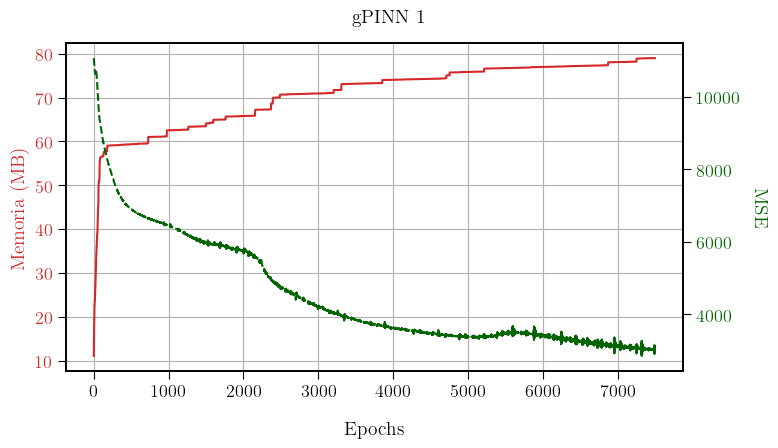

In [ ]:
fig, ax1 = plt.subplots(figsize=(8, 5))
plt.suptitle("gPINN 1", fontsize=14, y=0.9)

# Eje Y izquierdo: Memoria.
color1 = 'tab:red'
ax1.set_xlabel("Epochs", labelpad=15)
ax1.set_ylabel("Memoria (MB)", color=color1)
ax1.plot(range(len(memorias)), memorias, '-', color=color1)
ax1.tick_params(axis='y', labelcolor=color1)
ax1.grid(True)

# Eje Y derecho: Métrico Test (MSE).
ax2 = ax1.twinx()
color2 = '#006400'  
ax2.set_ylabel("MSE", color=color2, rotation=-90, labelpad=20)
ax2.plot(range(len(metrictest)), metrictest, '--', color=color2)
ax2.tick_params(axis='y', labelcolor=color2)

fig.tight_layout(rect=[0, 0, 1, 0.95])
plt.show()

In [17]:
max(memorias)

79.015625


#### Realización de vídeo y gráficas relevantes.

In [ ]:
# Callback para guardar las predicciones cada 100 iteraciones.
class PredictionLogger(dde.callbacks.Callback):
    def __init__(self, model, X, save_every=100):
        super().__init__()
        self.model = model
        self.X = X 
        self.save_every = save_every
        self.predictions = []
        self.steps = []

    def on_epoch_end(self):
        train_state = self.model.train_state
        step = train_state.step
        if step % self.save_every == 0 or step == 1:
            y_pred = np.array(self.model.predict(self.X))
            self.predictions.append(y_pred)
            self.steps.append(step)

In [ ]:
F = 1  # Reescalado.

In [ ]:
# Geometría y tiempo.
geom = dde.geometry.Interval(0, L)
timedomain = dde.geometry.TimeDomain(0, T_max)
geomtime = dde.geometry.GeometryXTime(geom, timedomain)

In [ ]:
# Condición inicial u(x, 0) = f(x).
ic = dde.IC(
    geomtime,
    lambda x: IC(x),
    lambda x, on_initial: on_initial
)

# Condiciones de frontera homogéneas Dirichlet u(0,t) = u(L,t) = 0.
bc1 = dde.DirichletBC(geomtime, lambda x: 100, lambda x, on_boundary: on_boundary and np.isclose(x[0], 0))
bc2 = dde.NeumannBC(geomtime, lambda x: 0, lambda x, on_boundary: on_boundary and np.isclose(x[0], L))

data = dde.data.TimePDE(
    geomtime,
    gPINNedp,
    [bc1, bc2, ic],
    num_domain=1500,
    num_boundary=100,
    num_initial=120,
    solution=u_xt1,
    num_test=10201,
)

# Red neuronal
layer_size = [2] + [16] * 2 + [1]
activation = "Tanh"
initializer = "Glorot uniform"
net = dde.nn.FNN(layer_size, activation, initializer)

Nx, Nt = 101, 101  
# Crear malla de puntos.
x = np.linspace(0, L, Nx)
t = np.linspace(0, T_max, Nt)
X, T = np.meshgrid(x, t, indexing='ij')

# Aplanar para tener pares (x, t) como entradas.
XT = np.vstack([X.ravel(), T.ravel()]).T

# Modelo.
model = dde.Model(data, net)
PredictionLogger = PredictionLogger(model, XT, save_every=100)
# Compilar el modelo.
model.compile("adam", lr=0.01, metrics=["MSE"])
# Entrenar el modelo.
losshistory134, train_state = model.train(iterations=7500,display_every=1, callbacks=[PredictionLogger])

Compiling model...
Building feed-forward neural network...
'build' took 0.020236 s

'compile' took 0.295883 s

Training model...

Step      Train loss                                                      Test loss                                                       Test metric   
0         [1.72e-01, 2.36e-02, 3.15e-01, 1.01e+04, 2.41e-03, 2.00e+04]    [1.42e-01, 2.33e-02, 3.12e-01, 1.01e+04, 2.41e-03, 2.00e+04]    [1.11e+04]    
1         [7.72e-02, 2.12e-02, 1.90e-01, 1.00e+04, 8.42e-04, 2.00e+04]    [6.39e-02, 2.08e-02, 1.95e-01, 1.00e+04, 8.42e-04, 2.00e+04]    [1.10e+04]    
2         [6.53e-02, 2.70e-02, 1.05e-01, 9.98e+03, 1.10e-04, 2.00e+04]    [6.31e-02, 2.50e-02, 1.12e-01, 9.98e+03, 1.10e-04, 2.00e+04]    [1.10e+04]    
3         [1.36e-01, 4.32e-02, 5.56e-02, 9.93e+03, 1.32e-04, 2.00e+04]    [1.39e-01, 3.81e-02, 6.03e-02, 9.93e+03, 1.32e-04, 2.00e+04]    [1.10e+04]    
4         [2.93e-01, 7.27e-02, 4.23e-02, 9.88e+03, 8.46e-04, 2.00e+04]    [2.96e-01, 6.26e-02, 3.98e-02, 

In [22]:
Predip = np.array(PredictionLogger.predictions)
Predip = Predip[:,:,0]

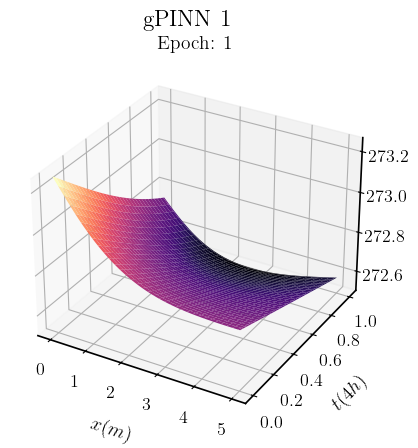

In [ ]:
fig = plt.figure()
ax = fig.add_subplot(111, projection='3d')

def update(i):
    ax.clear()
    Z = Predip[i].reshape(len(x), len(t))*F + Kelvin
    surf = ax.plot_surface(X, T, Z, cmap='magma')
    ax.set_zlim(np.min(Z), np.max(Z))
    ax.set_title(f"Epoch: {PredictionLogger.steps[i]}")
    plt.suptitle("gPINN 1")
    ax.set_xlabel("$x(m)$",labelpad=10)
    ax.set_ylabel("$t(4h)$",labelpad=10)
    ax.set_zlabel(r"$\hat{u}(x,t)$",labelpad=10)
    return surf

anim5 = animation.FuncAnimation(fig, update, frames=len(Predip), interval=400)
HTML(anim5.to_html5_video())

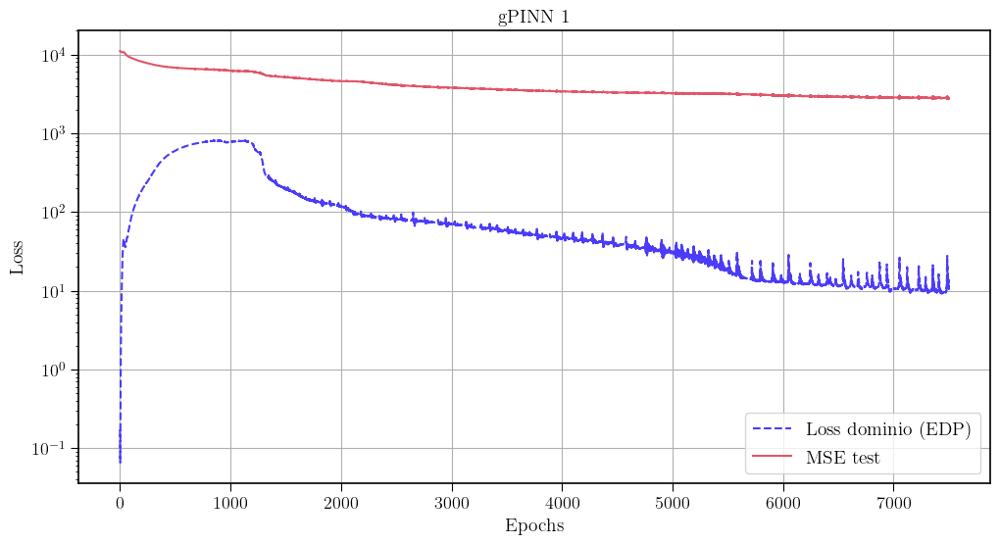

In [ ]:
loss_train = np.array(losshistory134.loss_train)*F**2
testmetric134 = np.array(losshistory134.metrics_test)*F**2

colors = [
    "#4B3CFA",  
    "#33BFE3",  
    "#28A87D",  
    "#F0C640",  
    "#E1556A",  
]

plt.figure(figsize=(12, 6))
plt.plot(loss_train[:, 0], label="Loss dominio (EDP)", linestyle='--', color=colors[0])

plt.plot(testmetric134[:], label="MSE test", linestyle='-', color = colors[4])

plt.yscale("log")
plt.xlabel("Epochs")
plt.ylabel("Loss")
plt.title("gPINN 1")
plt.legend()
plt.grid(True)
plt.show()

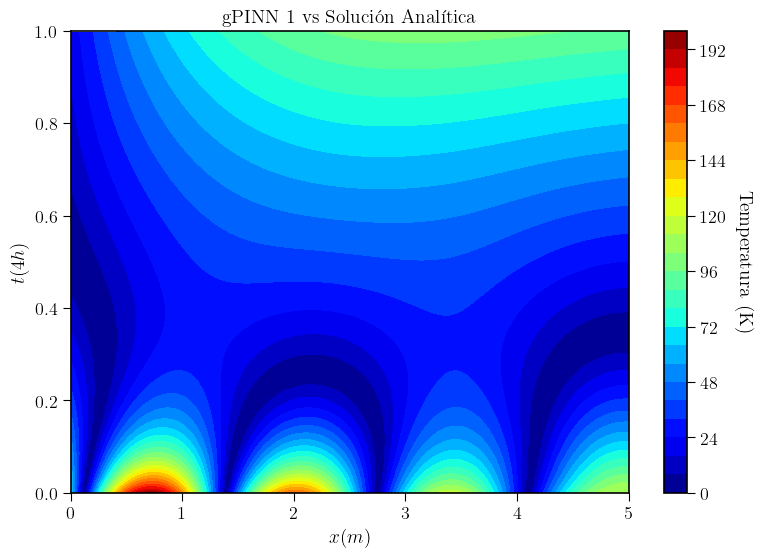

In [ ]:
# Evaluar modelo entrenado.
test_points = geomtime.uniform_points(10201, True)  
y_pred = model.predict(test_points)*F  # Reescalar la predicción.
y_true = u_xt1(test_points)*F          # Reescalar la solución analítica.

# Error absoluto.
y_error = np.abs(y_pred - y_true)  

# Graficar el error en el dominio.
x_grid = np.linspace(0, L, 400)
t_grid = np.linspace(0, T_max, 400)
X, T = np.meshgrid(x_grid, t_grid)
error_grid = griddata(test_points, y_error.flatten(), (X, T), method="cubic")

plt.figure(figsize=(9, 6))
cp = plt.contourf(X, T, error_grid, levels=25, cmap="jet")
cbar = plt.colorbar(cp)
cbar.set_label(r"Temperatura (K)", rotation=-90, labelpad=20)

plt.xlabel("$x (m)$")
plt.ylabel("$t (4h)$")
plt.title("gPINN 1 vs Solución Analítica")
plt.show()

In [ ]:
# MSE.
mse = np.mean((y_pred - y_true)**2)
print(f"Error cuadrático medio (MSE): {mse:.4f}")

Error cuadrático medio (MSE): 2855.1038


### Modelo más complejo

#### Tiempo de entrenamiento

In [46]:
# Reescalar la solución.
F = 100

In [ ]:
# Geometría y tiempo.
geom = dde.geometry.Interval(0, Lscalado)
timedomain = dde.geometry.TimeDomain(0, T_max)
geomtime = dde.geometry.GeometryXTime(geom, timedomain)

In [ ]:
%%time
# Condición inicial u(x, 0) = f(x).
ic = dde.IC(
    geomtime,
    lambda x: ICreescaladox(x),
    lambda x, on_initial: on_initial
)

# Condiciones de frontera homogéneas Dirichlet u(0,t) = u(L,t) = 0.
bc1 = dde.DirichletBC(geomtime, lambda x: 1, lambda x, on_boundary: on_boundary and np.isclose(x[0], 0))
bc2 = dde.NeumannBC(geomtime, lambda x: 0, lambda x, on_boundary: on_boundary and np.isclose(x[0], Lscalado))

data = dde.data.TimePDE(
    geomtime,
    gPINNedpreescaladox,
    [bc1, bc2, ic],
    num_domain=2500,
    num_boundary=100,
    num_initial=1200,
    solution=u_xt1reescaladox,
    num_test=10201,
)

# Red neuronal.
layer_size = [2] + [32] * 4 + [1]
activation = "Tanh"
initializer = "Glorot uniform"
net = dde.nn.FNN(layer_size, activation, initializer)

# Modelo.
model4 = dde.Model(data, net)

# Compilar el modelo.
model4.compile("adam", lr=0.001, metrics=["MSE"], loss_weights=[2, 1, 1,1, 1, 4])
# Entrenar el modelo.
model4.train(iterations=7500,display_every=7500)
model4.compile("L-BFGS",metrics=["MSE"], loss_weights=[2, 1, 1, 1, 1, 4])
losshistory135, train_state = model4.train()

Compiling model...
Building feed-forward neural network...
'build' took 0.025025 s

'compile' took 0.508953 s

Training model...

Step      Train loss                                                      Test loss                                                       Test metric   
0         [8.19e-02, 1.10e-02, 6.58e-02, 1.26e+00, 1.60e-01, 7.60e+00]    [9.50e-02, 1.12e-02, 6.67e-02, 1.26e+00, 1.60e-01, 7.60e+00]    [7.51e-01]    
7500      [3.64e-04, 6.12e-03, 1.30e-02, 1.42e-03, 1.23e-03, 9.42e-03]    [3.55e-04, 3.16e-03, 1.15e-02, 1.42e-03, 1.23e-03, 9.42e-03]    [2.70e-01]    

Best model at step 7500:
  train loss: 3.15e-02
  test loss: 2.71e-02
  test metric: [2.70e-01]

'train' took 280.055728 s

Compiling model...
'compile' took 0.338493 s

Training model...

Step      Train loss                                                      Test loss                                                       Test metric   
7500      [3.64e-04, 6.12e-03, 1.30e-02, 1.42e-03, 1.23e-03, 9.42e-0

#### Consumo de memoria

In [ ]:
class MemoryCallback(dde.callbacks.Callback):
    def __init__(self):
        super().__init__()  
        self.process = psutil.Process()
        self.memory_per_epoch = []
        self.mem_init = None
        
    def on_train_begin(self):
        # Guardar memoria inicial al comenzar.
        self.mem_init = self.process.memory_info().rss / (1024 * 1024)

    def on_epoch_end(self):
        mem = self.process.memory_info().rss / (1024 * 1024)  # MB.
        self.memory_per_epoch.append(mem)

    def get_memory(self):
        return self.memory_per_epoch

In [ ]:
# Condición inicial u(x, 0) = f(x).
ic = dde.IC(
    geomtime,
    lambda x: ICreescaladox(x),
    lambda x, on_initial: on_initial
)

# Condiciones de frontera homogéneas Dirichlet u(0,t) = u(L,t) = 0.
bc1 = dde.DirichletBC(geomtime, lambda x: 1, lambda x, on_boundary: on_boundary and np.isclose(x[0], 0))
bc2 = dde.NeumannBC(geomtime, lambda x: 0, lambda x, on_boundary: on_boundary and np.isclose(x[0], Lscalado))

data = dde.data.TimePDE(
    geomtime,
    gPINNedpreescaladox,
    [bc1, bc2, ic],
    num_domain=2500,
    num_boundary=100,
    num_initial=1200,
    solution=u_xt1reescaladox,
    num_test=10201,
)

# Red neuronal.
layer_size = [2] + [32] * 4 + [1]
activation = "Tanh"
initializer = "Glorot uniform"
net = dde.nn.FNN(layer_size, activation, initializer)

# Modelo.
model = dde.Model(data, net)

# Compilar el modelo.
model.compile("adam", lr=0.001, metrics=["MSE"], loss_weights=[2, 1, 1, 1, 1, 4])
# Entrenar el modelo.
mem_cb = MemoryCallback()
model.train(iterations=7500,display_every=1, callbacks=[mem_cb])
model.compile("L-BFGS",metrics=["MSE"], loss_weights=[2, 1, 1, 1, 1, 4])
losshistory135, train_state = model.train()

Compiling model...
Building feed-forward neural network...
'build' took 0.064074 s

'compile' took 0.570160 s

Training model...

Step      Train loss                                                      Test loss                                                       Test metric   
0         [8.19e-02, 1.10e-02, 6.58e-02, 1.26e+00, 1.60e-01, 7.60e+00]    [9.50e-02, 1.12e-02, 6.67e-02, 1.26e+00, 1.60e-01, 7.60e+00]    [7.50e-01]    


I0000 00:00:1751061835.455542  397052 mlir_graph_optimization_pass.cc:425] MLIR V1 optimization pass is not enabled


1         [6.70e-02, 8.26e-03, 2.21e-02, 1.08e+00, 1.38e-01, 7.56e+00]    [7.65e-02, 8.47e-03, 2.14e-02, 1.08e+00, 1.38e-01, 7.56e+00]    [7.96e-01]    
2         [6.11e-02, 5.98e-03, 2.42e-03, 9.21e-01, 1.17e-01, 7.57e+00]    [6.44e-02, 6.22e-03, 1.79e-03, 9.21e-01, 1.17e-01, 7.57e+00]    [8.68e-01]    
3         [6.37e-02, 4.22e-03, 3.49e-03, 7.82e-01, 9.82e-02, 7.61e+00]    [5.85e-02, 4.46e-03, 4.51e-03, 7.82e-01, 9.82e-02, 7.61e+00]    [9.60e-01]    
4         [7.33e-02, 2.97e-03, 2.09e-02, 6.65e-01, 8.36e-02, 7.67e+00]    [5.83e-02, 3.21e-03, 2.48e-02, 6.65e-01, 8.36e-02, 7.67e+00]    [1.06e+00]    
5         [8.66e-02, 2.20e-03, 4.72e-02, 5.71e-01, 7.44e-02, 7.74e+00]    [6.17e-02, 2.43e-03, 5.46e-02, 5.71e-01, 7.44e-02, 7.74e+00]    [1.16e+00]    
6         [9.82e-02, 1.82e-03, 7.23e-02, 5.02e-01, 7.09e-02, 7.81e+00]    [6.55e-02, 2.05e-03, 8.27e-02, 5.02e-01, 7.09e-02, 7.81e+00]    [1.24e+00]    
7         [1.04e-01, 1.75e-03, 8.79e-02, 4.56e-01, 7.25e-02, 7.85e+00]    [6.71e-0

In [13]:
memoria_por_epoca = mem_cb.get_memory()
metrictest = np.array(losshistory135.metrics_test)*F**2
memoria_por_epoca=np.array(memoria_por_epoca)-mem_cb.mem_init

In [ ]:
# Guardar registro memoria.
np.savetxt('2memoriasgPINN2.txt', memoria_por_epoca)

In [ ]:
# Cargar registro memoria.
memorias = np.loadtxt('2memoriasgPINN2.txt')

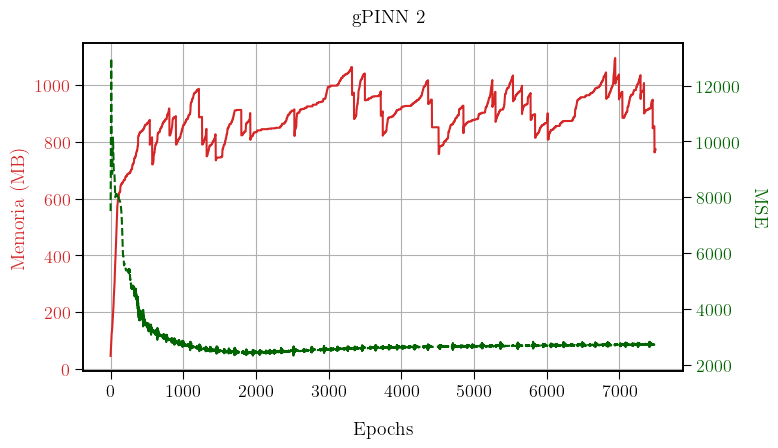

In [ ]:
fig, ax1 = plt.subplots(figsize=(8, 5))
plt.suptitle("gPINN 2", fontsize=14, y=0.9)

# Eje Y izquierdo: Memoria.
color1 = 'tab:red'
ax1.set_xlabel("Epochs", labelpad=15)
ax1.set_ylabel("Memoria (MB)", color=color1)
ax1.plot(range(len(memorias)), memorias, '-', color=color1)
ax1.tick_params(axis='y', labelcolor=color1)
ax1.grid(True)

# Eje Y derecho: Métrico Test (MSE).
ax2 = ax1.twinx()
color2 = '#006400'  
ax2.set_ylabel("MSE", color=color2, rotation=-90, labelpad=20)
ax2.plot(range(len(metrictest)), metrictest, '--', color=color2)
ax2.tick_params(axis='y', labelcolor=color2)

fig.tight_layout(rect=[0, 0, 1, 0.95])
plt.show()

In [18]:
max(memorias)

1095.40625


#### Realización de vídeo y gráficas relevantes.

In [ ]:
# Callback para guardar las predicciones cada 100 iteraciones.
class PredictionLogger(dde.callbacks.Callback):
    def __init__(self, model, X, save_every=100):
        super().__init__()
        self.model = model
        self.X = X  
        self.save_every = save_every
        self.predictions = []
        self.steps = []

    def on_epoch_end(self):
        train_state = self.model.train_state
        step = train_state.step
        if step % self.save_every == 0 or step == 1:
            y_pred = np.array(self.model.predict(self.X))
            self.predictions.append(y_pred)
            self.steps.append(step)

In [ ]:
F = 100  # Reescalado.

In [ ]:
# Geometría y tiempo.
geom = dde.geometry.Interval(0, Lscalado)
timedomain = dde.geometry.TimeDomain(0, T_max)
geomtime = dde.geometry.GeometryXTime(geom, timedomain)

In [ ]:
# Condición inicial u(x, 0) = f(x).
ic = dde.IC(
    geomtime,
    lambda x: ICreescaladox(x),
    lambda x, on_initial: on_initial
)

# Condiciones de frontera homogéneas Dirichlet u(0,t) = u(L,t) = 0.
bc1 = dde.DirichletBC(geomtime, lambda x: 1, lambda x, on_boundary: on_boundary and np.isclose(x[0], 0))
bc2 = dde.NeumannBC(geomtime, lambda x: 0, lambda x, on_boundary: on_boundary and np.isclose(x[0], Lscalado))

data = dde.data.TimePDE(
    geomtime,
    gPINNedpreescaladox,
    [bc1, bc2, ic],
    num_domain=2500,
    num_boundary=100,
    num_initial=1200,
    solution=u_xt1reescaladox,
    num_test=10201,
)

# Red neuronal.
layer_size = [2] + [32] * 4 + [1]
activation = "Tanh"
initializer = "Glorot uniform"
net = dde.nn.FNN(layer_size, activation, initializer)

Nx, Nt = 101, 101
# Crear malla de puntos.
x = np.linspace(0, Lscalado, Nx)
t = np.linspace(0, T_max, Nt)
X, T = np.meshgrid(x, t, indexing='ij')

# Aplanar para tener pares (x, t) como entradas.
XT = np.vstack([X.ravel(), T.ravel()]).T

# Modelo.
model = dde.Model(data, net)
PredictionLogger = PredictionLogger(model, XT, save_every=100)
# Compilar el modelo.
model.compile("adam", lr=0.001, metrics=["MSE"], loss_weights=[2, 1, 1, 1, 1, 4])
# Entrenar el modelo.
model.train(iterations=7500,display_every=1, callbacks=[PredictionLogger])
model.compile("L-BFGS",metrics=["MSE"], loss_weights=[2, 1, 1, 1, 1, 4])
losshistory135, train_state = model.train()

Compiling model...
Building feed-forward neural network...
'build' took 0.033941 s

'compile' took 0.469619 s

Training model...

Step      Train loss                                                      Test loss                                                       Test metric   
0         [8.17e-02, 1.10e-02, 6.58e-02, 1.29e+00, 1.63e-01, 7.60e+00]    [9.50e-02, 1.12e-02, 6.67e-02, 1.29e+00, 1.63e-01, 7.60e+00]    [7.50e-01]    
1         [6.76e-02, 8.30e-03, 2.19e-02, 1.09e+00, 1.41e-01, 7.56e+00]    [7.73e-02, 8.51e-03, 2.12e-02, 1.09e+00, 1.41e-01, 7.56e+00]    [7.95e-01]    
2         [6.37e-02, 6.06e-03, 2.21e-03, 9.21e-01, 1.20e-01, 7.57e+00]    [6.68e-02, 6.31e-03, 1.59e-03, 9.21e-01, 1.20e-01, 7.57e+00]    [8.66e-01]    
3         [6.87e-02, 4.33e-03, 4.08e-03, 7.70e-01, 1.01e-01, 7.61e+00]    [6.28e-02, 4.59e-03, 5.26e-03, 7.70e-01, 1.01e-01, 7.61e+00]    [9.57e-01]    
4         [8.09e-02, 3.07e-03, 2.30e-02, 6.44e-01, 8.65e-02, 7.67e+00]    [6.41e-02, 3.33e-03, 2.74e-02, 

In [23]:
Predip = np.array(PredictionLogger.predictions)
Predip = Predip[:,:,0]

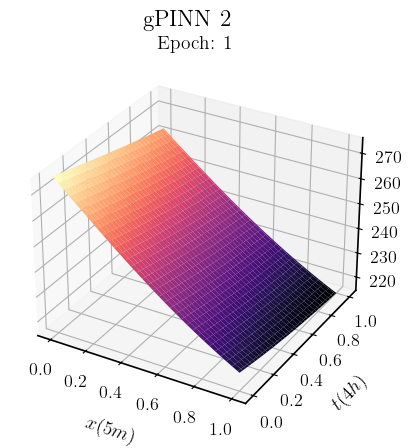

In [ ]:
fig = plt.figure()
ax = fig.add_subplot(111, projection='3d')

def update(i):
    ax.clear()
    Z = Predip[i].reshape(len(x), len(t))*F + Kelvin
    surf = ax.plot_surface(X, T, Z, cmap='magma')
    ax.set_zlim(np.min(Z), np.max(Z))
    ax.set_title(f"Epoch: {PredictionLogger.steps[i]}")
    plt.suptitle("gPINN 2")
    ax.set_xlabel("$x(5m)$",labelpad=10)
    ax.set_ylabel("$t(4h)$",labelpad=10)
    ax.set_zlabel(r"$\hat{u}(x,t)$",labelpad=10)
    return surf

anim5 = animation.FuncAnimation(fig, update, frames=len(Predip), interval=400)
HTML(anim5.to_html5_video())

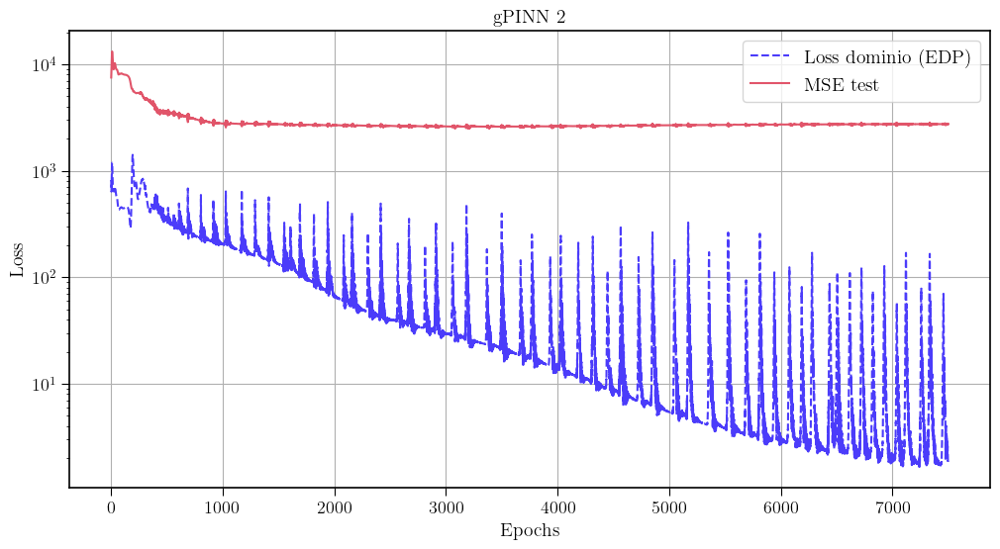

In [ ]:
loss_train = np.array(losshistory135.loss_train)*F**2
testmetric134 = np.array(losshistory135.metrics_test)*F**2

colors = [
    "#4B3CFA", 
    "#33BFE3",  
    "#28A87D",  
    "#F0C640",  
    "#E1556A",  
]

plt.figure(figsize=(12, 6))
plt.plot(loss_train[:, 0], label="Loss dominio (EDP)", linestyle='--', color=colors[0])

plt.plot(testmetric134[:], label="MSE test", linestyle='-', color = colors[4])

plt.yscale("log")
plt.xlabel("Epochs")
plt.ylabel("Loss")
plt.title("gPINN 2")
plt.legend()
plt.grid(True)
plt.show()

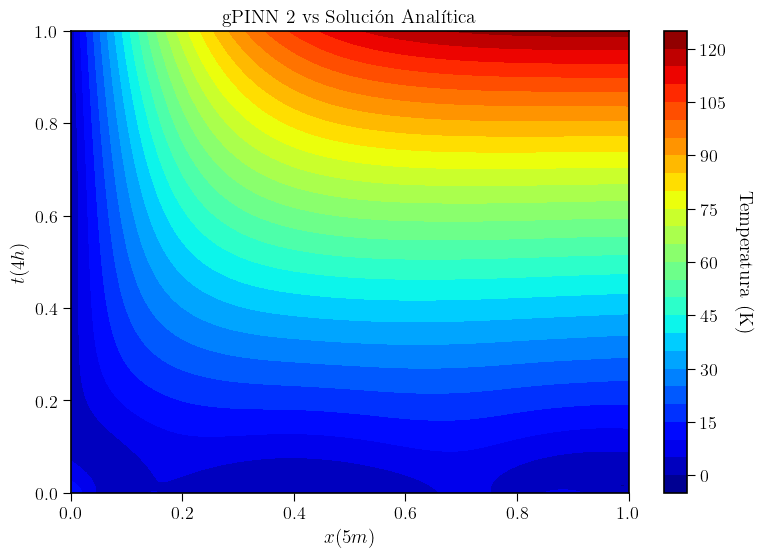

In [ ]:
# Evaluar modelo entrenado.
test_points = geomtime.uniform_points(10201, True)  
y_pred = model.predict(test_points)*F     # Reescalar la predicción.
y_true = u_xt1reescaladox(test_points)*F  # Reescalar la solución analítica.

# Error absoluto.
y_error = np.abs(y_pred - y_true)  

# Graficar el error en el dominio.
x_grid = np.linspace(0, Lscalado, 400)
t_grid = np.linspace(0, T_max, 400)
X, T = np.meshgrid(x_grid, t_grid)
error_grid = griddata(test_points, y_error.flatten(), (X, T), method="cubic")

plt.figure(figsize=(9, 6))
cp = plt.contourf(X, T, error_grid, levels=25, cmap="jet")
cbar = plt.colorbar(cp)
cbar.set_label(r"Temperatura (K)", rotation=-90, labelpad=20)

plt.xlabel("$x (5m)$")
plt.ylabel("$t (4h)$")
plt.title("gPINN 2 vs Solución Analítica")
plt.show()

In [ ]:
# MSE.
mse = np.mean((y_pred - y_true)**2)
print(f"Error cuadrático medio (MSE): {mse:.4f}")

Error cuadrático medio (MSE): 3029.1599


# Media del dominio del error de los modelos Vanilla y gPINN

In [ ]:
F = 1

In [ ]:
# Geometría y tiempo.
geom = dde.geometry.Interval(0, L)
timedomain = dde.geometry.TimeDomain(0, T_max)
geomtime1 = dde.geometry.GeometryXTime(geom, timedomain)

In [ ]:
# Puntos de prueba en el dominio.
test_points = geomtime1.uniform_points(10201, True)
y_true = u_xt1(test_points)  # Solución exacta reescalada.

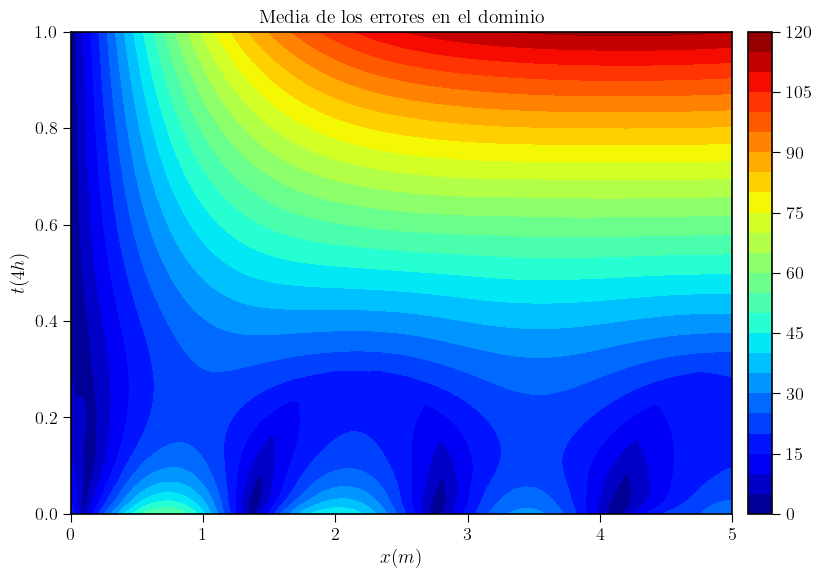


Error absoluto medio global entre los 4 modelos: 4.4811e+01


In [ ]:
# Evaluar los modelos y almacenar errores absolutos.
errores = []
modelos1 = [model1, model3]
modelos2 = [model2, model4]

for model in modelos1:
    y_pred = model.predict(test_points)
    error_abs = np.abs(y_pred - y_true)
    errores.append(error_abs)

test_points[:,0] = test_points[:,0]/L
for model in modelos2:
    y_pred = model.predict(test_points) * 100
    error_abs = np.abs(y_pred - y_true)
    errores.append(error_abs)
    
test_points[:,0] = test_points[:,0]*L

# Convertir a array y calcular media punto a punto.
errores_array = np.array(errores)  # shape: (4, 10201, 1).
error_medio_dominio = np.mean(errores_array, axis=0)  # shape: (10201, 1).

x_grid = np.linspace(0, L, 500)
t_grid = np.linspace(0, T_max, 500)
X, T = np.meshgrid(x_grid, t_grid)

error_grid = griddata(test_points, error_medio_dominio.flatten(), (X, T), method="cubic")

# Graficar el error medio en el dominio.
plt.figure(figsize=(9, 6))
cp = plt.contourf(X, T, error_grid, levels=25, cmap="jet")
cbar = plt.colorbar(cp, pad=0.02)

plt.xlabel("$x (m)$")
plt.ylabel("$t (4h)$")
plt.title("Media de los errores en el dominio")
plt.tight_layout()
plt.show()

media_global = np.mean(error_medio_dominio)
print(f"\nError absoluto medio global entre los 4 modelos: {media_global:.4e}")


# g-PINN + RAR

In [ ]:
# Definición de la EDP.
def gPINNedp(x, u):
    du_t = dde.grad.jacobian(u, x, j=1)                         # ∂u/∂t
    du_xx = dde.grad.hessian(u, x, i=0, j=0)                    # ∂²u/∂x²
    du_tx = dde.grad.hessian(u, x, i=0, j=1)                    # ∂²u/∂x∂t
    du_xxx = dde.grad.jacobian(du_xx, x, j=0)                   # ∂³u/∂x³
    du_tt = dde.grad.hessian(u, x, i=1, j=1)                    # ∂²u/∂t²
    du_xxt = dde.grad.jacobian(du_xx, x, j=1)                   # ∂³u/∂x²∂t
    du_x = dde.grad.jacobian(u, x, j=0)                         # ∂u/∂x
    
    eq = du_t - D * du_xx - K * u
    eq_x = du_tx - D * du_xxx - K * du_x
    eq_t = du_tt - D * du_xxt - K * du_t
    return [eq, eq_x, eq_t]

In [ ]:
# Definición de la EDP.
def gPINNedpreescaladox(x, u):
    du_t = dde.grad.jacobian(u, x, j=1)                         # ∂u/∂t
    du_xx = dde.grad.hessian(u, x, i=0, j=0)                    # ∂²u/∂x²
    du_tx = dde.grad.hessian(u, x, i=0, j=1)                    # ∂²u/∂x∂t
    du_xxx = dde.grad.jacobian(du_xx, x, j=0)                   # ∂³u/∂x³
    du_tt = dde.grad.hessian(u, x, i=1, j=1)                    # ∂²u/∂t²
    du_xxt = dde.grad.jacobian(du_xx, x, j=1)                   # ∂³u/∂x²∂t
    du_x = dde.grad.jacobian(u, x, j=0)                         # ∂u/∂x

    eq = du_t - (D/(L**2))* du_xx - K * u
    eq_x = (1/L)*du_tx - (D/(L**3))*du_xxx - K *(1/L)* du_x
    eq_t = du_tt - (D/(L**2))*du_xxt - K * du_t
    return [eq, eq_x, eq_t]

### Modelo menos complejo

#### Tiempo de entrenamiento

In [24]:
# Reescalar la solución.
F = 1

In [ ]:
# Geometría y tiempo.
geom = dde.geometry.Interval(0, L)
timedomain = dde.geometry.TimeDomain(0, T_max)
geomtime = dde.geometry.GeometryXTime(geom, timedomain)

In [ ]:
%%time

# Condición inicial u(x, 0) = f(x).
ic = dde.IC(
    geomtime,
    lambda x: IC(x),
    lambda x, on_initial: on_initial
)

# Condiciones de frontera homogéneas Dirichlet u(0,t) = u(L,t) = 0.
bc1 = dde.DirichletBC(geomtime, lambda x: 100, lambda x, on_boundary: on_boundary and np.isclose(x[0], 0))
bc2 = dde.NeumannBC(geomtime, lambda x: 0, lambda x, on_boundary: on_boundary and np.isclose(x[0], L))

data = dde.data.TimePDE(
    geomtime,
    gPINNedp,
    [bc1, bc2, ic],
    num_domain=1500,
    num_boundary=100,
    num_initial=120,
    solution=u_xt1,
    num_test=10201,
)

# Red neuronal.
layer_size = [2] + [16] * 2 + [1]
activation = "Tanh"
initializer = "Glorot uniform"
net = dde.nn.FNN(layer_size, activation, initializer)

# Modelo.
model = dde.Model(data, net)
# Compilar el modelo.
model.compile("adam", lr=0.01, metrics=["MSE"])
# Entrenar el modelo.
model.train(iterations=7500,display_every=7500)

# Inicializar variables.
err = 10100
RAR_threshold = 2100
max_rar_cycles = 6   # Número máximo de ciclos RAR.
rar_cycle = 0        # Contador de ciclos.

while rar_cycle < max_rar_cycles:
    X = geomtime.random_points(10000)
    y_pred = model.predict(X)
    y_true = u_xt1(X)
    err = (y_pred - y_true) ** 2

    # Obtener los índices de los 10 puntos con mayor error.
    top10_idx = np.argsort(err.flatten())[-10:]
    x_max_error = X[top10_idx]

    err = np.mean(err)
    print(f"RAR ciclo {rar_cycle+1} - Residual medio: {err:.3e}")

    data.add_anchors(x_max_error)

    model.compile("adam", lr=0.01, metrics=['MSE'])
    losshistory1, trainstate = model.train(iterations=2000, disregard_previous_best=False)

    rar_cycle += 1

if rar_cycle == max_rar_cycles:
    print("Se alcanzó el número máximo de ciclos RAR.")
else:
    print("Se alcanzó el umbral de error deseado.")

Compiling model...
Building feed-forward neural network...
'build' took 0.021997 s

'compile' took 0.272256 s

Training model...

Step      Train loss                                                      Test loss                                                       Test metric   
0         [3.71e-01, 7.78e-02, 2.53e-01, 1.00e+04, 4.82e-03, 2.00e+04]    [3.82e-01, 8.12e-02, 2.64e-01, 1.00e+04, 4.82e-03, 2.00e+04]    [1.09e+04]    
7500      [1.83e+01, 1.45e+02, 2.93e+02, 8.90e+02, 4.94e+01, 1.23e+04]    [1.26e+01, 9.92e+01, 2.13e+02, 8.90e+02, 4.94e+01, 1.23e+04]    [3.05e+03]    

Best model at step 7500:
  train loss: 1.37e+04
  test loss: 1.35e+04
  test metric: [3.05e+03]

'train' took 23.563092 s

RAR ciclo 1 - Residual medio: 2.999e+03
Compiling model...
'compile' took 0.200993 s

Training model...

Step      Train loss                                                      Test loss                                                       Test metric   
7500      [1.82e+01, 1.47e+02

2025-06-27 17:46:21.016951: W tensorflow/c/c_api.cc:305] Operation '{name:'dense_5/bias/Adam_3/Assign' id:4515 op device:{requested: '', assigned: ''} def:{{{node dense_5/bias/Adam_3/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](dense_5/bias/Adam_3, dense_5/bias/Adam_3/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.


8000      [1.76e+01, 1.47e+02, 2.72e+02, 9.41e+02, 5.26e+01, 1.22e+04]    [1.20e+01, 1.00e+02, 2.05e+02, 9.41e+02, 5.26e+01, 1.22e+04]    [3.07e+03]    
9000      [1.80e+01, 1.55e+02, 3.77e+02, 1.06e+03, 5.61e+01, 1.17e+04]    [1.13e+01, 9.82e+01, 2.53e+02, 1.06e+03, 5.61e+01, 1.17e+04]    [3.06e+03]    
9500      [2.11e+01, 2.35e+02, 5.47e+02, 1.10e+03, 6.18e+01, 1.16e+04]    [1.39e+01, 1.51e+02, 3.20e+02, 1.10e+03, 6.18e+01, 1.16e+04]    [3.24e+03]    

Best model at step 9000:
  train loss: 1.34e+04
  test loss: 1.32e+04
  test metric: [3.06e+03]

'train' took 6.575070 s

RAR ciclo 2 - Residual medio: 3.195e+03
Compiling model...
'compile' took 0.204767 s

Training model...

Step      Train loss                                                      Test loss                                                       Test metric   
9500      [2.10e+01, 2.37e+02, 5.46e+02, 1.10e+03, 6.18e+01, 1.16e+04]    [1.39e+01, 1.51e+02, 3.20e+02, 1.10e+03, 6.18e+01, 1.16e+04]    [3.24e+03]    


2025-06-27 17:46:27.825764: W tensorflow/c/c_api.cc:305] Operation '{name:'dense_5/bias/Adam_5/Assign' id:5888 op device:{requested: '', assigned: ''} def:{{{node dense_5/bias/Adam_5/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](dense_5/bias/Adam_5, dense_5/bias/Adam_5/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.


10000     [1.92e+01, 1.56e+02, 2.83e+02, 1.12e+03, 5.45e+01, 1.14e+04]    [1.19e+01, 1.01e+02, 2.15e+02, 1.12e+03, 5.45e+01, 1.14e+04]    [3.30e+03]    
11000     [2.03e+01, 1.57e+02, 3.12e+02, 1.18e+03, 5.87e+01, 1.11e+04]    [1.25e+01, 1.03e+02, 2.34e+02, 1.18e+03, 5.87e+01, 1.11e+04]    [3.49e+03]    
11500     [2.45e+01, 2.22e+02, 5.63e+02, 1.21e+03, 6.08e+01, 1.09e+04]    [1.54e+01, 1.51e+02, 2.98e+02, 1.21e+03, 6.08e+01, 1.09e+04]    [3.69e+03]    

Best model at step 11000:
  train loss: 1.28e+04
  test loss: 1.27e+04
  test metric: [3.49e+03]

'train' took 6.656266 s

RAR ciclo 3 - Residual medio: 3.545e+03
Compiling model...
'compile' took 0.209606 s



2025-06-27 17:46:34.716548: W tensorflow/c/c_api.cc:305] Operation '{name:'dense_5/bias/Adam_7/Assign' id:7275 op device:{requested: '', assigned: ''} def:{{{node dense_5/bias/Adam_7/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](dense_5/bias/Adam_7, dense_5/bias/Adam_7/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.


Training model...

Step      Train loss                                                      Test loss                                                       Test metric   
11500     [2.44e+01, 2.24e+02, 5.62e+02, 1.21e+03, 6.08e+01, 1.09e+04]    [1.54e+01, 1.51e+02, 2.98e+02, 1.21e+03, 6.08e+01, 1.09e+04]    [3.69e+03]    
12000     [1.97e+01, 1.64e+02, 3.02e+02, 1.19e+03, 6.14e+01, 1.10e+04]    [1.20e+01, 1.07e+02, 2.32e+02, 1.19e+03, 6.14e+01, 1.10e+04]    [3.55e+03]    
13000     [2.12e+01, 1.55e+02, 3.25e+02, 1.21e+03, 6.11e+01, 1.07e+04]    [1.30e+01, 1.00e+02, 2.46e+02, 1.21e+03, 6.11e+01, 1.07e+04]    [3.64e+03]    
13500     [2.13e+01, 1.51e+02, 3.06e+02, 1.24e+03, 6.33e+01, 1.06e+04]    [1.31e+01, 9.77e+01, 2.39e+02, 1.24e+03, 6.33e+01, 1.06e+04]    [3.69e+03]    

Best model at step 13500:
  train loss: 1.24e+04
  test loss: 1.23e+04
  test metric: [3.69e+03]

'train' took 6.851924 s

RAR ciclo 4 - Residual medio: 3.619e+03
Compiling model...
'compile' took 0.211276 s



2025-06-27 17:46:41.811148: W tensorflow/c/c_api.cc:305] Operation '{name:'dense_5/bias/Adam_9/Assign' id:8676 op device:{requested: '', assigned: ''} def:{{{node dense_5/bias/Adam_9/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](dense_5/bias/Adam_9, dense_5/bias/Adam_9/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.


Training model...

Step      Train loss                                                      Test loss                                                       Test metric   
13500     [2.15e+01, 1.52e+02, 3.07e+02, 1.24e+03, 6.33e+01, 1.06e+04]    [1.31e+01, 9.77e+01, 2.39e+02, 1.24e+03, 6.33e+01, 1.06e+04]    [3.69e+03]    
14000     [1.96e+01, 1.59e+02, 2.93e+02, 1.25e+03, 6.53e+01, 1.06e+04]    [1.17e+01, 1.03e+02, 2.29e+02, 1.25e+03, 6.53e+01, 1.06e+04]    [3.70e+03]    
15000     [2.27e+01, 1.52e+02, 3.14e+02, 1.27e+03, 6.33e+01, 1.04e+04]    [1.41e+01, 1.01e+02, 2.44e+02, 1.27e+03, 6.33e+01, 1.04e+04]    [3.83e+03]    
15500     [2.24e+01, 1.51e+02, 3.06e+02, 1.29e+03, 6.11e+01, 1.03e+04]    [1.39e+01, 9.97e+01, 2.39e+02, 1.29e+03, 6.11e+01, 1.03e+04]    [3.84e+03]    

Best model at step 15500:
  train loss: 1.21e+04
  test loss: 1.20e+04
  test metric: [3.84e+03]

'train' took 6.871342 s

RAR ciclo 5 - Residual medio: 3.731e+03
Compiling model...
'compile' took 0.216764 s



2025-06-27 17:46:48.927892: W tensorflow/c/c_api.cc:305] Operation '{name:'dense_5/bias/Adam_11/Assign' id:10091 op device:{requested: '', assigned: ''} def:{{{node dense_5/bias/Adam_11/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](dense_5/bias/Adam_11, dense_5/bias/Adam_11/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.


Training model...

Step      Train loss                                                      Test loss                                                       Test metric   
15500     [2.25e+01, 1.52e+02, 3.06e+02, 1.29e+03, 6.11e+01, 1.03e+04]    [1.39e+01, 9.97e+01, 2.39e+02, 1.29e+03, 6.11e+01, 1.03e+04]    [3.84e+03]    
16000     [2.16e+01, 1.49e+02, 2.81e+02, 1.29e+03, 6.05e+01, 1.03e+04]    [1.33e+01, 9.74e+01, 2.21e+02, 1.29e+03, 6.05e+01, 1.03e+04]    [3.84e+03]    
17000     [2.22e+01, 1.46e+02, 3.16e+02, 1.32e+03, 5.65e+01, 1.01e+04]    [1.38e+01, 9.78e+01, 2.45e+02, 1.32e+03, 5.65e+01, 1.01e+04]    [3.92e+03]    
17500     [2.12e+01, 1.47e+02, 3.16e+02, 1.34e+03, 5.54e+01, 1.01e+04]    [1.32e+01, 9.71e+01, 2.38e+02, 1.34e+03, 5.54e+01, 1.01e+04]    [3.95e+03]    

Best model at step 17500:
  train loss: 1.19e+04
  test loss: 1.18e+04
  test metric: [3.95e+03]

'train' took 6.831413 s

RAR ciclo 6 - Residual medio: 3.923e+03
Compiling model...
'compile' took 0.222703 s



2025-06-27 17:46:56.009895: W tensorflow/c/c_api.cc:305] Operation '{name:'dense_5/bias/Adam_13/Assign' id:11520 op device:{requested: '', assigned: ''} def:{{{node dense_5/bias/Adam_13/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](dense_5/bias/Adam_13, dense_5/bias/Adam_13/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.


Training model...

Step      Train loss                                                      Test loss                                                       Test metric   
17500     [2.14e+01, 1.48e+02, 3.16e+02, 1.34e+03, 5.54e+01, 1.01e+04]    [1.32e+01, 9.71e+01, 2.38e+02, 1.34e+03, 5.54e+01, 1.01e+04]    [3.95e+03]    
18000     [2.22e+01, 1.46e+02, 3.07e+02, 1.31e+03, 5.53e+01, 1.01e+04]    [1.37e+01, 9.36e+01, 2.32e+02, 1.31e+03, 5.53e+01, 1.01e+04]    [3.96e+03]    
19000     [2.20e+01, 1.42e+02, 2.96e+02, 1.32e+03, 5.29e+01, 9.96e+03]    [1.36e+01, 9.40e+01, 2.29e+02, 1.32e+03, 5.29e+01, 9.96e+03]    [3.95e+03]    
19500     [2.18e+01, 1.42e+02, 3.11e+02, 1.34e+03, 5.24e+01, 9.88e+03]    [1.35e+01, 9.41e+01, 2.32e+02, 1.34e+03, 5.24e+01, 9.88e+03]    [4.00e+03]    

Best model at step 19500:
  train loss: 1.17e+04
  test loss: 1.16e+04
  test metric: [4.00e+03]

'train' took 7.306523 s

Se alcanzó el número máximo de ciclos RAR.
CPU times: user 57.7 s, sys: 17.1 s, total: 1min 

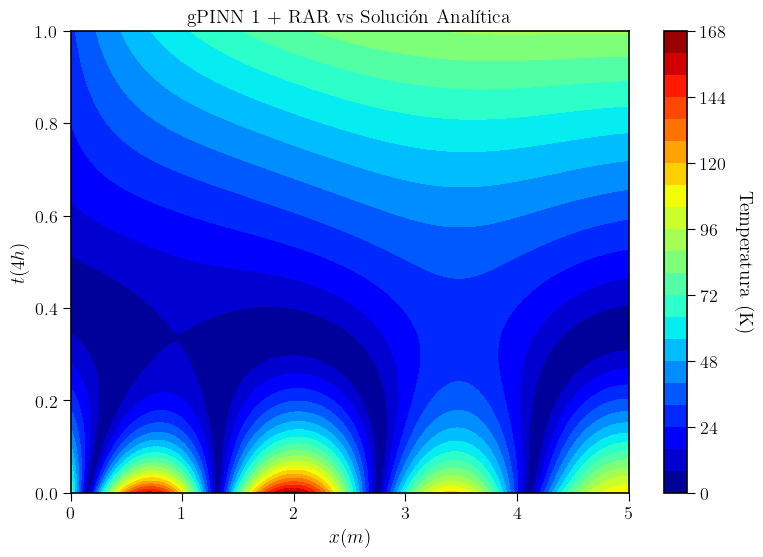

In [ ]:
# Evaluar modelo entrenad
test_points = geomtime.uniform_points(10201, True)  
y_pred = model.predict(test_points)*F  # Reescalar la predicción.
y_true = u_xt1(test_points)*F          # Reescalar la solución analítica.

# Error absoluto.
y_error = np.abs(y_pred - y_true)  

# Graficar el error en el dominio.
x_grid = np.linspace(0, L, 500)
t_grid = np.linspace(0, T_max, 500)
X, T = np.meshgrid(x_grid, t_grid)
error_grid = griddata(test_points, y_error.flatten(), (X, T), method="cubic")

plt.figure(figsize=(9, 6))
cp = plt.contourf(X, T, error_grid, levels=25, cmap="jet")
cbar = plt.colorbar(cp)
cbar.set_label(r"Temperatura (K)", rotation=-90, labelpad=20)

plt.xlabel("$x (m)$")
plt.ylabel("$t (4h)$")
plt.title("gPINN 1 + RAR vs Solución Analítica")
plt.show()

In [ ]:
# MSE.
mse = np.mean((y_pred-y_true)**2)
print(f"Error cuadrático medio (MSE): {mse:.4f}")

Error cuadrático medio (MSE): 2150.9072


#### Consumo de memoria

In [ ]:
class MemoryCallback(dde.callbacks.Callback):
    def __init__(self):
        super().__init__()  
        self.process = psutil.Process()
        self.memory_per_epoch = []
        self.mem_init = None
        
    def on_train_begin(self):
        # Guardar memoria inicial al comenzar.
        self.mem_init = self.process.memory_info().rss / (1024 * 1024)

    def on_epoch_end(self):
        mem = self.process.memory_info().rss / (1024 * 1024)  # MB.
        self.memory_per_epoch.append(mem)

    def get_memory(self):
        return self.memory_per_epoch

In [ ]:
# Condición inicial u(x, 0) = f(x).
ic = dde.IC(
    geomtime,
    lambda x: IC(x),
    lambda x, on_initial: on_initial
)

# Condiciones de frontera homogéneas Dirichlet u(0,t) = u(L,t) = 0.
bc1 = dde.DirichletBC(geomtime, lambda x: 100, lambda x, on_boundary: on_boundary and np.isclose(x[0], 0))
bc2 = dde.NeumannBC(geomtime, lambda x: 0, lambda x, on_boundary: on_boundary and np.isclose(x[0], L))

data = dde.data.TimePDE(
    geomtime,
    gPINNedp,
    [bc1, bc2, ic],
    num_domain=1500,
    num_boundary=100,
    num_initial=120,
    solution=u_xt1,
    num_test=10201,
)

# Red neuronal.
layer_size = [2] + [16] * 2 + [1]
activation = "Tanh"
initializer = "Glorot uniform"
net = dde.nn.FNN(layer_size, activation, initializer)

# Modelo.
model = dde.Model(data, net)
# Compilar el modelo.
model.compile("adam", lr=0.01, metrics=["MSE"])
mem_cb = MemoryCallback()
mem_cb1 = MemoryCallback()

# Entrenar el modelo.
model.train(iterations=7500,display_every=1, callbacks=[mem_cb])
memoria_por_epoca1 = mem_cb.get_memory()
memoriaini = mem_cb.mem_init

# RAR manual: refinamiento adaptativo.
err = 10000
RAR_threshold = 2100
max_rar_cycles = 20  # Número máximo de ciclos RAR.
rar_cycle = 0        # Contador de ciclos.

while err > RAR_threshold and rar_cycle < max_rar_cycles:
    X = geomtime.random_points(10000)
    y_pred = model.predict(X)
    y_true = u_xt1(X)  
    err = (y_pred - y_true)**2
    
    # Obtener los índices de los 5 puntos con mayor error.
    top10_idx = np.argsort(err.flatten())[-10:]
    x_max_error = X[top10_idx]  
    
    err = np.mean(err)
    print("Residual medio: %.3e" % err)
    data.add_anchors(x_max_error)
    
    model.compile("adam", lr=0.01,metrics=["MSE"])
    losshistory2342, trainstate = model.train(iterations=2000, display_every=1,disregard_previous_best=False, callbacks=[mem_cb1])

    rar_cycle += 1

if rar_cycle == max_rar_cycles:
    print("Se alcanzó el número máximo de ciclos RAR.")
else:
    print("Se alcanzó el umbral de error deseado.")
memooo = mem_cb1.get_memory()

Compiling model...
Building feed-forward neural network...
'build' took 0.023601 s

'compile' took 0.268232 s

Training model...

Step      Train loss                                                      Test loss                                                       Test metric   
0         [1.71e-01, 1.60e-02, 2.71e-03, 9.99e+03, 5.34e-05, 2.00e+04]    [1.71e-01, 1.63e-02, 2.49e-03, 9.99e+03, 5.34e-05, 2.00e+04]    [1.10e+04]    


I0000 00:00:1751037947.434301   87532 mlir_graph_optimization_pass.cc:425] MLIR V1 optimization pass is not enabled


1         [3.12e-01, 1.77e-02, 1.58e-02, 9.95e+03, 8.89e-04, 2.00e+04]    [3.08e-01, 1.75e-02, 1.48e-02, 9.95e+03, 8.89e-04, 2.00e+04]    [1.10e+04]    
2         [5.17e-01, 2.27e-02, 5.99e-02, 9.90e+03, 2.64e-03, 2.00e+04]    [5.04e-01, 2.17e-02, 5.80e-02, 9.90e+03, 2.64e-03, 2.00e+04]    [1.10e+04]    
3         [7.85e-01, 3.04e-02, 1.38e-01, 9.85e+03, 5.23e-03, 2.00e+04]    [7.60e-01, 2.85e-02, 1.35e-01, 9.85e+03, 5.23e-03, 2.00e+04]    [1.10e+04]    
4         [1.11e+00, 4.11e-02, 2.57e-01, 9.81e+03, 8.72e-03, 2.00e+04]    [1.07e+00, 3.79e-02, 2.52e-01, 9.81e+03, 8.72e-03, 2.00e+04]    [1.09e+04]    
5         [1.49e+00, 5.57e-02, 4.28e-01, 9.75e+03, 1.33e-02, 2.00e+04]    [1.43e+00, 5.08e-02, 4.21e-01, 9.75e+03, 1.33e-02, 2.00e+04]    [1.09e+04]    
6         [1.93e+00, 7.64e-02, 6.72e-01, 9.70e+03, 1.92e-02, 2.00e+04]    [1.84e+00, 6.91e-02, 6.60e-01, 9.70e+03, 1.92e-02, 2.00e+04]    [1.09e+04]    
7         [2.43e+00, 1.06e-01, 1.01e+00, 9.64e+03, 2.69e-02, 2.00e+04]    [2.31e+0

2025-06-27 17:27:17.968098: W tensorflow/c/c_api.cc:305] Operation '{name:'dense_2/bias/Adam_3/Assign' id:2866 op device:{requested: '', assigned: ''} def:{{{node dense_2/bias/Adam_3/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](dense_2/bias/Adam_3, dense_2/bias/Adam_3/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.


7501      [8.92e+02, 1.41e+04, 7.03e+04, 4.62e+02, 1.72e+02, 1.26e+04]    [9.89e+02, 1.43e+04, 1.99e+04, 4.62e+02, 1.72e+02, 1.26e+04]    [2.67e+03]    
7502      [2.71e+02, 3.82e+03, 5.66e+03, 3.95e+02, 1.51e+02, 1.27e+04]    [2.91e+02, 3.59e+03, 2.61e+03, 3.95e+02, 1.51e+02, 1.27e+04]    [2.69e+03]    
7503      [9.06e+01, 1.67e+03, 1.74e+04, 3.31e+02, 1.22e+02, 1.27e+04]    [7.31e+01, 1.16e+03, 4.32e+03, 3.31e+02, 1.22e+02, 1.27e+04]    [2.94e+03]    
7504      [3.59e+02, 4.95e+03, 3.03e+04, 3.02e+02, 1.01e+02, 1.28e+04]    [3.79e+02, 5.29e+03, 7.85e+03, 3.02e+02, 1.01e+02, 1.28e+04]    [3.22e+03]    
7505      [5.05e+02, 6.43e+03, 2.26e+04, 3.16e+02, 9.71e+01, 1.29e+04]    [5.55e+02, 7.01e+03, 6.45e+03, 3.16e+02, 9.71e+01, 1.29e+04]    [3.24e+03]    
7506      [4.56e+02, 5.61e+03, 1.18e+04, 3.56e+02, 1.03e+02, 1.28e+04]    [5.01e+02, 5.82e+03, 3.98e+03, 3.56e+02, 1.03e+02, 1.28e+04]    [3.06e+03]    
7507      [3.33e+02, 3.96e+03, 6.75e+03, 4.09e+02, 1.14e+02, 1.27e+04]    [3.52e+0

2025-06-27 17:27:43.653657: W tensorflow/c/c_api.cc:305] Operation '{name:'dense_2/bias/Adam_5/Assign' id:4219 op device:{requested: '', assigned: ''} def:{{{node dense_2/bias/Adam_5/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](dense_2/bias/Adam_5, dense_2/bias/Adam_5/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.


9501      [8.37e+02, 8.89e+03, 1.08e+05, 3.62e+02, 3.35e+01, 1.24e+04]    [6.59e+02, 6.96e+03, 2.94e+04, 3.62e+02, 3.35e+01, 1.24e+04]    [3.51e+03]    
9502      [1.05e+02, 1.37e+03, 1.51e+04, 4.28e+02, 7.28e+01, 1.21e+04]    [7.89e+01, 8.52e+02, 5.15e+03, 4.28e+02, 7.28e+01, 1.21e+04]    [2.87e+03]    
9503      [1.55e+02, 1.90e+03, 2.36e+04, 4.99e+02, 1.17e+02, 1.20e+04]    [1.30e+02, 1.44e+03, 5.84e+03, 4.99e+02, 1.17e+02, 1.20e+04]    [2.44e+03]    
9504      [4.10e+02, 4.99e+03, 4.57e+04, 5.41e+02, 1.40e+02, 1.21e+04]    [3.80e+02, 4.50e+03, 1.39e+04, 5.41e+02, 1.40e+02, 1.21e+04]    [2.29e+03]    
9505      [3.90e+02, 5.22e+03, 3.63e+04, 5.37e+02, 1.43e+02, 1.22e+04]    [3.87e+02, 4.89e+03, 1.19e+04, 5.37e+02, 1.43e+02, 1.22e+04]    [2.31e+03]    
9506      [2.12e+02, 3.36e+03, 1.52e+04, 5.09e+02, 1.26e+02, 1.22e+04]    [2.22e+02, 3.22e+03, 5.42e+03, 5.09e+02, 1.26e+02, 1.22e+04]    [2.42e+03]    
9507      [1.08e+02, 2.14e+03, 4.69e+03, 4.76e+02, 1.00e+02, 1.23e+04]    [1.07e+0

2025-06-27 17:28:12.566225: W tensorflow/c/c_api.cc:305] Operation '{name:'dense_2/bias/Adam_7/Assign' id:5586 op device:{requested: '', assigned: ''} def:{{{node dense_2/bias/Adam_7/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](dense_2/bias/Adam_7, dense_2/bias/Adam_7/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.


11501     [6.63e+02, 1.16e+04, 1.27e+05, 7.34e+02, 1.02e+02, 1.15e+04]    [4.73e+02, 7.90e+03, 3.78e+04, 7.34e+02, 1.02e+02, 1.15e+04]    [1.88e+03]    
11502     [8.93e+01, 1.44e+03, 9.13e+03, 5.94e+02, 7.62e+01, 1.16e+04]    [7.38e+01, 1.08e+03, 3.29e+03, 5.94e+02, 7.62e+01, 1.16e+04]    [2.26e+03]    
11503     [1.47e+02, 1.85e+03, 2.87e+04, 4.86e+02, 7.39e+01, 1.19e+04]    [1.04e+02, 1.36e+03, 6.56e+03, 4.86e+02, 7.39e+01, 1.19e+04]    [2.82e+03]    
11504     [3.14e+02, 3.94e+03, 6.04e+04, 4.46e+02, 7.44e+01, 1.20e+04]    [2.17e+02, 2.89e+03, 1.49e+04, 4.46e+02, 7.44e+01, 1.20e+04]    [3.22e+03]    
11505     [3.02e+02, 3.79e+03, 4.43e+04, 4.53e+02, 6.28e+01, 1.20e+04]    [2.15e+02, 2.74e+03, 1.19e+04, 4.53e+02, 6.28e+01, 1.20e+04]    [3.35e+03]    
11506     [2.45e+02, 3.09e+03, 2.01e+04, 4.86e+02, 5.47e+01, 1.19e+04]    [1.96e+02, 2.25e+03, 6.07e+03, 4.86e+02, 5.47e+01, 1.19e+04]    [3.24e+03]    
11507     [1.97e+02, 2.31e+03, 9.17e+03, 5.40e+02, 5.76e+01, 1.17e+04]    [1.76e+0

2025-06-27 17:28:44.680591: W tensorflow/c/c_api.cc:305] Operation '{name:'dense_2/bias/Adam_9/Assign' id:6967 op device:{requested: '', assigned: ''} def:{{{node dense_2/bias/Adam_9/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](dense_2/bias/Adam_9, dense_2/bias/Adam_9/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.


Training model...

Step      Train loss                                                      Test loss                                                       Test metric   
13500     [8.57e+00, 1.31e+02, 4.62e+02, 6.45e+02, 4.90e+01, 1.12e+04]    [6.84e+00, 9.48e+01, 3.12e+02, 6.45e+02, 4.90e+01, 1.12e+04]    [2.37e+03]    
13501     [8.39e+02, 8.64e+03, 1.18e+05, 5.45e+02, 1.42e+02, 1.18e+04]    [6.83e+02, 6.85e+03, 2.94e+04, 5.45e+02, 1.42e+02, 1.18e+04]    [3.13e+03]    
13502     [7.92e+01, 1.09e+03, 9.91e+03, 6.16e+02, 5.44e+01, 1.13e+04]    [6.32e+01, 7.76e+02, 3.14e+03, 6.16e+02, 5.44e+01, 1.13e+04]    [2.53e+03]    
13503     [2.15e+02, 2.61e+03, 2.68e+04, 7.09e+02, 6.46e+01, 1.10e+04]    [1.79e+02, 2.17e+03, 7.31e+03, 7.09e+02, 6.46e+01, 1.10e+04]    [2.00e+03]    
13504     [5.16e+02, 6.25e+03, 5.86e+04, 7.72e+02, 8.28e+01, 1.09e+04]    [4.31e+02, 5.39e+03, 1.80e+04, 7.72e+02, 8.28e+01, 1.09e+04]    [1.79e+03]    
13505     [4.21e+02, 5.45e+03, 4.17e+04, 7.63e+02, 6.98e+01, 1.

2025-06-27 17:29:19.392549: W tensorflow/c/c_api.cc:305] Operation '{name:'dense_2/bias/Adam_11/Assign' id:8362 op device:{requested: '', assigned: ''} def:{{{node dense_2/bias/Adam_11/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](dense_2/bias/Adam_11, dense_2/bias/Adam_11/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.


Training model...

Step      Train loss                                                      Test loss                                                       Test metric   
15500     [1.11e+01, 1.29e+02, 4.36e+02, 7.24e+02, 4.71e+01, 1.08e+04]    [1.05e+01, 9.23e+01, 2.80e+02, 7.24e+02, 4.71e+01, 1.08e+04]    [2.20e+03]    
15501     [6.52e+02, 2.04e+04, 1.41e+05, 9.99e+02, 9.40e+01, 1.05e+04]    [4.42e+02, 9.15e+03, 4.30e+04, 9.99e+02, 9.40e+01, 1.05e+04]    [1.71e+03]    
15502     [6.90e+01, 2.04e+03, 1.14e+04, 8.13e+02, 5.00e+01, 1.08e+04]    [4.79e+01, 9.44e+02, 3.89e+03, 8.13e+02, 5.00e+01, 1.08e+04]    [1.98e+03]    
15503     [1.82e+02, 2.75e+03, 2.37e+04, 6.64e+02, 5.89e+01, 1.11e+04]    [1.62e+02, 1.96e+03, 6.17e+03, 6.64e+02, 5.89e+01, 1.11e+04]    [2.41e+03]    
15504     [4.03e+02, 6.07e+03, 5.77e+04, 6.11e+02, 7.96e+01, 1.13e+04]    [3.32e+02, 3.92e+03, 1.53e+04, 6.11e+02, 7.96e+01, 1.13e+04]    [2.72e+03]    
15505     [4.33e+02, 5.49e+03, 5.00e+04, 6.15e+02, 9.16e+01, 1.

2025-06-27 17:29:57.057110: W tensorflow/c/c_api.cc:305] Operation '{name:'dense_2/bias/Adam_13/Assign' id:9771 op device:{requested: '', assigned: ''} def:{{{node dense_2/bias/Adam_13/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](dense_2/bias/Adam_13, dense_2/bias/Adam_13/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.


Training model...

Step      Train loss                                                      Test loss                                                       Test metric   
17500     [1.97e+01, 1.49e+02, 4.98e+02, 8.22e+02, 4.48e+01, 1.04e+04]    [1.87e+01, 1.04e+02, 3.02e+02, 8.22e+02, 4.48e+01, 1.04e+04]    [2.12e+03]    
17501     [7.01e+02, 1.03e+04, 1.25e+05, 6.31e+02, 4.86e+01, 1.09e+04]    [6.55e+02, 8.70e+03, 2.75e+04, 6.31e+02, 4.86e+01, 1.09e+04]    [2.08e+03]    
17502     [1.01e+02, 1.16e+03, 1.15e+04, 6.95e+02, 6.91e+01, 1.07e+04]    [7.56e+01, 7.79e+02, 3.73e+03, 6.95e+02, 6.91e+01, 1.07e+04]    [1.99e+03]    
17503     [1.92e+02, 2.09e+03, 2.70e+04, 8.76e+02, 9.43e+01, 1.05e+04]    [1.66e+02, 1.51e+03, 6.00e+03, 8.76e+02, 9.43e+01, 1.05e+04]    [2.18e+03]    
17504     [4.10e+02, 4.86e+03, 6.17e+04, 9.69e+02, 1.13e+02, 1.05e+04]    [3.49e+02, 3.39e+03, 1.44e+04, 9.69e+02, 1.13e+02, 1.05e+04]    [2.38e+03]    
17505     [3.35e+02, 4.17e+03, 4.38e+04, 9.13e+02, 1.12e+02, 1.

In [ ]:
# Corregir la memoria restando la memoria inicial.
memoria1 = np.array(memoria_por_epoca1) - memoriaini
memoria2 = np.array(memooo) - memoriaini

# Métricas MSE.
mse1 = np.array(losshistory2342.metrics_test)[:7500]
mse2 = np.array(losshistory2342.metrics_test)[7500:]

# Concatenar para graficar todo en una sola curva.
memoria_total = np.concatenate([memoria1, memoria2])
mse_total = np.concatenate([mse1, mse2])

In [16]:
np.savetxt('2memoriasgPINN1RAR.txt', memoria_total)
np.savetxt('2MSEgPINN1RAR.txt', mse_total)

In [12]:
iteracioness = len(memoria_total)
print("Iteraciones:", iteracioness)

Iteraciones: 19500


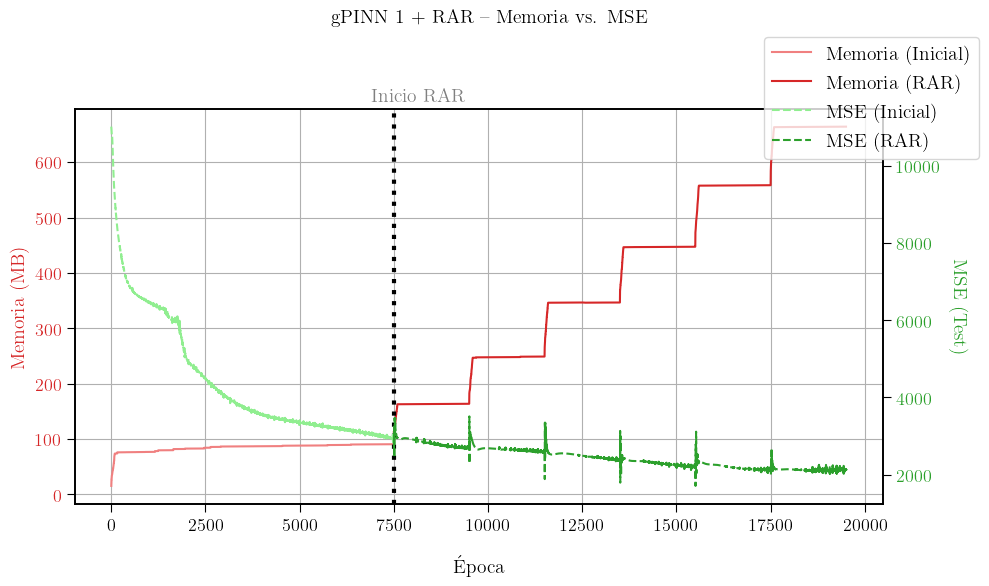

In [ ]:
fig, ax1 = plt.subplots(figsize=(10, 6))
plt.suptitle("gPINN 1 + RAR – Memoria vs. MSE", fontsize=14)

# Eje izquierdo: Memoria RAM.
color1_light = '#f08080'   
color1_dark = 'tab:red'  

ax1.set_xlabel("Época", labelpad=15)
ax1.set_ylabel("Memoria (MB)", color=color1_dark)
ax1.plot(range(len(memoria1)), memoria1, '-', color=color1_light, label="Memoria (Inicial)")
ax1.plot(range(len(memoria1), len(memoria_total)), memoria2, '-', color=color1_dark, label="Memoria (RAR)")
ax1.tick_params(axis='y', labelcolor=color1_dark)
ax1.grid(True)

# Eje derecho: Métrico de Test (MSE).
color2_light = '#90ee90'  
color2_dark = 'tab:green' 

ax2 = ax1.twinx()
ax2.set_ylabel("MSE (Test)", color=color2_dark, rotation=-90, labelpad=20)
ax2.plot(range(len(mse1)), mse1, '--', color=color2_light, label="MSE (Inicial)")
ax2.plot(range(len(mse1), len(mse_total)), mse2, '--', color=color2_dark, label="MSE (RAR)")
ax2.tick_params(axis='y', labelcolor=color2_dark)

# Línea vertical para marcar inicio de RAR.
rar_start = len(memoria1)
ax1.axvline(x=rar_start, color='black', linestyle=':', linewidth=3)
ax1.text(rar_start-600, ax1.get_ylim()[1]*1.02, "Inicio RAR", rotation=0, color='gray')

lines1, labels1 = ax1.get_legend_handles_labels()
lines2, labels2 = ax2.get_legend_handles_labels()
fig.legend(lines1 + lines2, labels1 + labels2, loc="upper right", bbox_to_anchor=(1, 0.95))

fig.tight_layout(rect=[0, 0, 1, 0.95])
plt.show()

Tiempo que tarda gPINN1

In [ ]:
%%time
# Condición inicial u(x, 0) = f(x).
ic = dde.IC(
    geomtime,
    lambda x: IC(x),
    lambda x, on_initial: on_initial
)

# Condiciones de frontera homogéneas Dirichlet u(0,t) = u(L,t) = 0.
bc1 = dde.DirichletBC(geomtime, lambda x: 100, lambda x, on_boundary: on_boundary and np.isclose(x[0], 0))
bc2 = dde.NeumannBC(geomtime, lambda x: 0, lambda x, on_boundary: on_boundary and np.isclose(x[0], L))

data = dde.data.TimePDE(
    geomtime,
    gPINNedp,
    [bc1, bc2, ic],
    num_domain=1500,
    num_boundary=100,
    num_initial=120,
    solution=u_xt1,
    num_test=10201,
)

# Red neuronal.
layer_size = [2] + [16] * 2 + [1]
activation = "Tanh"
initializer = "Glorot uniform"
net = dde.nn.FNN(layer_size, activation, initializer)

# Modelo.
model = dde.Model(data, net)

# Compilar el modelo.
model.compile("adam", lr=0.01, metrics=["MSE"])
# Entrenar el modelo.
losshistory134123, train_state = model.train(iterations=19500)

Compiling model...
Building feed-forward neural network...
'build' took 0.018725 s

'compile' took 0.322207 s

Training model...

Step      Train loss                                                      Test loss                                                       Test metric   
0         [3.74e-01, 7.77e-02, 2.52e-01, 1.00e+04, 4.87e-03, 2.00e+04]    [3.82e-01, 8.12e-02, 2.64e-01, 1.00e+04, 4.87e-03, 2.00e+04]    [1.09e+04]    
1000      [8.99e+02, 4.03e+02, 5.29e+02, 9.49e+02, 6.28e+01, 1.70e+04]    [7.69e+02, 3.75e+02, 4.38e+02, 9.49e+02, 6.28e+01, 1.70e+04]    [6.52e+03]    
2000      [6.02e+02, 3.72e+02, 3.26e+02, 6.86e+02, 6.40e+01, 1.60e+04]    [5.07e+02, 3.51e+02, 2.23e+02, 6.86e+02, 6.40e+01, 1.60e+04]    [5.74e+03]    
3000      [1.89e+02, 2.07e+02, 3.14e+02, 4.34e+02, 3.70e+01, 1.47e+04]    [1.66e+02, 1.66e+02, 2.09e+02, 4.34e+02, 3.70e+01, 1.47e+04]    [4.13e+03]    
4000      [8.19e+01, 1.39e+02, 3.30e+02, 5.04e+02, 6.02e+01, 1.39e+04]    [7.22e+01, 9.45e+01, 2.68e+02, 

Comparación con gPINN 1

In [ ]:
# Condición inicial u(x, 0) = f(x).
ic = dde.IC(
    geomtime,
    lambda x: IC(x),
    lambda x, on_initial: on_initial
)

# Condiciones de frontera homogéneas Dirichlet u(0,t) = u(L,t) = 0.
bc1 = dde.DirichletBC(geomtime, lambda x: 100, lambda x, on_boundary: on_boundary and np.isclose(x[0], 0))
bc2 = dde.NeumannBC(geomtime, lambda x: 0, lambda x, on_boundary: on_boundary and np.isclose(x[0], L))

data = dde.data.TimePDE(
    geomtime,
    gPINNedp,
    [bc1, bc2, ic],
    num_domain=1500,
    num_boundary=100,
    num_initial=120,
    solution=u_xt1,
    num_test=10201,
)

# Red neuronal.
layer_size = [2] + [16] * 2 + [1]
activation = "Tanh"
initializer = "Glorot uniform"
net = dde.nn.FNN(layer_size, activation, initializer)

# Modelo.
model = dde.Model(data, net)

# Compilar el modelo.
model.compile("adam", lr=0.01, metrics=["MSE"])
mem_cb = MemoryCallback()
# Entrenar el modelo.
losshistory134, train_state = model.train(iterations=19500,display_every=1, callbacks=[mem_cb])

Compiling model...
Building feed-forward neural network...
'build' took 0.020903 s

'compile' took 0.264943 s

Training model...

Step      Train loss                                                      Test loss                                                       Test metric   
0         [3.74e-01, 7.77e-02, 2.52e-01, 1.00e+04, 4.89e-03, 2.00e+04]    [3.82e-01, 8.12e-02, 2.64e-01, 1.00e+04, 4.89e-03, 2.00e+04]    [1.09e+04]    


I0000 00:00:1751038365.938434   92013 mlir_graph_optimization_pass.cc:425] MLIR V1 optimization pass is not enabled


1         [5.43e-01, 8.60e-02, 1.24e-01, 1.00e+04, 8.71e-03, 2.00e+04]    [5.53e-01, 9.00e-02, 1.31e-01, 1.00e+04, 8.71e-03, 2.00e+04]    [1.09e+04]    
2         [7.66e-01, 9.47e-02, 4.54e-02, 9.95e+03, 1.28e-02, 2.00e+04]    [7.72e-01, 9.88e-02, 4.87e-02, 9.95e+03, 1.28e-02, 2.00e+04]    [1.09e+04]    
3         [1.05e+00, 1.05e-01, 1.15e-02, 9.90e+03, 1.72e-02, 2.00e+04]    [1.05e+00, 1.09e-01, 1.10e-02, 9.90e+03, 1.72e-02, 2.00e+04]    [1.09e+04]    
4         [1.40e+00, 1.19e-01, 1.71e-02, 9.85e+03, 2.18e-02, 2.00e+04]    [1.38e+00, 1.22e-01, 1.21e-02, 9.85e+03, 2.18e-02, 2.00e+04]    [1.09e+04]    
5         [1.82e+00, 1.39e-01, 6.05e-02, 9.80e+03, 2.65e-02, 2.00e+04]    [1.78e+00, 1.39e-01, 4.90e-02, 9.80e+03, 2.65e-02, 2.00e+04]    [1.08e+04]    
6         [2.31e+00, 1.69e-01, 1.44e-01, 9.74e+03, 3.18e-02, 1.99e+04]    [2.25e+00, 1.63e-01, 1.23e-01, 9.74e+03, 3.18e-02, 1.99e+04]    [1.08e+04]    
7         [2.89e+00, 2.19e-01, 2.78e-01, 9.68e+03, 3.78e-02, 1.99e+04]    [2.81e+0

In [11]:
metrictest = losshistory134.metrics_test

In [12]:
memoria_por_epoca = mem_cb.get_memory()
memoria_por_epoca=np.array(memoria_por_epoca)-mem_cb.mem_init

In [13]:
np.savetxt('2memoriasPRUEBAgPINN1.txt', memoria_por_epoca)

In [19]:
memorias = np.loadtxt('2memoriasgPINN1RAR.txt')
mse = np.loadtxt('2MSEgPINN1RAR.txt')

In [20]:
memoria_por_epoca=np.loadtxt('2memoriasPRUEBAgPINN1.txt')

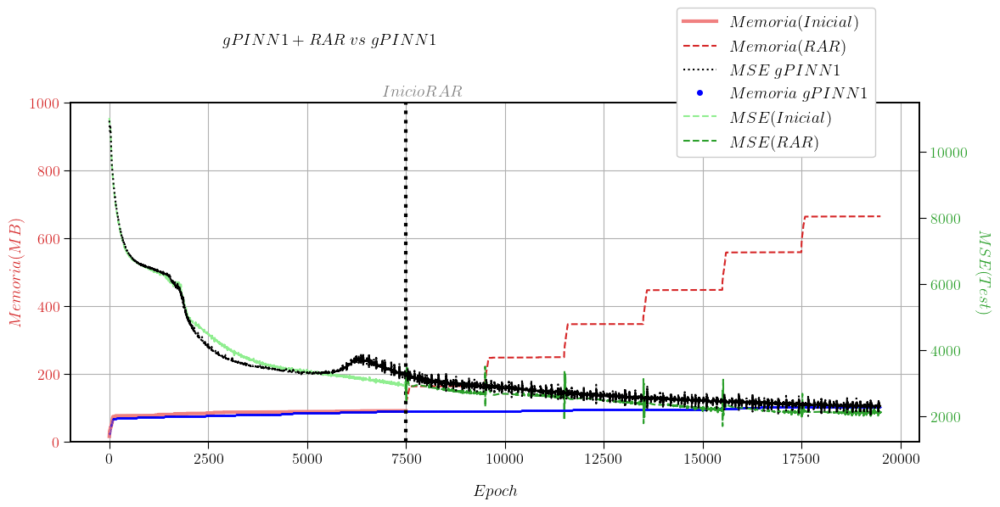

In [ ]:
memoria1 = memorias[:7500]
memoria2 = memorias[7500:]
mse1 = mse[:7500]
mse2 = mse[7500:]


fig, ax1 = plt.subplots(figsize=(8, 6))
plt.suptitle(r"$gPINN 1 + RAR \; vs \; gPINN1$", fontsize=14, y=0.95)

# Eje izquierdo: Memoria RAM.
color1_light = '#f08080'   
color1_dark = 'tab:red' 

ax1.set_xlabel("$Epoch$", labelpad=15)
ax1.set_ylabel("$Memoria (MB)$", color=color1_dark)
ax1.plot(range(len(memoria1)), memoria1, '-', linewidth = 3,color=color1_light, label="$Memoria (Inicial)$")
ax1.plot(range(len(memoria1), len(memoria1)+len(memoria2)), memoria2, "--", color=color1_dark, label="$Memoria (RAR)$")
ax1.plot(range( len(memoria1)+len(memoria2)), memoria_por_epoca, '.', color='b', markersize = 0.1)
memoria_gpinn1_legend = Line2D([0], [0], marker='.', color='b', linestyle='None', 
                               markersize=8, label=r"$Memoria \; gPINN 1$")

ax1.set_ylim(0, 1000)
ax1.tick_params(axis='y', labelcolor=color1_dark)
ax1.grid(True)

# Eje derecho: Métrico de Test (MSE).
color2_light = '#90ee90'   
color2_dark = 'tab:green'  

ax2 = ax1.twinx()
ax2.set_ylabel("$MSE (Test)$", color=color2_dark, rotation=-90, labelpad=20)
ax2.plot(range(len(mse1)), mse1, '--',color=color2_light, label="$MSE (Inicial)$")
ax2.plot(range(len(mse1), len(mse1)+len(mse2)), mse2, '--', color=color2_dark, label="$MSE (RAR)$")
ax2.plot(range( 19500), metrictest[:19500], ':', color='k',label=r"$MSE \; gPINN 1$")
ax2.tick_params(axis='y', labelcolor=color2_dark)

# Línea vertical para marcar inicio de RAR.
rar_start = len(memoria1)
ax1.axvline(x=rar_start, color='black', linestyle=':', linewidth=3)
ax1.text(rar_start-600, ax1.get_ylim()[1]*1.02, "$Inicio RAR$", rotation=0, color='gray')

lines1, labels1 = ax1.get_legend_handles_labels()
lines2, labels2 = ax2.get_legend_handles_labels()
idx_mse_gpinn1 = labels2.index(r"$MSE \; gPINN 1$")

lines_gpin1 = [lines2[idx_mse_gpinn1],memoria_gpinn1_legend]
labels_gpin1 = [r"$MSE \; gPINN 1$", r"$Memoria \; gPINN 1$"]

lines2_rest = lines2[:idx_mse_gpinn1] + lines2[idx_mse_gpinn1+1:]
labels2_rest = labels2[:idx_mse_gpinn1] + labels2[idx_mse_gpinn1+1:]

fig.legend(lines1 + lines_gpin1 + lines2_rest, 
           labels1 + labels_gpin1 + labels2_rest,
           loc="upper left",
           bbox_to_anchor=(1.01, 1),
           borderaxespad=0.,
           prop={'size': 14},
           frameon=True,
           facecolor='white',
           framealpha=1.0)

fig.tight_layout(rect=[0, 0, 1.5, 0.95])
plt.show()


#### Realización de vídeo y gráficas relevantes.

In [ ]:
# Callback para guardar las predicciones cada 100 iteraciones.
class PredictionLogger(dde.callbacks.Callback):
    def __init__(self, model, X, save_every=100):
        super().__init__()
        self.model = model
        self.X = X  
        self.save_every = save_every
        self.predictions = []
        self.steps = []

    def on_epoch_end(self):
        train_state = self.model.train_state
        step = train_state.step
        if step % self.save_every == 0 or step == 1:
            y_pred = np.array(self.model.predict(self.X))
            self.predictions.append(y_pred)
            self.steps.append(step)

In [ ]:
F = 1  # Reescalado.

In [ ]:
# Geometría y tiempo.
geom = dde.geometry.Interval(0, L)
timedomain = dde.geometry.TimeDomain(0, T_max)
geomtime = dde.geometry.GeometryXTime(geom, timedomain)

In [ ]:
# Condición inicial u(x, 0) = f(x).
ic = dde.IC(
    geomtime,
    lambda x: IC(x),
    lambda x, on_initial: on_initial
)

# Condiciones de frontera homogéneas Dirichlet u(0,t) = u(L,t) = 0.
bc1 = dde.DirichletBC(geomtime, lambda x: 100, lambda x, on_boundary: on_boundary and np.isclose(x[0], 0))
bc2 = dde.NeumannBC(geomtime, lambda x: 0, lambda x, on_boundary: on_boundary and np.isclose(x[0], L))

data = dde.data.TimePDE(
    geomtime,
    gPINNedp,
    [bc1, bc2, ic],
    num_domain=1500,
    num_boundary=100,
    num_initial=120,
    solution=u_xt1,
    num_test=10201,
)

# Red neuronal.
layer_size = [2] + [16] * 2 + [1]
activation = "Tanh"
initializer = "Glorot uniform"
net = dde.nn.FNN(layer_size, activation, initializer)
# Modelo.
model = dde.Model(data, net)
# Compilar el modelo.
model.compile("adam", lr=0.01, metrics=["MSE"])
# Entrenar el modelo.
losshistory134, train_state = model.train(iterations=7500,display_every=1)

collocation_points = data.train_x  # Todos los puntos de entrenamiento.

# RAR manual: refinamiento adaptativo.
err = 10000
RAR_threshold = 2800

RAR_history = []  
error_grid = []

# Graficar el error en el dominio.
x_grid = np.linspace(0, L, 500)
t_grid = np.linspace(0, T_max, 500)
X1, T1 = np.meshgrid(x_grid, t_grid)

RAR_points = np.empty((0, 2)) 
stop1=15
stop = 0

while err > RAR_threshold and stop<stop1:
    X = geomtime.random_points(1000)
    y_pred = model.predict(X)
    y_true = u_xt1(X) 
    err = (y_pred - y_true)**2
    
    # Obtener los índices de los 5 puntos con mayor error.
    top10_idx = np.argsort(err.flatten())[-10:]
    x_max_error = X[top10_idx] 

    err = np.mean(err)
    print("Residual medio: %.3e" % err)
    print("\u2795 Añadiendo nuevo punto:", x_max_error)
    data.add_anchors(x_max_error)
    
    RAR_points = np.vstack([RAR_points, x_max_error])  

    RAR_history.append(RAR_points.copy())  
 
    # Error absoluto.
    y_error = np.abs(y_pred - y_true)  
    error_grid.append( griddata(X, y_error.flatten(), (X1, T1), method="cubic"))
    
    model.compile("adam", lr=0.01)
    losshistory1, trainstate= model.train(iterations=2000, disregard_previous_best=False)
    stop+=1

Compiling model...
Building feed-forward neural network...
'build' took 0.029398 s

'compile' took 0.560531 s

Training model...

Step      Train loss                                                      Test loss                                                       Test metric   
0         [1.51e+00, 2.93e-01, 4.14e-01, 9.94e+03, 4.41e-04, 2.01e+04]    [1.53e+00, 2.91e-01, 4.17e-01, 9.94e+03, 4.41e-04, 2.01e+04]    [1.13e+04]    
1         [1.50e+00, 3.52e-01, 6.85e-01, 9.89e+03, 1.59e-04, 2.01e+04]    [1.52e+00, 3.45e-01, 6.80e-01, 9.89e+03, 1.59e-04, 2.01e+04]    [1.13e+04]    
2         [1.51e+00, 4.14e-01, 1.03e+00, 9.84e+03, 1.83e-04, 2.01e+04]    [1.52e+00, 4.02e-01, 1.01e+00, 9.84e+03, 1.83e-04, 2.01e+04]    [1.13e+04]    
3         [1.54e+00, 4.82e-01, 1.45e+00, 9.79e+03, 3.40e-04, 2.01e+04]    [1.54e+00, 4.63e-01, 1.40e+00, 9.79e+03, 3.40e-04, 2.01e+04]    [1.13e+04]    
4         [1.58e+00, 5.53e-01, 1.94e+00, 9.75e+03, 5.89e-04, 2.01e+04]    [1.57e+00, 5.26e-01, 1.85e+00, 

2025-06-29 00:10:03.759476: W tensorflow/c/c_api.cc:305] Operation '{name:'dense_5/bias/Adam_3/Assign' id:66501 op device:{requested: '', assigned: ''} def:{{{node dense_5/bias/Adam_3/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](dense_5/bias/Adam_3, dense_5/bias/Adam_3/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.


Training model...

Step      Train loss                                                      Test loss                                                       Test metric
7500      [1.15e+02, 1.88e+02, 3.36e+02, 3.60e+02, 7.44e+01, 1.31e+04]    [9.97e+01, 1.10e+02, 2.13e+02, 3.60e+02, 7.44e+01, 1.31e+04]    []  
8000      [1.10e+02, 1.86e+02, 3.12e+02, 3.70e+02, 7.53e+01, 1.31e+04]    [9.51e+01, 1.06e+02, 2.08e+02, 3.70e+02, 7.53e+01, 1.31e+04]    []  
9000      [9.80e+01, 1.96e+02, 3.29e+02, 3.90e+02, 7.95e+01, 1.28e+04]    [8.45e+01, 1.09e+02, 2.19e+02, 3.90e+02, 7.95e+01, 1.28e+04]    []  
9500      [8.69e+01, 2.00e+02, 3.37e+02, 3.96e+02, 7.95e+01, 1.27e+04]    [7.43e+01, 1.12e+02, 2.17e+02, 3.96e+02, 7.95e+01, 1.27e+04]    []  

Best model at step 9500:
  train loss: 1.38e+04
  test loss: 1.36e+04
  test metric: []

'train' took 8.300828 s

Residual medio: 3.542e+03
➕ Añadiendo nuevo punto: [[0.8091518  0.04356675]
 [0.6824453  0.0402122 ]
 [1.9686216  0.01051721]
 [1.978041   0.009

2025-06-29 00:10:12.474832: W tensorflow/c/c_api.cc:305] Operation '{name:'dense_5/bias/Adam_5/Assign' id:68406 op device:{requested: '', assigned: ''} def:{{{node dense_5/bias/Adam_5/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](dense_5/bias/Adam_5, dense_5/bias/Adam_5/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.


Training model...

Step      Train loss                                                      Test loss                                                       Test metric
9500      [8.66e+01, 2.02e+02, 3.57e+02, 3.96e+02, 7.95e+01, 1.27e+04]    [7.43e+01, 1.12e+02, 2.17e+02, 3.96e+02, 7.95e+01, 1.27e+04]    []  
10000     [8.14e+01, 1.95e+02, 3.43e+02, 3.98e+02, 7.94e+01, 1.27e+04]    [7.00e+01, 1.07e+02, 2.13e+02, 3.98e+02, 7.94e+01, 1.27e+04]    []  
11000     [9.04e+01, 2.39e+02, 4.77e+02, 4.25e+02, 8.03e+01, 1.25e+04]    [7.98e+01, 1.46e+02, 2.77e+02, 4.25e+02, 8.03e+01, 1.25e+04]    []  
11500     [7.80e+01, 2.33e+02, 4.74e+02, 4.37e+02, 8.03e+01, 1.24e+04]    [6.81e+01, 1.47e+02, 2.56e+02, 4.37e+02, 8.03e+01, 1.24e+04]    []  

Best model at step 11500:
  train loss: 1.37e+04
  test loss: 1.34e+04
  test metric: []

'train' took 8.285812 s

Residual medio: 3.346e+03
➕ Añadiendo nuevo punto: [[3.8968068e-01 1.3782405e-02]
 [7.3391426e-01 5.8528267e-02]
 [8.2084620e-01 5.0062358e-02]

2025-06-29 00:10:21.187955: W tensorflow/c/c_api.cc:305] Operation '{name:'dense_5/bias/Adam_7/Assign' id:70325 op device:{requested: '', assigned: ''} def:{{{node dense_5/bias/Adam_7/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](dense_5/bias/Adam_7, dense_5/bias/Adam_7/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.


Training model...

Step      Train loss                                                      Test loss                                                       Test metric
11500     [7.78e+01, 2.34e+02, 4.92e+02, 4.37e+02, 8.03e+01, 1.24e+04]    [6.81e+01, 1.47e+02, 2.56e+02, 4.37e+02, 8.03e+01, 1.24e+04]    []  
12000     [7.20e+01, 1.95e+02, 3.67e+02, 4.23e+02, 7.86e+01, 1.24e+04]    [6.28e+01, 1.11e+02, 2.14e+02, 4.23e+02, 7.86e+01, 1.24e+04]    []  
13000     [6.45e+01, 2.05e+02, 3.86e+02, 4.41e+02, 7.24e+01, 1.22e+04]    [5.55e+01, 1.21e+02, 2.25e+02, 4.41e+02, 7.24e+01, 1.22e+04]    []  
13500     [6.07e+01, 2.06e+02, 3.79e+02, 4.43e+02, 6.75e+01, 1.21e+04]    [5.18e+01, 1.25e+02, 2.18e+02, 4.43e+02, 6.75e+01, 1.21e+04]    []  

Best model at step 13500:
  train loss: 1.33e+04
  test loss: 1.30e+04
  test metric: []

'train' took 8.391698 s

Residual medio: 3.130e+03
➕ Añadiendo nuevo punto: [[3.9609840e+00 9.9330616e-01]
 [4.7420254e+00 9.8702359e-01]
 [4.4380989e+00 9.9803829e-01]

2025-06-29 00:10:30.005847: W tensorflow/c/c_api.cc:305] Operation '{name:'dense_5/bias/Adam_9/Assign' id:72258 op device:{requested: '', assigned: ''} def:{{{node dense_5/bias/Adam_9/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](dense_5/bias/Adam_9, dense_5/bias/Adam_9/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.


Training model...

Step      Train loss                                                      Test loss                                                       Test metric
13500     [6.08e+01, 2.06e+02, 3.81e+02, 4.43e+02, 6.75e+01, 1.21e+04]    [5.18e+01, 1.25e+02, 2.18e+02, 4.43e+02, 6.75e+01, 1.21e+04]    []  
14000     [6.05e+01, 2.03e+02, 3.69e+02, 4.44e+02, 6.52e+01, 1.21e+04]    [5.16e+01, 1.24e+02, 2.09e+02, 4.44e+02, 6.52e+01, 1.21e+04]    []  
15000     [5.64e+01, 2.14e+02, 3.93e+02, 4.48e+02, 6.25e+01, 1.19e+04]    [4.73e+01, 1.35e+02, 2.27e+02, 4.48e+02, 6.25e+01, 1.19e+04]    []  
15500     [5.63e+01, 2.21e+02, 4.52e+02, 4.46e+02, 5.46e+01, 1.19e+04]    [4.70e+01, 1.45e+02, 2.47e+02, 4.46e+02, 5.46e+01, 1.19e+04]    []  

Best model at step 15000:
  train loss: 1.31e+04
  test loss: 1.29e+04
  test metric: []

'train' took 8.395204 s

Residual medio: 3.273e+03
➕ Añadiendo nuevo punto: [[2.02428842e+00 1.22189960e-02]
 [9.25485611e-01 2.15017982e-02]
 [6.63283944e-01 3.0514676

2025-06-29 00:10:38.844473: W tensorflow/c/c_api.cc:305] Operation '{name:'dense_5/bias/Adam_11/Assign' id:74205 op device:{requested: '', assigned: ''} def:{{{node dense_5/bias/Adam_11/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](dense_5/bias/Adam_11, dense_5/bias/Adam_11/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.


Training model...

Step      Train loss                                                      Test loss                                                       Test metric
15500     [5.61e+01, 2.23e+02, 4.57e+02, 4.46e+02, 5.46e+01, 1.19e+04]    [4.70e+01, 1.45e+02, 2.47e+02, 4.46e+02, 5.46e+01, 1.19e+04]    []  
16000     [5.44e+01, 2.16e+02, 3.94e+02, 4.47e+02, 5.86e+01, 1.19e+04]    [4.55e+01, 1.38e+02, 2.26e+02, 4.47e+02, 5.86e+01, 1.19e+04]    []  
17000     [5.24e+01, 2.26e+02, 4.19e+02, 4.54e+02, 5.36e+01, 1.18e+04]    [4.32e+01, 1.48e+02, 2.47e+02, 4.54e+02, 5.36e+01, 1.18e+04]    []  
17500     [4.81e+01, 2.25e+02, 4.16e+02, 4.52e+02, 5.05e+01, 1.17e+04]    [3.89e+01, 1.50e+02, 2.45e+02, 4.52e+02, 5.05e+01, 1.17e+04]    []  

Best model at step 17500:
  train loss: 1.29e+04
  test loss: 1.27e+04
  test metric: []

'train' took 8.251865 s

Residual medio: 2.829e+03
➕ Añadiendo nuevo punto: [[1.1313180e+00 8.3382201e-04]
 [4.3860966e-01 3.2331742e-02]
 [1.0907890e+00 1.9349631e-02]

2025-06-29 00:10:47.531556: W tensorflow/c/c_api.cc:305] Operation '{name:'dense_5/bias/Adam_13/Assign' id:76166 op device:{requested: '', assigned: ''} def:{{{node dense_5/bias/Adam_13/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](dense_5/bias/Adam_13, dense_5/bias/Adam_13/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.


Training model...

Step      Train loss                                                      Test loss                                                       Test metric
17500     [4.86e+01, 2.27e+02, 4.23e+02, 4.52e+02, 5.05e+01, 1.17e+04]    [3.89e+01, 1.50e+02, 2.45e+02, 4.52e+02, 5.05e+01, 1.17e+04]    []  
18000     [4.80e+01, 2.19e+02, 4.09e+02, 4.46e+02, 4.99e+01, 1.18e+04]    [3.91e+01, 1.43e+02, 2.33e+02, 4.46e+02, 4.99e+01, 1.18e+04]    []  
19000     [4.54e+01, 2.22e+02, 4.32e+02, 4.37e+02, 4.93e+01, 1.16e+04]    [3.66e+01, 1.47e+02, 2.47e+02, 4.37e+02, 4.93e+01, 1.16e+04]    []  
19500     [4.46e+01, 2.14e+02, 4.18e+02, 4.33e+02, 4.66e+01, 1.16e+04]    [3.60e+01, 1.43e+02, 2.38e+02, 4.33e+02, 4.66e+01, 1.16e+04]    []  

Best model at step 19500:
  train loss: 1.28e+04
  test loss: 1.25e+04
  test metric: []

'train' took 8.332433 s

Residual medio: 2.722e+03
➕ Añadiendo nuevo punto: [[1.0095724e+00 3.4323350e-02]
 [2.2668490e+00 1.5101715e-02]
 [4.9339491e-01 3.2813072e-02]

2025-06-29 00:10:56.304246: W tensorflow/c/c_api.cc:305] Operation '{name:'dense_5/bias/Adam_15/Assign' id:78141 op device:{requested: '', assigned: ''} def:{{{node dense_5/bias/Adam_15/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](dense_5/bias/Adam_15, dense_5/bias/Adam_15/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.


Training model...

Step      Train loss                                                      Test loss                                                       Test metric
19500     [4.46e+01, 2.16e+02, 4.20e+02, 4.33e+02, 4.66e+01, 1.16e+04]    [3.60e+01, 1.43e+02, 2.38e+02, 4.33e+02, 4.66e+01, 1.16e+04]    []  
20000     [4.46e+01, 2.15e+02, 4.19e+02, 4.34e+02, 4.60e+01, 1.16e+04]    [3.61e+01, 1.42e+02, 2.28e+02, 4.34e+02, 4.60e+01, 1.16e+04]    []  
21000     [4.10e+01, 2.33e+02, 7.60e+02, 4.32e+02, 4.07e+01, 1.15e+04]    [3.18e+01, 1.55e+02, 3.21e+02, 4.32e+02, 4.07e+01, 1.15e+04]    []  
21500     [4.51e+01, 2.01e+02, 4.48e+02, 4.35e+02, 3.82e+01, 1.14e+04]    [3.66e+01, 1.32e+02, 2.49e+02, 4.35e+02, 3.82e+01, 1.14e+04]    []  

Best model at step 21500:
  train loss: 1.26e+04
  test loss: 1.23e+04
  test metric: []

'train' took 8.463361 s



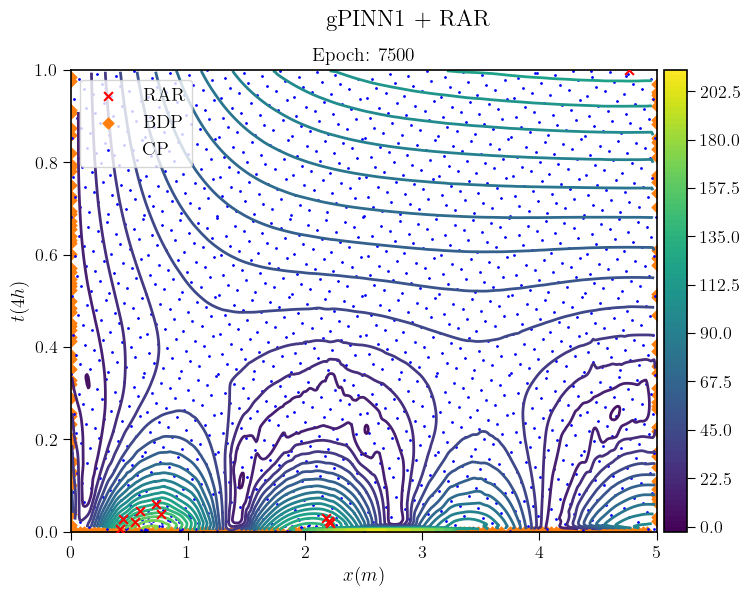

In [ ]:
fig, ax = plt.subplots(figsize=(9, 6))
cont = ax.contourf(X1, T1, error_grid[0], levels=100)
cbar = fig.colorbar(cont, ax=ax, pad=0.01)

# Extraer puntos de collocation, boundary e inicial.
collocation_points = data.train_x   # Todos los puntos de entrenamiento.
boundary_points = data.bc_points()  # Puntos de frontera.

# Convertir ambos a tuplas para poder comparar.
all_points_tuples = set(map(tuple, collocation_points))
boundary_points_tuples = set(map(tuple, boundary_points))

# Collocation points = todos los puntos menos los de frontera/inicial.
collocation_points_tuples = all_points_tuples - boundary_points_tuples
collocation_points = np.array(list(collocation_points_tuples))

def animate(i):
    ax.clear()
    cp = RAR_history[i]

    ax.scatter(cp[:, 0], cp[:, 1], marker="x", c="r", s=40, label="RAR",zorder=3)

    ax.contour(X1, T1, error_grid[i], levels=25, linewidths=2)
    
    ax.scatter(boundary_points[:, 0], boundary_points[:, 1], marker="D", c='tab:orange', s=30, label="BDP")
    
    ax.scatter(collocation_points[:, 0], collocation_points[:, 1], s=4, marker=".", c="b", label="CP")
    
    ax.set_xlabel("$x (m)$")
    ax.set_ylabel("$t (4h)$")
    plt.suptitle("gPINN1 + RAR")
    ax.set_title(f"Epoch: {(i*2000)+7500}")
    ax.legend(loc='upper left')
    ax.set_xlim(0, 5)
    ax.set_ylim(0, 1)

ani = animation.FuncAnimation(fig, animate, frames=len(error_grid), interval=700)
HTML(ani.to_html5_video())

### Modelo más complejo

#### Tiempo de entrenamiento

In [8]:
# Reescalar la solución.
F = 100

In [ ]:
# Geometría y tiempo.
geom = dde.geometry.Interval(0, Lscalado)
timedomain = dde.geometry.TimeDomain(0, T_max)
geomtime = dde.geometry.GeometryXTime(geom, timedomain)

In [ ]:
%%time
# Condición inicial u(x, 0) = f(x).
ic = dde.IC(
    geomtime,
    lambda x: ICreescaladox(x),
    lambda x, on_initial: on_initial
)

# Condiciones de frontera homogéneas Dirichlet u(0,t) = u(L,t) = 0.
bc1 = dde.DirichletBC(geomtime, lambda x: 1, lambda x, on_boundary: on_boundary and np.isclose(x[0], 0))
bc2 = dde.NeumannBC(geomtime, lambda x: 0, lambda x, on_boundary: on_boundary and np.isclose(x[0], Lscalado))

data = dde.data.TimePDE(
    geomtime,
    gPINNedpreescaladox,
    [bc1, bc2, ic],
    num_domain=2500,
    num_boundary=100,
    num_initial=1200,
    solution=u_xt1reescaladox,
    num_test=10201,
)

# Red neuronal.
layer_size = [2] + [32] * 4 + [1]
activation = "Tanh"
initializer = "Glorot uniform"
net = dde.nn.FNN(layer_size, activation, initializer)

# Modelo.
model = dde.Model(data, net)

# Compilar el modelo.
model.compile("adam", lr=0.001, metrics=["MSE"], loss_weights=[2, 1,1,1, 1, 4])
# Entrenar el modelo.
model.train(iterations=7500,display_every=7500)
model.compile("L-BFGS",metrics=["MSE"], loss_weights=[2, 1,1,1, 1, 4])
model.train()

# RAR manual: refinamiento adaptativo.
err = 10100
RAR_threshold = 2100
max_rar_cycles = 25500  # Número máximo de ciclos RAR.
rar_cycle = 7500        # Contador de ciclos.

while rar_cycle < max_rar_cycles:
    X = geomtime.random_points(10000)
    y_pred = model.predict(X)
    y_true = u_xt1reescaladox(X)  
    err = (y_pred - y_true)**2
    
    # Obtener los índices de los 5 puntos con mayor error.
    top10_idx = np.argsort(err.flatten())[-10:]
    x_max_error = X[top10_idx]  

    err = np.mean(err)*F**2
    print("Residual medio: %.3e" % err)
    data.add_anchors(x_max_error)
    
    model.compile("adam", lr=0.001, metrics=["MSE"], loss_weights=[2, 1,1,1, 1, 4])
    # Entrenar el modelo.
    model.train(iterations=2000, disregard_previous_best=False)
    model.compile("L-BFGS",metrics=["MSE"], loss_weights=[2, 1, 1,1, 1, 4])
    losshistory5, train_state = model.train()

    rar_cycle += 2000

if rar_cycle == max_rar_cycles:
    print("Se alcanzó el número máximo de ciclos RAR.")
else:
    print("Se alcanzó el umbral de error deseado.")


Compiling model...
Building feed-forward neural network...
'build' took 0.030014 s

'compile' took 0.577719 s

Training model...

Step      Train loss                                                      Test loss                                                       Test metric   
0         [2.40e-01, 2.61e-03, 3.47e-02, 7.69e-01, 1.16e-01, 7.61e+00]    [2.09e-01, 3.34e-03, 4.59e-02, 7.69e-01, 1.16e-01, 7.61e+00]    [9.58e-01]    
7500      [6.96e-04, 7.17e-03, 5.20e-02, 1.46e-03, 7.59e-04, 9.24e-03]    [5.98e-04, 3.69e-03, 1.72e-02, 1.46e-03, 7.59e-04, 9.24e-03]    [2.74e-01]    

Best model at step 7500:
  train loss: 7.13e-02
  test loss: 3.29e-02
  test metric: [2.74e-01]

'train' took 275.928714 s

Compiling model...
'compile' took 0.263574 s

Training model...

Step      Train loss                                                      Test loss                                                       Test metric   
7500      [6.96e-04, 7.17e-03, 5.20e-02, 1.46e-03, 7.59e-04, 9.24e-0

2025-06-27 23:06:06.021694: W tensorflow/c/c_api.cc:305] Operation '{name:'dense_9/bias/Adam_3/Assign' id:11048 op device:{requested: '', assigned: ''} def:{{{node dense_9/bias/Adam_3/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](dense_9/bias/Adam_3, dense_9/bias/Adam_3/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.


Training model...

Step      Train loss                                                      Test loss                                                       Test metric   
7516      [6.97e-04, 7.17e-03, 5.19e-02, 1.46e-03, 7.59e-04, 9.24e-03]    [5.98e-04, 3.69e-03, 1.72e-02, 1.46e-03, 7.59e-04, 9.24e-03]    [2.74e-01]    
8000      [2.45e-04, 5.95e-03, 8.16e-03, 1.45e-03, 5.25e-04, 6.62e-03]    [2.28e-04, 3.30e-03, 1.08e-02, 1.45e-03, 5.25e-04, 6.62e-03]    [2.73e-01]    
9000      [2.04e-04, 5.35e-03, 7.17e-03, 7.81e-04, 4.72e-04, 5.04e-03]    [1.82e-04, 3.03e-03, 9.05e-03, 7.81e-04, 4.72e-04, 5.04e-03]    [2.74e-01]    
9516      [1.84e-04, 4.96e-03, 6.68e-03, 6.71e-04, 4.50e-04, 4.56e-03]    [1.69e-04, 2.82e-03, 8.21e-03, 6.71e-04, 4.50e-04, 4.56e-03]    [2.74e-01]    

Best model at step 9516:
  train loss: 1.75e-02
  test loss: 1.69e-02
  test metric: [2.74e-01]

'train' took 77.906605 s

Compiling model...
'compile' took 0.276592 s

Training model...

Step      Train loss       

2025-06-27 23:07:25.938261: W tensorflow/c/c_api.cc:305] Operation '{name:'dense_9/bias/Adam_5/Assign' id:15135 op device:{requested: '', assigned: ''} def:{{{node dense_9/bias/Adam_5/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](dense_9/bias/Adam_5, dense_9/bias/Adam_5/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.


Training model...

Step      Train loss                                                      Test loss                                                       Test metric   
9532      [1.86e-04, 4.95e-03, 6.67e-03, 6.71e-04, 4.50e-04, 4.56e-03]    [1.69e-04, 2.82e-03, 8.21e-03, 6.71e-04, 4.50e-04, 4.56e-03]    [2.74e-01]    
10000     [1.84e-04, 5.02e-03, 6.44e-03, 7.31e-04, 4.22e-04, 4.53e-03]    [1.57e-04, 2.82e-03, 8.18e-03, 7.31e-04, 4.22e-04, 4.53e-03]    [2.74e-01]    
11000     [4.94e-04, 4.74e-03, 3.63e-02, 6.03e-04, 6.46e-04, 5.03e-03]    [2.21e-04, 2.53e-03, 1.06e-02, 6.03e-04, 6.46e-04, 5.03e-03]    [2.74e-01]    
11532     [6.67e-04, 5.17e-03, 4.69e-02, 5.79e-04, 6.09e-04, 4.44e-03]    [1.54e-04, 2.31e-03, 1.21e-02, 5.79e-04, 6.09e-04, 4.44e-03]    [2.72e-01]    

Best model at step 10000:
  train loss: 1.73e-02
  test loss: 1.68e-02
  test metric: [2.74e-01]

'train' took 78.331837 s

Compiling model...
'compile' took 0.291122 s

Training model...

Step      Train loss      

2025-06-27 23:08:46.468169: W tensorflow/c/c_api.cc:305] Operation '{name:'dense_9/bias/Adam_7/Assign' id:19266 op device:{requested: '', assigned: ''} def:{{{node dense_9/bias/Adam_7/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](dense_9/bias/Adam_7, dense_9/bias/Adam_7/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.


Training model...

Step      Train loss                                                      Test loss                                                       Test metric   
11549     [6.66e-04, 5.17e-03, 4.68e-02, 5.79e-04, 6.09e-04, 4.44e-03]    [1.54e-04, 2.31e-03, 1.21e-02, 5.79e-04, 6.09e-04, 4.44e-03]    [2.72e-01]    
12000     [1.10e-04, 3.79e-03, 5.01e-03, 6.55e-04, 4.79e-04, 4.24e-03]    [9.86e-05, 2.13e-03, 6.76e-03, 6.55e-04, 4.79e-04, 4.24e-03]    [2.75e-01]    
13000     [8.61e-04, 5.35e-03, 5.99e-02, 4.88e-04, 6.83e-04, 6.34e-03]    [1.77e-04, 2.19e-03, 1.28e-02, 4.88e-04, 6.83e-04, 6.34e-03]    [2.74e-01]    
13549     [1.03e-04, 3.31e-03, 5.37e-03, 4.83e-04, 3.96e-04, 4.64e-03]    [6.57e-05, 1.87e-03, 5.23e-03, 4.83e-04, 3.96e-04, 4.64e-03]    [2.76e-01]    

Best model at step 12000:
  train loss: 1.43e-02
  test loss: 1.44e-02
  test metric: [2.75e-01]

'train' took 85.144772 s

Compiling model...
'compile' took 0.299135 s

Training model...

Step      Train loss      

2025-06-27 23:10:14.075028: W tensorflow/c/c_api.cc:305] Operation '{name:'dense_9/bias/Adam_9/Assign' id:23441 op device:{requested: '', assigned: ''} def:{{{node dense_9/bias/Adam_9/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](dense_9/bias/Adam_9, dense_9/bias/Adam_9/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.


Training model...

Step      Train loss                                                      Test loss                                                       Test metric   
13566     [1.04e-04, 3.30e-03, 5.36e-03, 4.83e-04, 3.96e-04, 4.64e-03]    [6.57e-05, 1.87e-03, 5.23e-03, 4.83e-04, 3.96e-04, 4.64e-03]    [2.76e-01]    
14000     [8.23e-05, 3.46e-03, 4.08e-03, 4.56e-04, 4.02e-04, 3.50e-03]    [6.86e-05, 1.89e-03, 5.42e-03, 4.56e-04, 4.02e-04, 3.50e-03]    [2.76e-01]    
15000     [7.60e-05, 2.96e-03, 3.83e-03, 3.82e-04, 4.13e-04, 3.39e-03]    [6.35e-05, 1.64e-03, 5.03e-03, 3.82e-04, 4.13e-04, 3.39e-03]    [2.75e-01]    
15566     [4.62e-04, 3.69e-03, 3.90e-02, 4.94e-04, 3.86e-04, 4.88e-03]    [9.81e-05, 1.60e-03, 8.39e-03, 4.94e-04, 3.86e-04, 4.88e-03]    [2.71e-01]    

Best model at step 15000:
  train loss: 1.11e-02
  test loss: 1.09e-02
  test metric: [2.75e-01]

'train' took 85.435979 s

Compiling model...
'compile' took 0.323872 s

Training model...

Step      Train loss      

2025-06-27 23:11:42.321920: W tensorflow/c/c_api.cc:305] Operation '{name:'dense_9/bias/Adam_11/Assign' id:27660 op device:{requested: '', assigned: ''} def:{{{node dense_9/bias/Adam_11/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](dense_9/bias/Adam_11, dense_9/bias/Adam_11/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.


Training model...

Step      Train loss                                                      Test loss                                                       Test metric   
15583     [4.61e-04, 3.68e-03, 3.89e-02, 4.94e-04, 3.86e-04, 4.88e-03]    [9.81e-05, 1.60e-03, 8.39e-03, 4.94e-04, 3.86e-04, 4.88e-03]    [2.71e-01]    
16000     [1.17e-04, 2.90e-03, 6.89e-03, 6.20e-04, 5.17e-04, 3.93e-03]    [7.62e-05, 1.50e-03, 5.59e-03, 6.20e-04, 5.17e-04, 3.93e-03]    [2.75e-01]    
17000     [5.55e-04, 3.68e-03, 4.93e-02, 5.45e-04, 9.51e-04, 1.07e-02]    [1.56e-04, 1.61e-03, 9.15e-03, 5.45e-04, 9.51e-04, 1.07e-02]    [2.74e-01]    
17583     [3.47e-04, 3.27e-03, 2.61e-02, 3.94e-04, 6.43e-04, 3.07e-03]    [1.03e-04, 1.43e-03, 6.83e-03, 3.94e-04, 6.43e-04, 3.07e-03]    [2.75e-01]    

Best model at step 15000:
  train loss: 1.11e-02
  test loss: 1.09e-02
  test metric: [2.75e-01]

'train' took 91.465939 s

Compiling model...
'compile' took 0.335198 s

Training model...

Step      Train loss      

2025-06-27 23:13:16.888019: W tensorflow/c/c_api.cc:305] Operation '{name:'dense_9/bias/Adam_13/Assign' id:31923 op device:{requested: '', assigned: ''} def:{{{node dense_9/bias/Adam_13/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](dense_9/bias/Adam_13, dense_9/bias/Adam_13/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.


Training model...

Step      Train loss                                                      Test loss                                                       Test metric   
17602     [3.47e-04, 3.26e-03, 2.60e-02, 3.94e-04, 6.43e-04, 3.07e-03]    [1.03e-04, 1.43e-03, 6.83e-03, 3.94e-04, 6.43e-04, 3.07e-03]    [2.75e-01]    
18000     [5.90e-05, 2.65e-03, 3.24e-03, 5.23e-04, 3.33e-04, 3.42e-03]    [5.00e-05, 1.38e-03, 4.37e-03, 5.23e-04, 3.33e-04, 3.42e-03]    [2.77e-01]    
19000     [5.34e-05, 2.29e-03, 3.08e-03, 3.10e-04, 4.10e-04, 3.09e-03]    [3.95e-05, 1.22e-03, 3.87e-03, 3.10e-04, 4.10e-04, 3.09e-03]    [2.76e-01]    
19602     [1.73e-04, 2.63e-03, 1.23e-02, 3.43e-04, 3.86e-04, 3.66e-03]    [6.09e-05, 1.20e-03, 4.73e-03, 3.43e-04, 3.86e-04, 3.66e-03]    [2.74e-01]    

Best model at step 19000:
  train loss: 9.23e-03
  test loss: 8.94e-03
  test metric: [2.76e-01]

'train' took 89.693774 s

Compiling model...
'compile' took 0.345885 s

Training model...

Step      Train loss      

2025-06-27 23:14:49.713745: W tensorflow/c/c_api.cc:305] Operation '{name:'dense_9/bias/Adam_15/Assign' id:36230 op device:{requested: '', assigned: ''} def:{{{node dense_9/bias/Adam_15/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](dense_9/bias/Adam_15, dense_9/bias/Adam_15/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.


Training model...

Step      Train loss                                                      Test loss                                                       Test metric   
19618     [1.73e-04, 2.62e-03, 1.23e-02, 3.43e-04, 3.86e-04, 3.66e-03]    [6.09e-05, 1.20e-03, 4.73e-03, 3.43e-04, 3.86e-04, 3.66e-03]    [2.74e-01]    
20000     [5.16e-05, 2.09e-03, 2.72e-03, 4.37e-04, 4.01e-04, 3.54e-03]    [4.42e-05, 1.09e-03, 3.78e-03, 4.37e-04, 4.01e-04, 3.54e-03]    [2.75e-01]    
21000     [4.06e-05, 1.96e-03, 2.89e-03, 3.66e-04, 3.64e-04, 3.32e-03]    [3.66e-05, 1.05e-03, 3.47e-03, 3.66e-04, 3.64e-04, 3.32e-03]    [2.77e-01]    
21618     [9.98e-04, 4.37e-03, 7.22e-02, 4.33e-04, 3.99e-04, 4.91e-03]    [1.68e-04, 1.37e-03, 1.25e-02, 4.33e-04, 3.99e-04, 4.91e-03]    [2.70e-01]    

Best model at step 21000:
  train loss: 8.94e-03
  test loss: 8.61e-03
  test metric: [2.77e-01]

'train' took 83.970705 s

Compiling model...
'compile' took 0.348381 s

Training model...

Step      Train loss      

2025-06-27 23:16:17.013041: W tensorflow/c/c_api.cc:305] Operation '{name:'dense_9/bias/Adam_17/Assign' id:40581 op device:{requested: '', assigned: ''} def:{{{node dense_9/bias/Adam_17/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](dense_9/bias/Adam_17, dense_9/bias/Adam_17/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.


Training model...

Step      Train loss                                                      Test loss                                                       Test metric   
21634     [9.95e-04, 4.37e-03, 7.20e-02, 4.33e-04, 3.99e-04, 4.91e-03]    [1.68e-04, 1.37e-03, 1.25e-02, 4.33e-04, 3.99e-04, 4.91e-03]    [2.70e-01]    
22000     [4.96e-05, 1.86e-03, 2.75e-03, 5.26e-04, 3.95e-04, 3.61e-03]    [4.57e-05, 9.51e-04, 3.83e-03, 5.26e-04, 3.95e-04, 3.61e-03]    [2.75e-01]    
23000     [6.58e-04, 3.12e-03, 4.47e-02, 3.27e-04, 8.92e-04, 4.46e-03]    [1.33e-04, 1.12e-03, 8.61e-03, 3.27e-04, 8.92e-04, 4.46e-03]    [2.75e-01]    
23634     [6.63e-05, 1.84e-03, 3.45e-03, 3.42e-04, 3.37e-04, 3.01e-03]    [3.77e-05, 9.09e-04, 3.23e-03, 3.42e-04, 3.37e-04, 3.01e-03]    [2.76e-01]    

Best model at step 21000:
  train loss: 8.94e-03
  test loss: 8.61e-03
  test metric: [2.77e-01]

'train' took 83.406588 s

Compiling model...
'compile' took 0.367659 s

Training model...

Step      Train loss      

2025-06-27 23:17:43.951303: W tensorflow/c/c_api.cc:305] Operation '{name:'dense_9/bias/Adam_19/Assign' id:44976 op device:{requested: '', assigned: ''} def:{{{node dense_9/bias/Adam_19/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](dense_9/bias/Adam_19, dense_9/bias/Adam_19/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.


Training model...

Step      Train loss                                                      Test loss                                                       Test metric   
23650     [6.63e-05, 1.83e-03, 3.44e-03, 3.42e-04, 3.37e-04, 3.01e-03]    [3.77e-05, 9.09e-04, 3.23e-03, 3.42e-04, 3.37e-04, 3.01e-03]    [2.76e-01]    
24000     [3.63e-05, 1.89e-03, 2.17e-03, 4.12e-04, 3.32e-04, 3.17e-03]    [2.94e-05, 9.33e-04, 2.93e-03, 4.12e-04, 3.32e-04, 3.17e-03]    [2.77e-01]    
25000     [2.10e-03, 5.48e-03, 2.09e-01, 3.81e-04, 3.70e-04, 3.38e-03]    [4.06e-04, 1.85e-03, 2.93e-02, 3.81e-04, 3.70e-04, 3.38e-03]    [2.84e-01]    
25650     [4.94e-05, 1.57e-03, 2.89e-03, 3.06e-04, 3.48e-04, 3.17e-03]    [2.89e-05, 7.78e-04, 2.83e-03, 3.06e-04, 3.48e-04, 3.17e-03]    [2.76e-01]    

Best model at step 24000:
  train loss: 8.01e-03
  test loss: 7.81e-03
  test metric: [2.77e-01]

'train' took 81.142802 s

Compiling model...
'compile' took 0.384168 s

Training model...

Step      Train loss      

#### Consumo de memoria

In [ ]:
class MemoryCallback(dde.callbacks.Callback):
    def __init__(self):
        super().__init__()  
        self.process = psutil.Process()
        self.memory_per_epoch = []
        self.mem_init = None

        
    def on_train_begin(self):
        # Guardar memoria inicial al comenzar.
        self.mem_init = self.process.memory_info().rss / (1024 * 1024)

    def on_epoch_end(self):
        mem = self.process.memory_info().rss / (1024 * 1024)  # MB.
        self.memory_per_epoch.append(mem)

    def get_memory(self):
        return self.memory_per_epoch

In [ ]:
# Condición inicial u(x, 0) = f(x).
ic = dde.IC(
    geomtime,
    lambda x: ICreescaladox(x),
    lambda x, on_initial: on_initial
)

# Condiciones de frontera homogéneas Dirichlet u(0,t) = u(L,t) = 0.
bc1 = dde.DirichletBC(geomtime, lambda x: 1, lambda x, on_boundary: on_boundary and np.isclose(x[0], 0))
bc2 = dde.NeumannBC(geomtime, lambda x: 0, lambda x, on_boundary: on_boundary and np.isclose(x[0], Lscalado))

data = dde.data.TimePDE(
    geomtime,
    gPINNedpreescaladox,
    [bc1, bc2, ic],
    num_domain=2500,
    num_boundary=100,
    num_initial=1200,
    solution=u_xt1reescaladox,
    num_test=10201,
)

# Red neuronal.
layer_size = [2] + [32] * 4 + [1]
activation = "Tanh"
initializer = "Glorot uniform"
net = dde.nn.FNN(layer_size, activation, initializer)

# Modelo.
model = dde.Model(data, net)

# Compilar el modelo.
model.compile("adam", lr=0.001, metrics=["MSE"], loss_weights=[2, 1,1,1, 1, 4])
# Entrenar el modelo.
mem_cb = MemoryCallback()
mem_cb1 = MemoryCallback()
model.train(iterations=7500,display_every=1, callbacks=[mem_cb])
model.compile("L-BFGS",metrics=["MSE"], loss_weights=[2, 1,1,1, 1, 4])
model.train()
memoria_por_epoca1 = mem_cb.get_memory()
memoriaini = mem_cb.mem_init

# RAR manual: refinamiento adaptativo.
err = 10100
RAR_threshold = 2800
rar_cycle = 0        # Contador de ciclos.
max_rar_cycles = 10  # Número máximo de ciclos RAR.

while err > RAR_threshold and rar_cycle < max_rar_cycles:
    X = geomtime.random_points(10000)
    y_pred = model.predict(X)
    y_true = u_xt1reescaladox(X) 
    err = (y_pred - y_true)**2
    
    # Obtener los índices de los 5 puntos con mayor error.
    top10_idx = np.argsort(err.flatten())[-10:]
    x_max_error = X[top10_idx] 

    err = np.mean(err)*F**2
    print("Residual medio: %.3e" % err)
    data.add_anchors(x_max_error)
    
    model.compile("adam", lr=0.001, metrics=["MSE"], loss_weights=[2, 1,1,1, 1, 4])
    # Entrenar el modelo.
    model.train(iterations=2000, display_every=1,disregard_previous_best=False, callbacks=[mem_cb1])
    model.compile("L-BFGS",metrics=["MSE"], loss_weights=[2, 1, 1,1, 1, 4])
    losshistory5, train_state = model.train()
    rar_cycle += 1

if rar_cycle == max_rar_cycles:
    print("Se alcanzó el número máximo de ciclos RAR.")
else:
    print("Se alcanzó el umbral de error deseado.")
memooo = mem_cb1.get_memory()

Compiling model...
Building feed-forward neural network...
'build' took 0.034270 s

'compile' took 0.448271 s

Training model...

Step      Train loss                                                      Test loss                                                       Test metric   
0         [1.37e-01, 5.86e-03, 1.77e-03, 1.03e+00, 1.57e-01, 9.12e+00]    [1.42e-01, 6.31e-03, 1.46e-03, 1.03e+00, 1.57e-01, 9.12e+00]    [1.73e+00]    


I0000 00:00:1751045527.319604  151081 mlir_graph_optimization_pass.cc:425] MLIR V1 optimization pass is not enabled


1         [3.95e-02, 2.79e-03, 3.29e-03, 1.07e+00, 8.29e-02, 8.60e+00]    [4.40e-02, 3.03e-03, 3.40e-03, 1.07e+00, 8.29e-02, 8.60e+00]    [1.54e+00]    
2         [5.25e-03, 8.55e-04, 6.15e-03, 1.10e+00, 3.22e-02, 8.20e+00]    [5.42e-03, 9.48e-04, 7.22e-03, 1.10e+00, 3.22e-02, 8.20e+00]    [1.38e+00]    
3         [2.45e-02, 5.36e-05, 1.02e-02, 1.12e+00, 5.38e-03, 7.94e+00]    [1.75e-02, 6.15e-05, 1.26e-02, 1.12e+00, 5.38e-03, 7.94e+00]    [1.25e+00]    
4         [7.74e-02, 2.85e-04, 1.50e-02, 1.11e+00, 1.28e-03, 7.77e+00]    [6.18e-02, 2.65e-04, 1.90e-02, 1.11e+00, 1.28e-03, 7.77e+00]    [1.14e+00]    
5         [1.42e-01, 1.32e-03, 2.01e-02, 1.07e+00, 1.62e-02, 7.68e+00]    [1.17e-01, 1.32e-03, 2.57e-02, 1.07e+00, 1.62e-02, 7.68e+00]    [1.07e+00]    
6         [2.00e-01, 2.82e-03, 2.45e-02, 1.02e+00, 4.32e-02, 7.63e+00]    [1.69e-01, 2.88e-03, 3.15e-02, 1.02e+00, 4.32e-02, 7.63e+00]    [1.01e+00]    
7         [2.40e-01, 4.40e-03, 2.76e-02, 9.60e-01, 7.42e-02, 7.61e+00]    [2.04e-0

2025-06-27 19:44:04.059874: W tensorflow/c/c_api.cc:305] Operation '{name:'dense_4/bias/Adam_3/Assign' id:6487 op device:{requested: '', assigned: ''} def:{{{node dense_4/bias/Adam_3/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](dense_4/bias/Adam_3, dense_4/bias/Adam_3/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.


Training model...

Step      Train loss                                                      Test loss                                                       Test metric   
7516      [5.77e-04, 1.09e-02, 2.20e-02, 7.87e-03, 7.06e-03, 2.66e-02]    [6.59e-04, 6.46e-03, 1.91e-02, 7.87e-03, 7.06e-03, 2.66e-02]    [2.72e-01]    
7517      [5.05e-01, 6.10e-01, 6.31e+01, 1.14e-02, 5.28e-02, 9.76e-02]    [1.09e-01, 1.13e-01, 8.82e+00, 1.14e-02, 5.28e-02, 9.76e-02]    [2.08e-01]    
7518      [2.96e-02, 4.19e-02, 4.29e+00, 9.12e-03, 1.06e-02, 3.14e-02]    [6.59e-03, 1.06e-02, 5.65e-01, 9.12e-03, 1.06e-02, 3.14e-02]    [2.59e-01]    
7519      [1.13e-01, 1.44e-01, 1.36e+01, 9.46e-03, 1.42e-02, 4.31e-02]    [2.77e-02, 3.59e-02, 1.99e+00, 9.46e-03, 1.42e-02, 4.31e-02]    [3.22e-01]    
7520      [2.67e-01, 2.66e-01, 3.49e+01, 9.19e-03, 2.30e-02, 7.27e-02]    [6.84e-02, 6.14e-02, 4.96e+00, 9.19e-03, 2.30e-02, 7.27e-02]    [3.56e-01]    
7521      [1.94e-01, 1.62e-01, 2.65e+01, 7.77e-03, 1.46e-02, 6.

2025-06-27 19:47:08.235803: W tensorflow/c/c_api.cc:305] Operation '{name:'dense_4/bias/Adam_5/Assign' id:10394 op device:{requested: '', assigned: ''} def:{{{node dense_4/bias/Adam_5/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](dense_4/bias/Adam_5, dense_4/bias/Adam_5/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.


Training model...

Step      Train loss                                                      Test loss                                                       Test metric   
9534      [3.20e-04, 8.36e-03, 1.41e-02, 5.89e-03, 4.57e-03, 1.66e-02]    [3.39e-04, 4.98e-03, 1.45e-02, 5.89e-03, 4.57e-03, 1.66e-02]    [2.76e-01]    
9535      [3.39e-01, 3.72e-01, 4.36e+01, 8.63e-03, 5.25e-02, 3.78e-02]    [5.38e-02, 4.84e-02, 4.68e+00, 8.63e-03, 5.25e-02, 3.78e-02]    [2.64e-01]    
9536      [2.63e-02, 4.88e-02, 3.56e+00, 7.00e-03, 7.68e-03, 2.08e-02]    [3.58e-03, 9.52e-03, 3.82e-01, 7.00e-03, 7.68e-03, 2.08e-02]    [2.86e-01]    
9537      [7.97e-02, 1.19e-01, 8.97e+00, 7.01e-03, 1.75e-02, 2.42e-02]    [1.54e-02, 2.36e-02, 1.06e+00, 7.01e-03, 1.75e-02, 2.42e-02]    [3.01e-01]    
9538      [2.04e-01, 2.56e-01, 2.34e+01, 7.91e-03, 4.86e-02, 2.85e-02]    [3.94e-02, 5.07e-02, 2.77e+00, 7.91e-03, 4.86e-02, 2.85e-02]    [3.11e-01]    
9539      [1.55e-01, 1.83e-01, 1.82e+01, 8.27e-03, 4.28e-02, 2.

2025-06-27 19:49:53.375746: W tensorflow/c/c_api.cc:305] Operation '{name:'dense_4/bias/Adam_7/Assign' id:14345 op device:{requested: '', assigned: ''} def:{{{node dense_4/bias/Adam_7/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](dense_4/bias/Adam_7, dense_4/bias/Adam_7/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.


Training model...

Step      Train loss                                                      Test loss                                                       Test metric   
11550     [5.37e-04, 6.32e-03, 3.16e-02, 5.80e-03, 3.08e-03, 1.54e-02]    [3.38e-04, 3.69e-03, 1.33e-02, 5.80e-03, 3.08e-03, 1.54e-02]    [2.78e-01]    
11551     [4.99e-01, 5.32e-01, 4.62e+01, 1.60e-02, 1.48e-01, 1.05e-01]    [1.73e-01, 1.22e-01, 7.32e+00, 1.60e-02, 1.48e-01, 1.05e-01]    [3.33e-01]    
11552     [4.42e-02, 5.99e-02, 3.34e+00, 7.18e-03, 2.28e-02, 2.15e-02]    [1.59e-02, 1.50e-02, 5.37e-01, 7.18e-03, 2.28e-02, 2.15e-02]    [2.80e-01]    
11553     [9.79e-02, 1.17e-01, 9.79e+00, 6.73e-03, 2.50e-02, 3.51e-02]    [3.18e-02, 2.82e-02, 1.49e+00, 6.73e-03, 2.50e-02, 3.51e-02]    [2.51e-01]    
11554     [2.80e-01, 3.22e-01, 2.52e+01, 9.29e-03, 8.70e-02, 7.06e-02]    [9.54e-02, 7.33e-02, 3.84e+00, 9.29e-03, 8.70e-02, 7.06e-02]    [2.52e-01]    
11555     [2.27e-01, 2.58e-01, 1.86e+01, 8.89e-03, 7.26e-02, 6.

2025-06-27 19:52:58.025612: W tensorflow/c/c_api.cc:305] Operation '{name:'dense_4/bias/Adam_9/Assign' id:18340 op device:{requested: '', assigned: ''} def:{{{node dense_4/bias/Adam_9/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](dense_4/bias/Adam_9, dense_4/bias/Adam_9/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.


Training model...

Step      Train loss                                                      Test loss                                                       Test metric   
13567     [2.92e-03, 1.15e-02, 2.30e-01, 4.15e-03, 2.94e-03, 9.10e-03]    [4.25e-04, 3.65e-03, 3.70e-02, 4.15e-03, 2.94e-03, 9.10e-03]    [2.78e-01]    
13568     [4.24e-01, 7.15e-01, 3.81e+01, 7.71e-03, 7.60e-02, 3.84e-02]    [5.11e-02, 8.12e-02, 4.86e+00, 7.71e-03, 7.60e-02, 3.84e-02]    [3.40e-01]    
13569     [3.85e-02, 8.34e-02, 3.54e+00, 7.73e-03, 2.26e-02, 1.43e-02]    [1.16e-02, 1.42e-02, 4.18e-01, 7.73e-03, 2.26e-02, 1.43e-02]    [3.29e-01]    
13570     [9.75e-02, 1.78e-01, 7.91e+00, 5.49e-03, 2.73e-02, 9.68e-03]    [1.58e-02, 2.18e-02, 1.11e+00, 5.49e-03, 2.73e-02, 9.68e-03]    [3.01e-01]    
13571     [2.45e-01, 4.71e-01, 1.93e+01, 3.32e-03, 4.88e-02, 1.23e-02]    [2.73e-02, 5.03e-02, 2.51e+00, 3.32e-03, 4.88e-02, 1.23e-02]    [2.71e-01]    
13572     [1.93e-01, 3.95e-01, 1.54e+01, 3.32e-03, 3.81e-02, 1.

2025-06-27 19:55:51.751069: W tensorflow/c/c_api.cc:305] Operation '{name:'dense_4/bias/Adam_11/Assign' id:22379 op device:{requested: '', assigned: ''} def:{{{node dense_4/bias/Adam_11/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](dense_4/bias/Adam_11, dense_4/bias/Adam_11/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.


Training model...

Step      Train loss                                                      Test loss                                                       Test metric   
15583     [1.15e-04, 4.90e-03, 9.13e-03, 3.70e-03, 1.88e-03, 7.95e-03]    [1.35e-04, 2.62e-03, 7.76e-03, 3.70e-03, 1.88e-03, 7.95e-03]    [2.78e-01]    
15584     [5.04e-01, 7.70e-01, 4.68e+01, 7.05e-03, 1.06e-01, 6.79e-02]    [9.85e-02, 9.88e-02, 7.30e+00, 7.05e-03, 1.06e-01, 6.79e-02]    [2.25e-01]    
15585     [2.91e-02, 4.10e-02, 3.15e+00, 4.51e-03, 6.10e-03, 1.12e-02]    [6.11e-03, 8.25e-03, 4.81e-01, 4.51e-03, 6.10e-03, 1.12e-02]    [2.66e-01]    
15586     [1.16e-01, 1.87e-01, 9.96e+00, 4.28e-03, 2.97e-02, 2.45e-02]    [2.38e-02, 2.51e-02, 1.56e+00, 4.28e-03, 2.97e-02, 2.45e-02]    [3.11e-01]    
15587     [2.63e-01, 3.63e-01, 2.62e+01, 5.33e-03, 5.96e-02, 4.45e-02]    [6.01e-02, 5.24e-02, 3.99e+00, 5.33e-03, 5.96e-02, 4.45e-02]    [3.27e-01]    
15588     [1.79e-01, 2.28e-01, 1.99e+01, 5.63e-03, 4.35e-02, 3.

2025-06-27 19:58:51.297830: W tensorflow/c/c_api.cc:305] Operation '{name:'dense_4/bias/Adam_13/Assign' id:26462 op device:{requested: '', assigned: ''} def:{{{node dense_4/bias/Adam_13/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](dense_4/bias/Adam_13, dense_4/bias/Adam_13/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.


Training model...

Step      Train loss                                                      Test loss                                                       Test metric   
17599     [1.16e-04, 4.63e-03, 7.51e-03, 3.34e-03, 1.60e-03, 7.14e-03]    [9.59e-05, 2.41e-03, 6.33e-03, 3.34e-03, 1.60e-03, 7.14e-03]    [2.78e-01]    
17600     [4.11e-01, 7.54e-01, 3.84e+01, 8.15e-03, 1.47e-01, 6.20e-02]    [7.26e-02, 1.07e-01, 4.50e+00, 8.15e-03, 1.47e-01, 6.20e-02]    [2.55e-01]    
17601     [3.17e-02, 8.13e-02, 2.73e+00, 3.38e-03, 2.26e-02, 1.60e-02]    [5.97e-03, 1.42e-02, 3.14e-01, 3.38e-03, 2.26e-02, 1.60e-02]    [2.75e-01]    
17602     [9.22e-02, 1.69e-01, 7.71e+00, 4.60e-03, 2.03e-02, 1.08e-02]    [1.68e-02, 2.26e-02, 1.02e+00, 4.60e-03, 2.03e-02, 1.08e-02]    [2.95e-01]    
17603     [2.53e-01, 4.84e-01, 2.02e+01, 5.58e-03, 8.35e-02, 2.94e-02]    [5.04e-02, 6.13e-02, 2.53e+00, 5.58e-03, 8.35e-02, 2.94e-02]    [3.01e-01]    
17604     [2.16e-01, 4.37e-01, 1.65e+01, 4.31e-03, 6.84e-02, 3.

2025-06-27 20:01:49.800852: W tensorflow/c/c_api.cc:305] Operation '{name:'dense_4/bias/Adam_15/Assign' id:30589 op device:{requested: '', assigned: ''} def:{{{node dense_4/bias/Adam_15/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](dense_4/bias/Adam_15, dense_4/bias/Adam_15/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.


Training model...

Step      Train loss                                                      Test loss                                                       Test metric   
19615     [5.95e-04, 5.37e-03, 6.16e-02, 3.02e-03, 1.34e-03, 7.93e-03]    [1.43e-04, 2.25e-03, 1.17e-02, 3.02e-03, 1.34e-03, 7.93e-03]    [2.79e-01]    
19616     [2.96e-01, 6.91e-01, 3.28e+01, 1.63e-02, 1.44e-02, 1.66e-02]    [6.16e-02, 1.11e-01, 4.01e+00, 1.63e-02, 1.44e-02, 1.66e-02]    [2.36e-01]    
19617     [1.71e-02, 4.69e-02, 2.42e+00, 2.90e-03, 1.94e-03, 9.49e-03]    [4.55e-03, 9.29e-03, 2.75e-01, 2.90e-03, 1.94e-03, 9.49e-03]    [2.74e-01]    
19618     [6.36e-02, 1.55e-01, 6.67e+00, 7.91e-03, 3.54e-03, 1.57e-02]    [1.30e-02, 2.53e-02, 8.34e-01, 7.91e-03, 3.54e-03, 1.57e-02]    [3.10e-01]    
19619     [1.54e-01, 3.81e-01, 1.76e+01, 1.26e-02, 5.74e-03, 2.42e-02]    [3.02e-02, 6.02e-02, 2.08e+00, 1.26e-02, 5.74e-03, 2.42e-02]    [3.19e-01]    
19620     [1.16e-01, 2.87e-01, 1.30e+01, 8.96e-03, 4.27e-03, 2.

2025-06-27 20:04:57.408946: W tensorflow/c/c_api.cc:305] Operation '{name:'dense_4/bias/Adam_17/Assign' id:34760 op device:{requested: '', assigned: ''} def:{{{node dense_4/bias/Adam_17/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](dense_4/bias/Adam_17, dense_4/bias/Adam_17/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.


Training model...

Step      Train loss                                                      Test loss                                                       Test metric   
21632     [2.61e-04, 3.81e-03, 1.41e-02, 2.75e-03, 1.31e-03, 8.69e-03]    [1.19e-04, 1.92e-03, 6.23e-03, 2.75e-03, 1.31e-03, 8.69e-03]    [2.80e-01]    
21633     [6.03e-01, 1.08e+00, 3.81e+01, 3.37e-03, 1.50e-01, 6.23e-02]    [1.11e-01, 1.35e-01, 6.55e+00, 3.37e-03, 1.50e-01, 6.23e-02]    [2.37e-01]    
21634     [5.40e-02, 1.22e-01, 2.51e+00, 2.34e-03, 1.97e-02, 1.12e-02]    [1.14e-02, 2.04e-02, 4.62e-01, 2.34e-03, 1.97e-02, 1.12e-02]    [2.77e-01]    
21635     [1.14e-01, 1.73e-01, 9.59e+00, 3.72e-03, 2.40e-02, 2.98e-02]    [2.27e-02, 2.09e-02, 1.52e+00, 3.72e-03, 2.40e-02, 2.98e-02]    [3.17e-01]    
21636     [3.24e-01, 4.95e-01, 2.12e+01, 4.77e-03, 8.34e-02, 5.79e-02]    [6.44e-02, 6.50e-02, 3.56e+00, 4.77e-03, 8.34e-02, 5.79e-02]    [3.29e-01]    
21637     [2.67e-01, 4.17e-01, 1.49e+01, 4.43e-03, 8.83e-02, 5.

2025-06-27 20:07:59.171823: W tensorflow/c/c_api.cc:305] Operation '{name:'dense_4/bias/Adam_19/Assign' id:38975 op device:{requested: '', assigned: ''} def:{{{node dense_4/bias/Adam_19/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](dense_4/bias/Adam_19, dense_4/bias/Adam_19/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.


Training model...

Step      Train loss                                                      Test loss                                                       Test metric   
23649     [5.37e-05, 3.62e-03, 3.77e-03, 2.18e-03, 1.25e-03, 5.54e-03]    [5.44e-05, 1.80e-03, 4.22e-03, 2.18e-03, 1.25e-03, 5.54e-03]    [2.77e-01]    
23650     [5.73e-01, 8.07e-01, 4.05e+01, 6.58e-03, 9.06e-02, 5.85e-02]    [1.41e-01, 1.09e-01, 7.10e+00, 6.58e-03, 9.06e-02, 5.85e-02]    [2.64e-01]    
23651     [4.46e-02, 7.03e-02, 2.93e+00, 1.51e-03, 1.33e-02, 8.22e-03]    [1.50e-02, 1.35e-02, 5.00e-01, 1.51e-03, 1.33e-02, 8.22e-03]    [2.91e-01]    
23652     [1.13e-01, 1.47e-01, 8.59e+00, 5.40e-03, 9.32e-03, 2.14e-02]    [2.56e-02, 1.99e-02, 1.56e+00, 5.40e-03, 9.32e-03, 2.14e-02]    [3.17e-01]    
23653     [3.05e-01, 4.13e-01, 2.21e+01, 1.09e-02, 3.23e-02, 4.73e-02]    [7.43e-02, 5.35e-02, 3.92e+00, 1.09e-02, 3.23e-02, 4.73e-02]    [3.27e-01]    
23654     [2.38e-01, 3.45e-01, 1.75e+01, 8.92e-03, 2.58e-02, 4.

2025-06-27 20:10:57.892091: W tensorflow/c/c_api.cc:305] Operation '{name:'dense_4/bias/Adam_21/Assign' id:43234 op device:{requested: '', assigned: ''} def:{{{node dense_4/bias/Adam_21/Assign}} = AssignVariableOp[_has_manual_control_dependencies=true, dtype=DT_FLOAT, validate_shape=false](dense_4/bias/Adam_21, dense_4/bias/Adam_21/Initializer/zeros)}}' was changed by setting attribute after it was run by a session. This mutation will have no effect, and will trigger an error in the future. Either don't modify nodes after running them or create a new session.


Training model...

Step      Train loss                                                      Test loss                                                       Test metric   
25665     [8.54e-05, 3.13e-03, 6.92e-03, 2.07e-03, 1.13e-03, 6.41e-03]    [6.15e-05, 1.58e-03, 4.29e-03, 2.07e-03, 1.13e-03, 6.41e-03]    [2.78e-01]    
25666     [5.23e-01, 1.06e+00, 3.98e+01, 4.26e-03, 1.43e-01, 5.78e-02]    [8.63e-02, 1.20e-01, 6.03e+00, 4.26e-03, 1.43e-01, 5.78e-02]    [2.53e-01]    
25667     [3.99e-02, 8.88e-02, 2.72e+00, 2.33e-03, 1.23e-02, 8.84e-03]    [6.57e-03, 1.23e-02, 4.04e-01, 2.33e-03, 1.23e-02, 8.84e-03]    [2.78e-01]    
25668     [9.27e-02, 1.69e-01, 8.53e+00, 2.77e-03, 2.92e-02, 2.48e-02]    [1.80e-02, 1.98e-02, 1.24e+00, 2.77e-03, 2.92e-02, 2.48e-02]    [2.97e-01]    
25669     [2.57e-01, 4.95e-01, 2.21e+01, 4.14e-03, 8.83e-02, 5.26e-02]    [4.76e-02, 5.80e-02, 3.08e+00, 4.14e-03, 8.83e-02, 5.26e-02]    [3.00e-01]    
25670     [1.99e-01, 3.88e-01, 1.67e+01, 3.87e-03, 8.01e-02, 5.

In [ ]:
# Corregir la memoria restando la memoria inicial.
memoria1 = np.array(memoria_por_epoca1) - memoriaini
memoria2 = np.array(memooo) - memoriaini

# Métricas MSE.
mse1 = np.array(losshistory5.metrics_test)[:7500]
mse2 = np.array(losshistory5.metrics_test)[7500:]

# Concatenar para graficar todo en una sola curva.
memoria_total = np.concatenate([memoria1, memoria2])
mse_total = (np.concatenate([mse1, mse2]))*F**2

In [12]:
np.savetxt('2memoriasgPINN2RAR.txt', memoria_total)
np.savetxt('2MSEgPINN2RAR.txt', mse_total)

In [13]:
iteracioness = len(memoria_total)
print("Iteraciones:", iteracioness)

Iteraciones: 27500


timepo que tarda gpinn2

In [ ]:
%%time
# Condición inicial u(x, 0) = f(x).
ic = dde.IC(
    geomtime,
    lambda x: ICreescaladox(x),
    lambda x, on_initial: on_initial
)

# Condiciones de frontera homogéneas Dirichlet u(0,t) = u(L,t) = 0.
bc1 = dde.DirichletBC(geomtime, lambda x: 1, lambda x, on_boundary: on_boundary and np.isclose(x[0], 0))
bc2 = dde.NeumannBC(geomtime, lambda x: 0, lambda x, on_boundary: on_boundary and np.isclose(x[0], Lscalado))

data = dde.data.TimePDE(
    geomtime,
    gPINNedpreescaladox,
    [bc1, bc2, ic],
    num_domain=2500,
    num_boundary=100,
    num_initial=1200,
    solution=u_xt1reescaladox,
    num_test=10201,
)

# Red neuronal.
layer_size = [2] + [32] * 4 + [1]
activation = "Tanh"
initializer = "Glorot uniform"
net = dde.nn.FNN(layer_size, activation, initializer)

# Modelo.
model = dde.Model(data, net)

# Compilar el modelo.
model.compile("adam", lr=0.001, metrics=["MSE"], loss_weights=[2, 1, 1,1, 1, 4])
# Entrenar el modelo.
model.train(iterations=25500,display_every=25500)
model.compile("L-BFGS",metrics=["MSE"], loss_weights=[2, 1, 1, 1, 1, 4])
losshistory135, train_state = model.train()

Compiling model...
Building feed-forward neural network...
'build' took 0.039006 s

'compile' took 0.458750 s

Training model...

Step      Train loss                                                      Test loss                                                       Test metric   
0         [2.40e-01, 2.61e-03, 3.48e-02, 7.51e-01, 1.10e-01, 7.61e+00]    [2.09e-01, 3.34e-03, 4.59e-02, 7.51e-01, 1.10e-01, 7.61e+00]    [9.58e-01]    


I0000 00:00:1751057141.207069  349688 mlir_graph_optimization_pass.cc:425] MLIR V1 optimization pass is not enabled


25500     [2.03e-03, 7.91e-03, 1.33e-01, 3.03e-04, 3.33e-03, 3.10e-03]    [3.91e-04, 2.12e-03, 1.81e-02, 3.03e-04, 3.33e-03, 3.10e-03]    [2.76e-01]    

Best model at step 25500:
  train loss: 1.50e-01
  test loss: 2.73e-02
  test metric: [2.76e-01]

'train' took 885.610330 s

Compiling model...
'compile' took 0.236830 s

Training model...

Step      Train loss                                                      Test loss                                                       Test metric   
25500     [2.03e-03, 7.91e-03, 1.33e-01, 3.03e-04, 3.33e-03, 3.10e-03]    [3.91e-04, 2.12e-03, 1.81e-02, 3.03e-04, 3.33e-03, 3.10e-03]    [2.76e-01]    
INFO:tensorflow:Optimization terminated with:
  Message: CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH
  Objective function value: 0.149703
  Number of iterations: 1
  Number of functions evaluations: 30
25517     [2.03e-03, 7.91e-03, 1.33e-01, 3.03e-04, 3.33e-03, 3.10e-03]    [3.91e-04, 2.12e-03, 1.81e-02, 3.03e-04, 3.33e-03, 3.10e-03]    [2.76e

Prueba con gPINN2

In [ ]:
# Condición inicial u(x, 0) = f(x).
ic = dde.IC(
    geomtime,
    lambda x: ICreescaladox(x),
    lambda x, on_initial: on_initial
)

# Condiciones de frontera homogéneas Dirichlet u(0,t) = u(L,t) = 0.
bc1 = dde.DirichletBC(geomtime, lambda x: 1, lambda x, on_boundary: on_boundary and np.isclose(x[0], 0))
bc2 = dde.NeumannBC(geomtime, lambda x: 0, lambda x, on_boundary: on_boundary and np.isclose(x[0], Lscalado))

data = dde.data.TimePDE(
    geomtime,
    gPINNedpreescaladox,
    [bc1, bc2, ic],
    num_domain=2500,
    num_boundary=100,
    num_initial=1200,
    solution=u_xt1reescaladox,
    num_test=10201,
)

# Red neuronal.
layer_size = [2] + [32] * 4 + [1]
activation = "Tanh"
initializer = "Glorot uniform"
net = dde.nn.FNN(layer_size, activation, initializer)

# Modelo.
model = dde.Model(data, net)
mem_cb = MemoryCallback()

# Compilar el modelo.
model.compile("adam", lr=0.001, metrics=["MSE"], loss_weights=[2, 1, 1,1, 1, 4])
# Entrenar el modelo.
model.train(iterations=27500,display_every=1, callbacks=[mem_cb])
model.compile("L-BFGS",metrics=["MSE"], loss_weights=[2, 1, 1, 1, 1, 4])
losshistory135, train_state = model.train()

Compiling model...
Building feed-forward neural network...
'build' took 0.031413 s

'compile' took 0.548810 s

Training model...



I0000 00:00:1751053331.143588  292883 mlir_graph_optimization_pass.cc:425] MLIR V1 optimization pass is not enabled


Step      Train loss                                                      Test loss                                                       Test metric   
0         [5.91e-02, 6.75e-03, 3.46e-02, 1.16e+00, 1.05e-01, 7.57e+00]    [7.00e-02, 6.82e-03, 3.41e-02, 1.16e+00, 1.05e-01, 7.57e+00]    [8.39e-01]    
1         [5.42e-02, 4.20e-03, 2.34e-03, 9.54e-01, 7.84e-02, 7.60e+00]    [5.76e-02, 4.31e-03, 1.89e-03, 9.54e-01, 7.84e-02, 7.60e+00]    [9.36e-01]    
2         [6.79e-02, 2.55e-03, 8.12e-03, 7.84e-01, 5.89e-02, 7.67e+00]    [5.84e-02, 2.68e-03, 9.45e-03, 7.84e-01, 5.89e-02, 7.67e+00]    [1.06e+00]    
3         [9.51e-02, 1.75e-03, 3.92e-02, 6.51e-01, 4.99e-02, 7.74e+00]    [6.97e-02, 1.88e-03, 4.36e-02, 6.51e-01, 4.99e-02, 7.74e+00]    [1.17e+00]    
4         [1.20e-01, 1.60e-03, 7.04e-02, 5.62e-01, 5.15e-02, 7.79e+00]    [8.24e-02, 1.75e-03, 7.78e-02, 5.62e-01, 5.15e-02, 7.79e+00]    [1.24e+00]    
5         [1.30e-01, 1.89e-03, 8.32e-02, 5.10e-01, 6.12e-02, 7.80e+00]    [8.79e-0

In [12]:
metrictest = np.array(losshistory135.metrics_test)*F**2

In [13]:
memoria_por_epoca = mem_cb.get_memory()
memoria_por_epoca=np.array(memoria_por_epoca)-mem_cb.mem_init

In [14]:
np.savetxt('2memoriasPRUEBAgPINN2.txt', memoria_por_epoca)

In [15]:
memorias = np.loadtxt('2memoriasgPINN2RAR.txt')
mse = np.loadtxt('2MSEgPINN2RAR.txt')

In [ ]:
memoria_por_epoca=np.loadtxt('2memoriasPRUEBAgPINN2.txt')

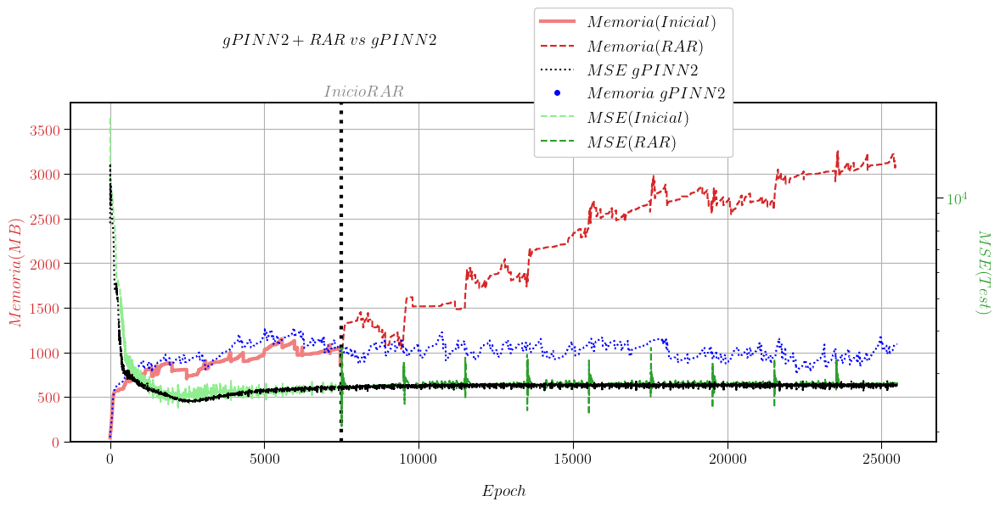

In [ ]:
memoria1 = memorias[:7500]
memoria2 = memorias[7500:]
mse1 = mse[:7500]
mse2 = mse[7500:]


fig, ax1 = plt.subplots(figsize=(8, 6))
plt.suptitle(r"$gPINN 2 + RAR \; vs \; gPINN2$", fontsize=14, y=0.95)

# Eje izquierdo: Memoria RAM.
color1_light = '#f08080'   
color1_dark = 'tab:red'   

ax1.set_xlabel("$Epoch$", labelpad=15)
ax1.set_ylabel("$Memoria (MB)$", color=color1_dark)
ax1.plot(range(len(memoria1)), memoria1, '-', linewidth = 3,color=color1_light, label="$Memoria (Inicial)$")
ax1.plot(range(len(memoria1), 25500), memoria2[:(25500-len(memoria1))], "--", color=color1_dark, label="$Memoria (RAR)$")
ax1.plot(range( 25500), memoria_por_epoca[:25500], ':', color='b', markersize = 0.8)
memoria_gpinn1_legend = Line2D([0], [0], marker='.', color='b', linestyle='None', 
                               markersize=8, label=r"$Memoria \; gPINN 2$")

ax1.tick_params(axis='y', labelcolor=color1_dark)
ax1.grid(True)

# Eje derecho: Métrico de Test (MSE).
color2_light = '#90ee90'   
color2_dark = 'tab:green' 

ax2 = ax1.twinx()
ax2.set_ylabel("$MSE (Test)$", color=color2_dark, rotation=-90, labelpad=20)
ax2.plot(range(len(mse1)), mse1, '--',color=color2_light, label="$MSE (Inicial)$")
ax2.plot(range(len(mse1), 25500), mse2[:(25500-len(memoria1))], '--', color=color2_dark, label="$MSE (RAR)$")
ax2.plot(range( 25500), metrictest[:25500], ':', color='k' ,label=r"$MSE \; gPINN 2$")
ax2.set_yscale("log")
ax1.set_ylim(0,3800)
ax2.tick_params(axis='y', labelcolor=color2_dark)

# Línea vertical para marcar inicio de RAR.
rar_start = len(memoria1)
ax1.axvline(x=rar_start, color='black', linestyle=':', linewidth=3)
ax1.text(rar_start-600, ax1.get_ylim()[1]*1.02, "$Inicio RAR$", rotation=0, color='gray')

lines1, labels1 = ax1.get_legend_handles_labels()
lines2, labels2 = ax2.get_legend_handles_labels()
idx_mse_gpinn1 = labels2.index(r"$MSE \; gPINN 2$")

lines_gpin1 = [lines2[idx_mse_gpinn1],memoria_gpinn1_legend]
labels_gpin1 = [r"$MSE \; gPINN 2$", r"$Memoria \; gPINN 2$"]

lines2_rest = lines2[:idx_mse_gpinn1] + lines2[idx_mse_gpinn1+1:]
labels2_rest = labels2[:idx_mse_gpinn1] + labels2[idx_mse_gpinn1+1:]

fig.legend(lines1 + lines_gpin1 + lines2_rest, 
           labels1 + labels_gpin1 + labels2_rest,
           loc="upper left",
           bbox_to_anchor=(0.8, 1),
           borderaxespad=0.,
           prop={'size': 14},
           frameon=True,
           facecolor='white',
           framealpha=1.0)

fig.tight_layout(rect=[0, 0, 1.5, 0.95])
plt.show()